In [4]:
# Fish Position Tracking
# Script by Dhruv Zocchi PhD, Janelia Research Campus
# Updated by Jeremy Delahanty, Hopkins Neuroscience Program Rotation Student Ahrens Lab

# cv2 is the backbone of this processing pipeline
# In short, there's a workflow that performs background subtraction,
# thresholding, blob detection, and distance calculation all through
# opencv and numpy. Numpy is the numerical computation/optimized python distro
import cv2
import numpy as np
import pandas as pd
# Matplotlib is the classic plotting library
import matplotlib.pyplot as plt
# We use the Rectangle Patch object for annotating our distance plots
from matplotlib.patches import Rectangle
from matplotlib.widgets import RectangleSelector

# Tkinter is a simple GUI library
from tkinter import Tk
from tkinter.filedialog import askdirectory

# Pathlib makes path manipulation a little nicer
from pathlib import Path

# tqdm gives you pretty progress bars
from tqdm.notebook import tqdm

# We use time for pausing thread execution, logging, and progress bars
import time

# This workflow relies heavily upon multithreading so work for processing
# and writing data. It doesn't have to, but it was fun to learn about
# Queues are how threads can "put" data in a spot that's ready to be
# taken up by another thread!
import threading
import queue

# Multiprocessing allows you to have multiple, easily accessed, independent
# non-blocking python processes to enable parallelism
from multiprocessing import Process, Queue

# h5py allows you to write to HDF5 files which are nice to use for organising
# multidimensional datasets with built in metadata/attributes
import h5py

# Currently, ROIs for a given set of experiments are stored as a config file
# stored as json
import json

# These are for debugging weird thread issues, not really in use now...
import warnings
import psutil
import traceback
import logging
import sys

from pathlib import Path
import pathlib
from typing import List

In [46]:
%matplotlib widget
%config InlineBackend.figure_format = 'retina'

In [5]:
def getHeatMapCts(posArr,binRangeX,binRangeY):
    xPos=posArr[:, 1]
    yPos=posArr[:, 0]
#count how many times position was within bin defined by binXIdx, binYIdx
    cts=posArr[(xPos>=binRangeX[0]) & (xPos<binRangeX[1]) & (yPos>=binRangeY[0]) & (yPos<binRangeY[1])].shape[0]
    return cts

#sweep along rows, starting from top row, count how many positions are in each bin
#heatMap is for figure, so has dim of original frame, heatMapData contains the counts
#in each heatmap bin, is used for the occupancy calc
def constructHeatMap(posArr,dim,numBinsX,numBinsY,numTimePts):
    # define bins, populate heatmap
    binsX = np.linspace(0, dim[0], numBinsX + 1)
    binsY = np.linspace(0, dim[1], numBinsY + 1)

    heatMap = np.zeros(dim)
    #heatMap = np.zeros([ int(roi[2]) , int(roi[3]) ])
    heatMapData = np.zeros([numBinsX, numBinsY])
    ctHist = []
    for i in range(0, numBinsX):
        for j in range(0, numBinsY):
            binRangeX = binsX[i:i+2]
            binRangeY = binsY[j:j+2]
            cts = getHeatMapCts(posArr, binRangeX, binRangeY)
            idxX = binRangeX.astype('int')
            idxY = binRangeY.astype('int')
            heatMap[idxX[0]:idxX[1], idxY[0]:idxY[1]] = cts
            heatMapData[i,j] = cts

    # normalize heatMap to show fraction time spent in each bin, apply blurring filter
    heatMap = heatMap / numTimePts
    heatMapData = heatMapData / numTimePts
    return heatMap, heatMapData, ctHist

def calculate_etoh_concentration():
    annotations = []
    # all measures in mL
    initial_chamber_volume = 2.5
    # approximate weight of 2% solution released per
    # solenoid opening
    # volume in mL * conversion factor * density
    mass_released_per_opening = 70
    # volume released per opening is approx 0.07mL
    volume_released_per_opening = 0.07
    # percentage of ethanol within a given volume
    volume_etoh_per_opening = 0.07 * 0.02
    # density at about room temp
    etoh_density = 0.789
    #mass etoh total is just volume
    ethanol_mass_per_opening = volume_etoh_per_opening * etoh_density
    total_ethanol_mass = 0
    current_volume = initial_chamber_volume
    counter = 0
    for i in range(1,6):
        counter += 1
        total_ethanol_mass += ethanol_mass_per_opening * counter
        current_volume += volume_released_per_opening
        annotations.append(round((total_ethanol_mass/current_volume)*100, 6))
        
    return annotations

In [6]:

def get_output_h5_files(data_directory: pathlib.Path) -> List[pathlib.Path]:
    """
    Find all output h5 files in the given data directory.

    Args:
    data_directory (pathlib.Path): The root directory to search for output files.

    Returns:
    List[pathlib.Path]: A list of paths to the output h5 files.
    """
    # Pattern to match: any file ending with '_output.h5'
    pattern = '*_output.h5'
    
    # Use glob to find all matching files recursively
    output_files = list(data_directory.rglob(pattern))
    
    # Sort the files to ensure consistent ordering
    output_files.sort()
    
    print(f"Found {len(output_files)} output h5 files.")
    
    return output_files


data_directory = pathlib.Path("~/OneDrive").expanduser().resolve()
output_files = get_output_h5_files(data_directory)

# Print the first few files (if any)
for file in output_files:
    print(file)



Found 26 output h5 files.
/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0001/20240718_sub-0001_OnePortEtohExperiment/20240718_sub-0001_OnePortEtohExperiment_output.h5
/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0002/20240718_sub-0002_OnePortEtohExperiment/20240718_sub-0002_OnePortEtohExperiment_output.h5
/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0003/20240718_sub-0003_OnePortEtohExperiment/20240718_sub-0003_OnePortEtohExperiment_output.h5
/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0004/20240718_sub-0004_OnePortEtohExperiment/20240718_sub-0004_OnePortEtohExperiment_output.h5
/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0005/20240719_sub-0005_OnePortEtohExperiment/20240719_sub-0005_OnePortEtohExperiment_output.h5
/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0006/20240719_sub-0006_OnePortEtohExperiment/20240719_sub-0006_OnePortEtohExperiment_output.h5
/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0007/20240719_sub-0007_OnePortEtohExperiment/20240719_sub-0007_OnePortEtohExperiment_output.h5
/

In [7]:
import h5py
import numpy as np
from pathlib import Path

def merge_corrected_data(original_file_path: Path, corrected_file_path: Path):
    """
    Take the corrected center dataset from the corrected file and add it to the original file
    as a new dataset named 'center_corrected'.

    Args:
    original_file_path (Path): Path to the original h5 file.
    corrected_file_path (Path): Path to the corrected h5 file.

    Returns:
    bool: True if successful, False otherwise.
    """
    try:
        # Open the corrected file and read the center dataset
        with h5py.File(corrected_file_path, 'r') as corrected_file:
            if 'center' not in corrected_file:
                print("Error: 'center' dataset not found in the corrected file.")
                return False
            corrected_center = corrected_file['center'][:]

        # Open the original file and add the corrected center dataset
        with h5py.File(original_file_path, 'r+') as original_file:
            if 'center_corrected' in original_file:
                del original_file['center_corrected']
            original_file.create_dataset('center_corrected', data=corrected_center)

        print(f"Successfully added 'center_corrected' dataset to {original_file_path}")
        return True

    except Exception as e:
        print(f"An error occurred: {str(e)}")
        return False

# Example usage
if __name__ == "__main__":

    data_directory = Path("~/OneDrive").expanduser().resolve()
    output_files = get_output_h5_files(data_directory)

    if output_files:
        # Assume the first file is the one we want to update
        original_file = output_files[7]
        corrected_file = original_file.with_name(f"{original_file.stem}_corrected.h5")

        if corrected_file.exists():
            success = merge_corrected_data(original_file, corrected_file)
            if success:
                print("Merge completed successfully.")
            else:
                print("Merge failed.")
        else:
            print(f"Corrected file not found: {corrected_file}")
    else:
        print("No output files found.")

Found 26 output h5 files.
Successfully added 'center_corrected' dataset to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0008/20240719_sub-0008_OnePortEtohExperiment/20240719_sub-0008_OnePortEtohExperiment_output.h5
Merge completed successfully.


Found 26 output h5 files.
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0001/20240718_sub-0001_OnePortEtohExperiment/20240718_sub-0001_OnePortEtohExperiment_output_path_plot.png


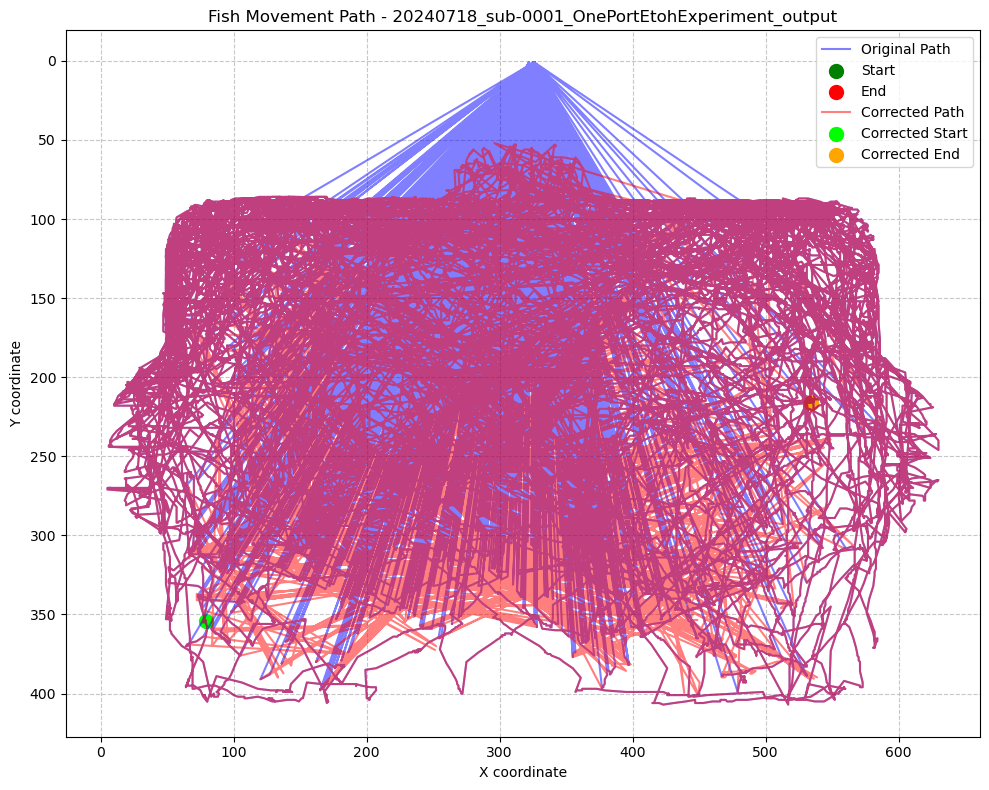

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0002/20240718_sub-0002_OnePortEtohExperiment/20240718_sub-0002_OnePortEtohExperiment_output_path_plot.png


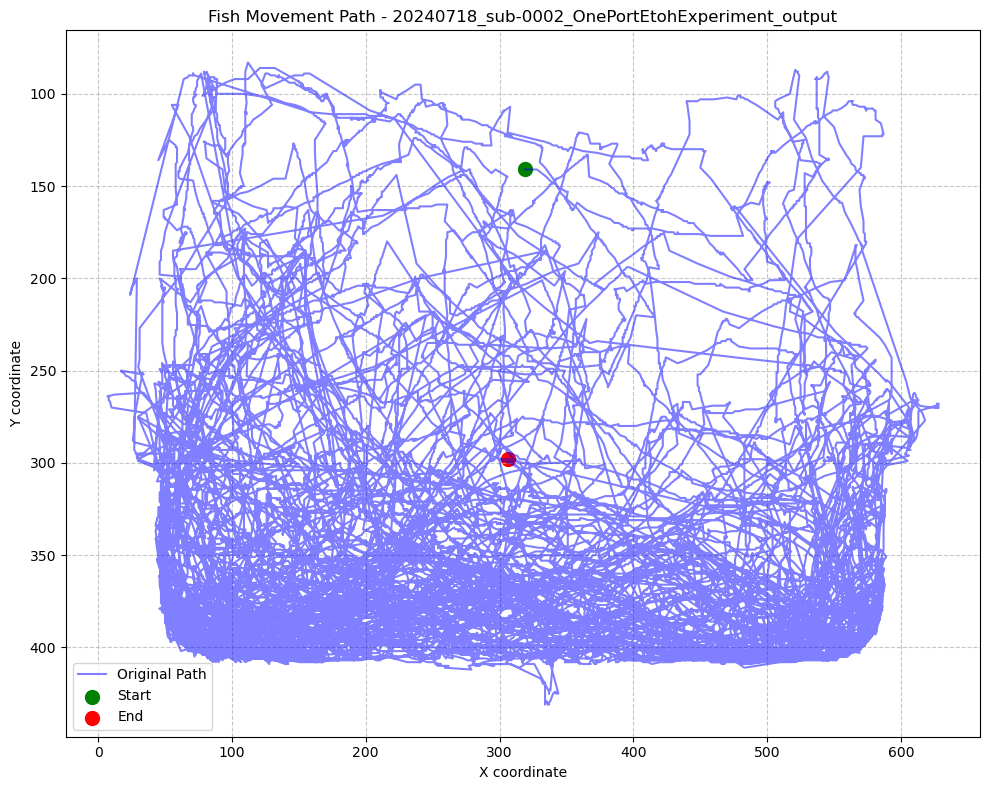

Failed to plot /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0003/20240718_sub-0003_OnePortEtohExperiment/20240718_sub-0003_OnePortEtohExperiment_output.h5: index 0 is out of bounds for axis 0 with size 0
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0004/20240718_sub-0004_OnePortEtohExperiment/20240718_sub-0004_OnePortEtohExperiment_output_path_plot.png


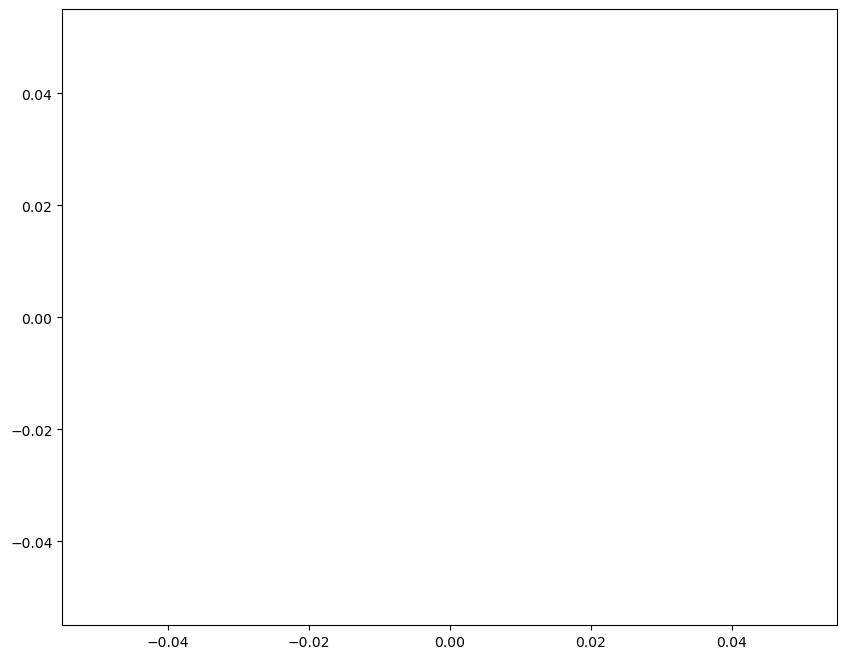

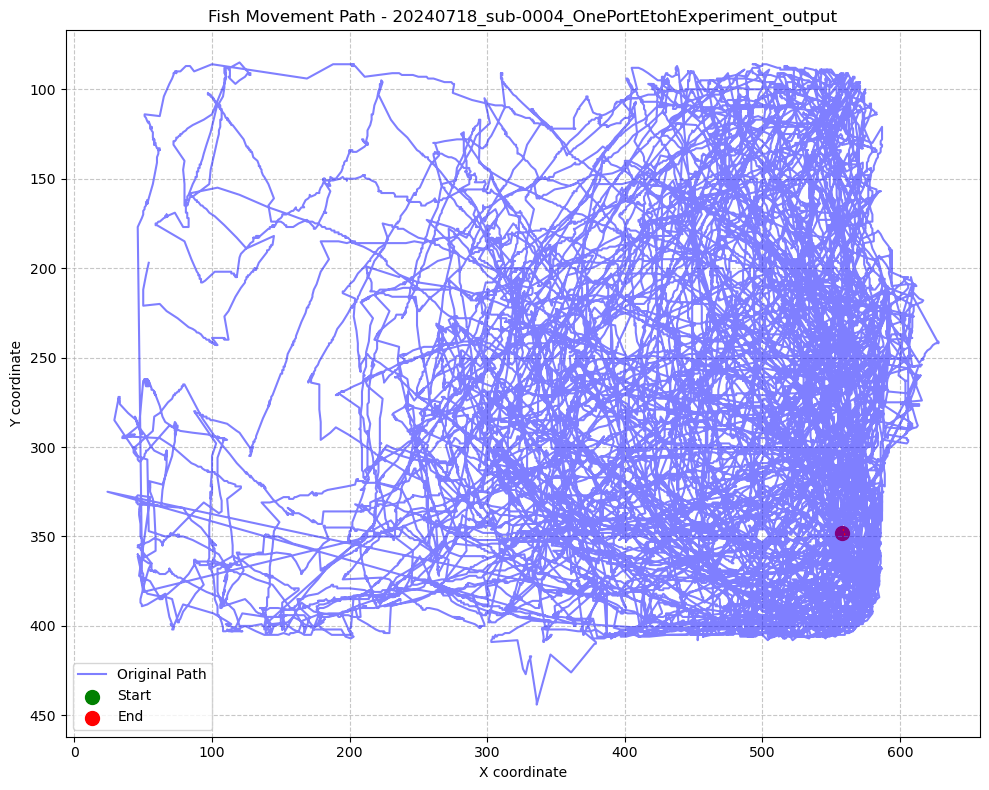

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0005/20240719_sub-0005_OnePortEtohExperiment/20240719_sub-0005_OnePortEtohExperiment_output_path_plot.png


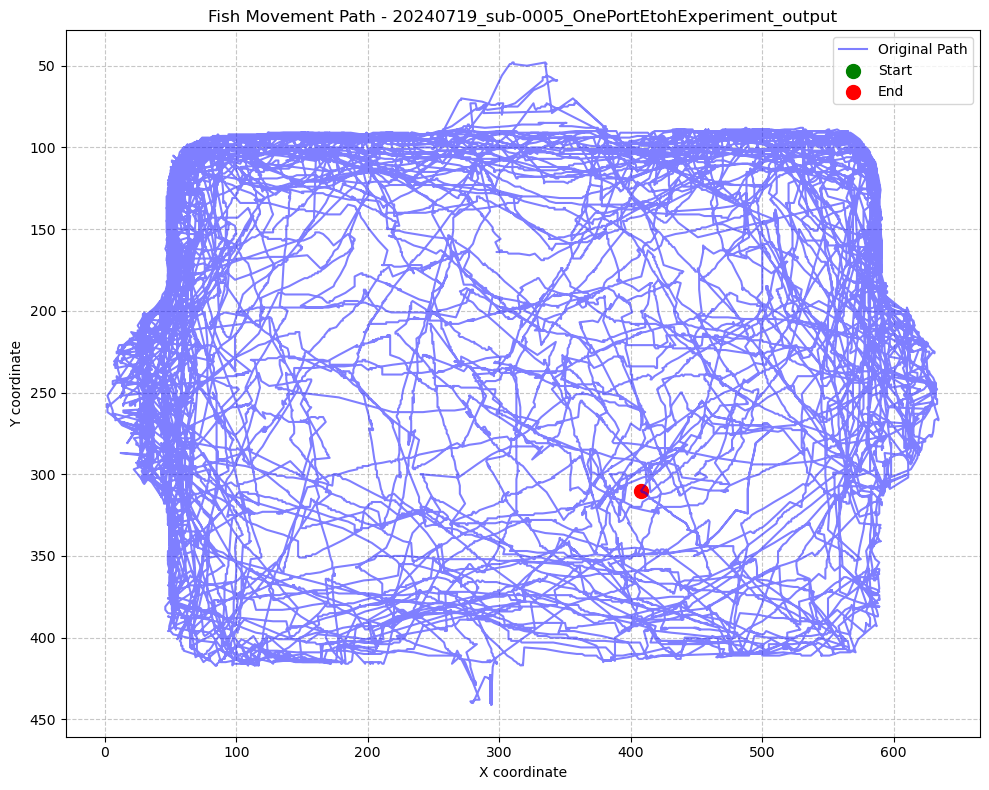

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0006/20240719_sub-0006_OnePortEtohExperiment/20240719_sub-0006_OnePortEtohExperiment_output_path_plot.png


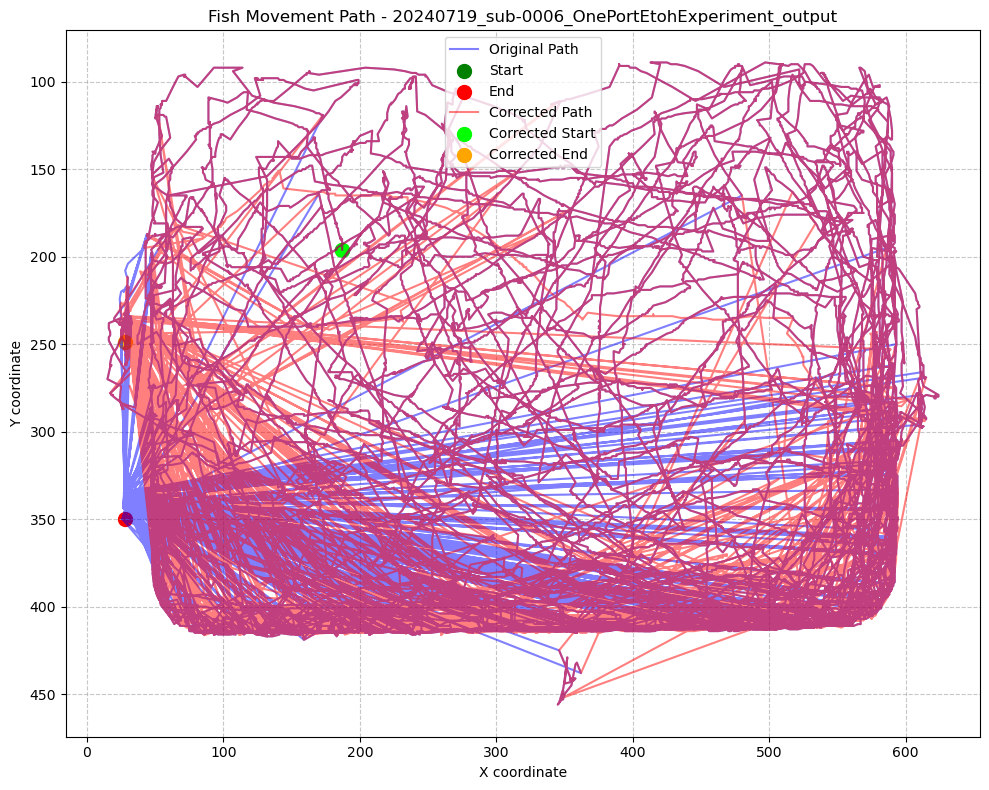

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0007/20240719_sub-0007_OnePortEtohExperiment/20240719_sub-0007_OnePortEtohExperiment_output_path_plot.png


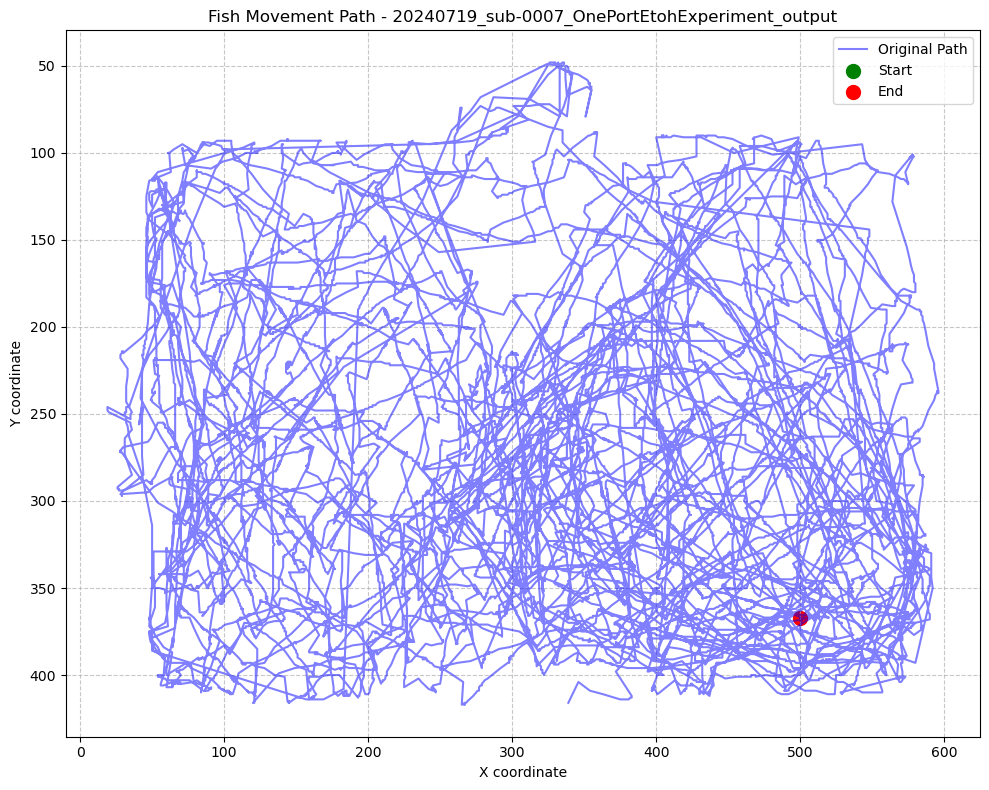

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0008/20240719_sub-0008_OnePortEtohExperiment/20240719_sub-0008_OnePortEtohExperiment_output_path_plot.png


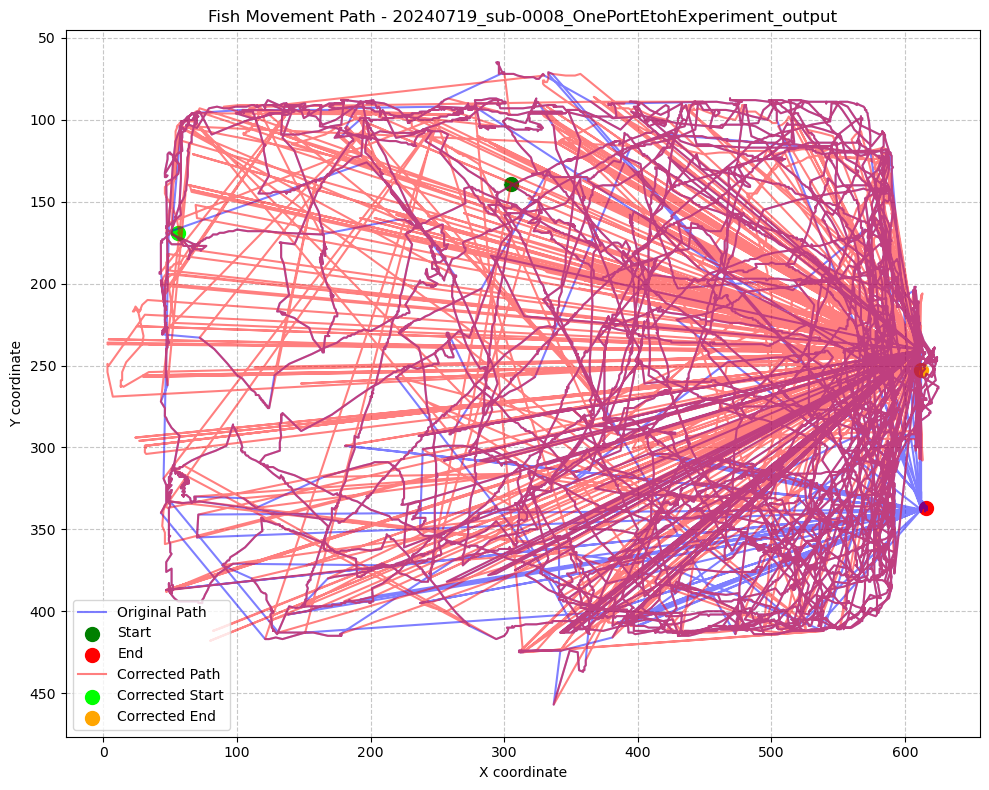

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0009/20240719_sub-0009_OnePortEtohExperiment/20240719_sub-0009_OnePortEtohExperiment_output_path_plot.png


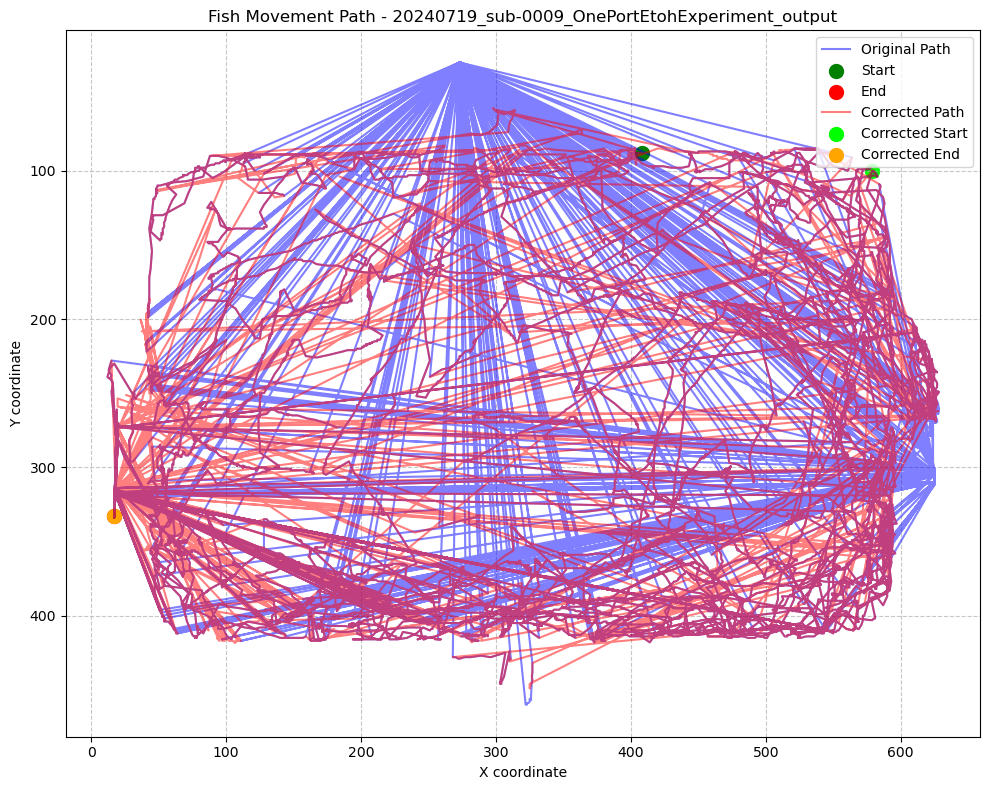

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0010/20240719_sub-0010_OnePortEtohExperiment/20240719_sub-0010_OnePortEtohExperiment_output_path_plot.png


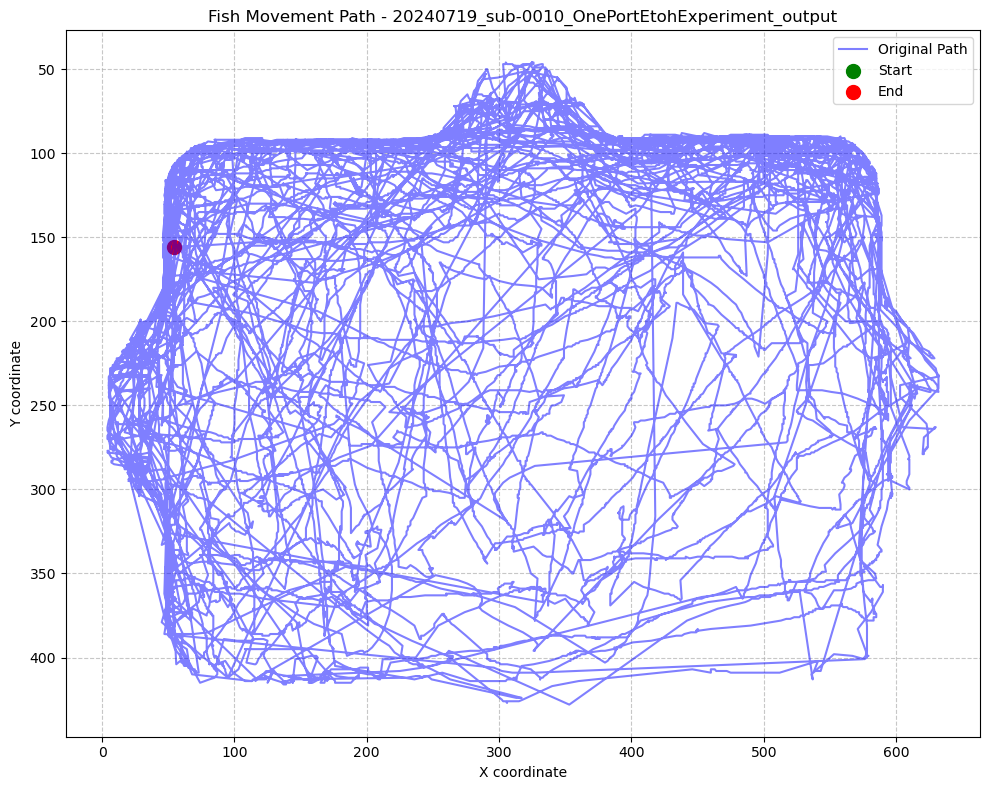

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0011/20240719_sub-0011_OnePortEtohExperiment/20240719_sub-0011_OnePortEtohExperiment_output_path_plot.png


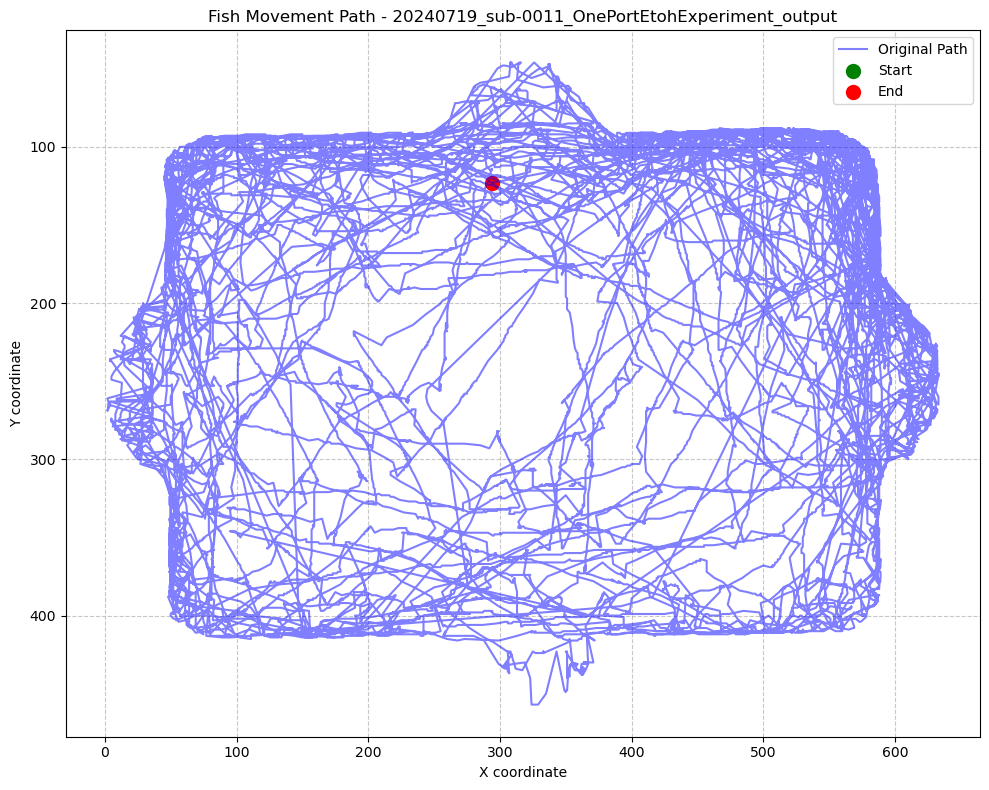

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0012/20240719_sub-0012_OnePortEtohExperiment/20240719_sub-0012_OnePortEtohExperiment_output_path_plot.png


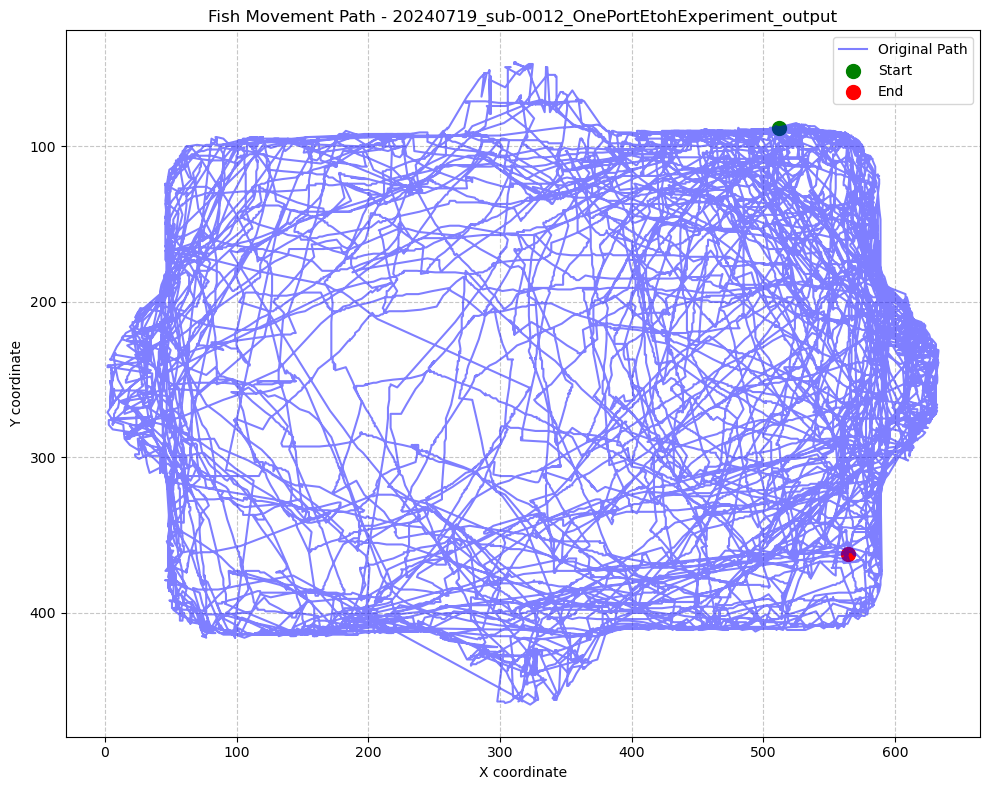

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0013/20240722_sub-0013_OnePortEtohExperiment/20240722_sub-0013_OnePortEtohExperiment_output_path_plot.png


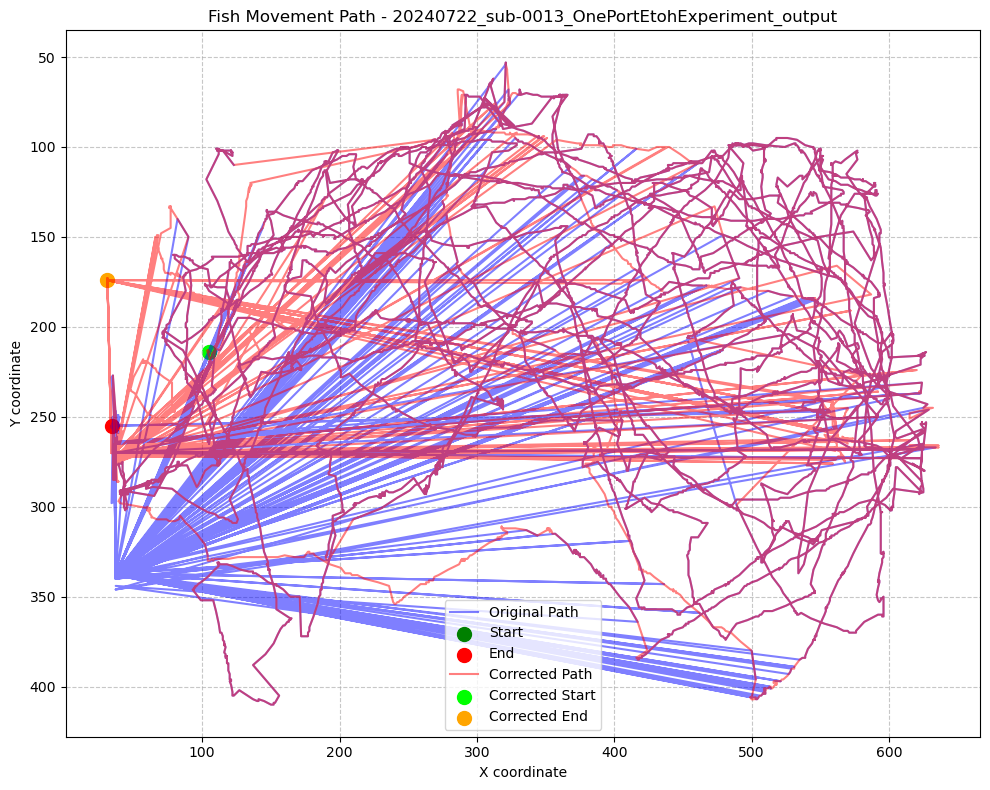

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0014/20240722_sub-0014_OnePortEtohExperiment/20240722_sub-0014_OnePortEtohExperiment_output_path_plot.png


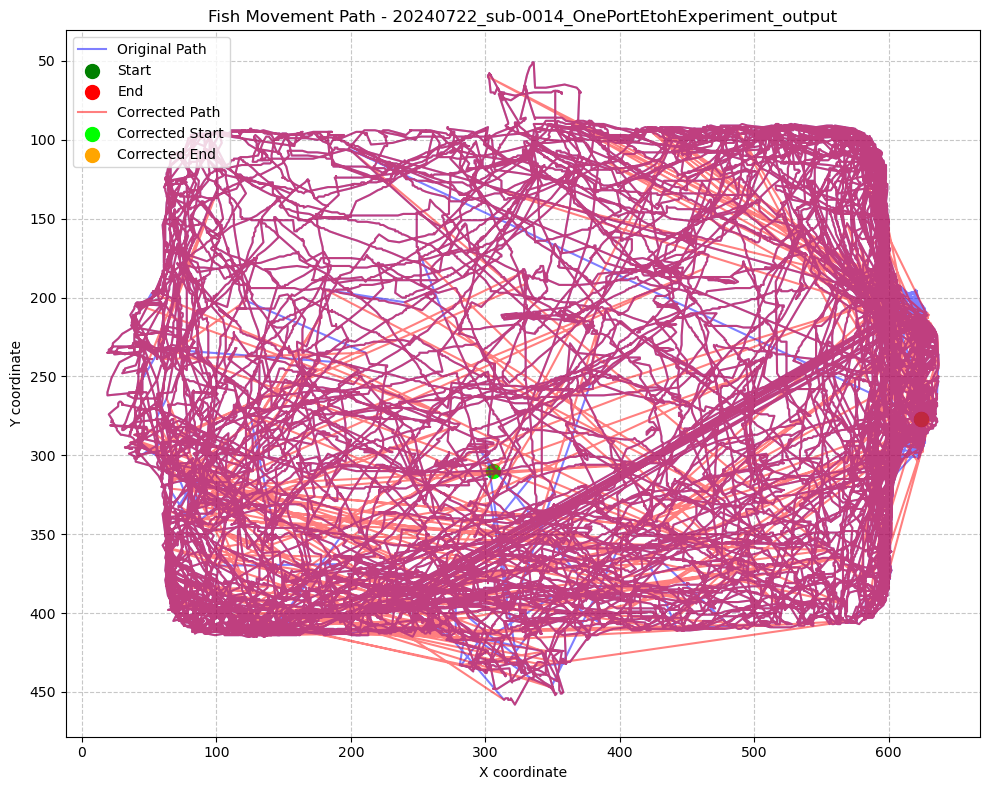

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0015/20240722_sub-0015_OnePortEtohExperiment/20240722_sub-0015_OnePortEtohExperiment_output_path_plot.png


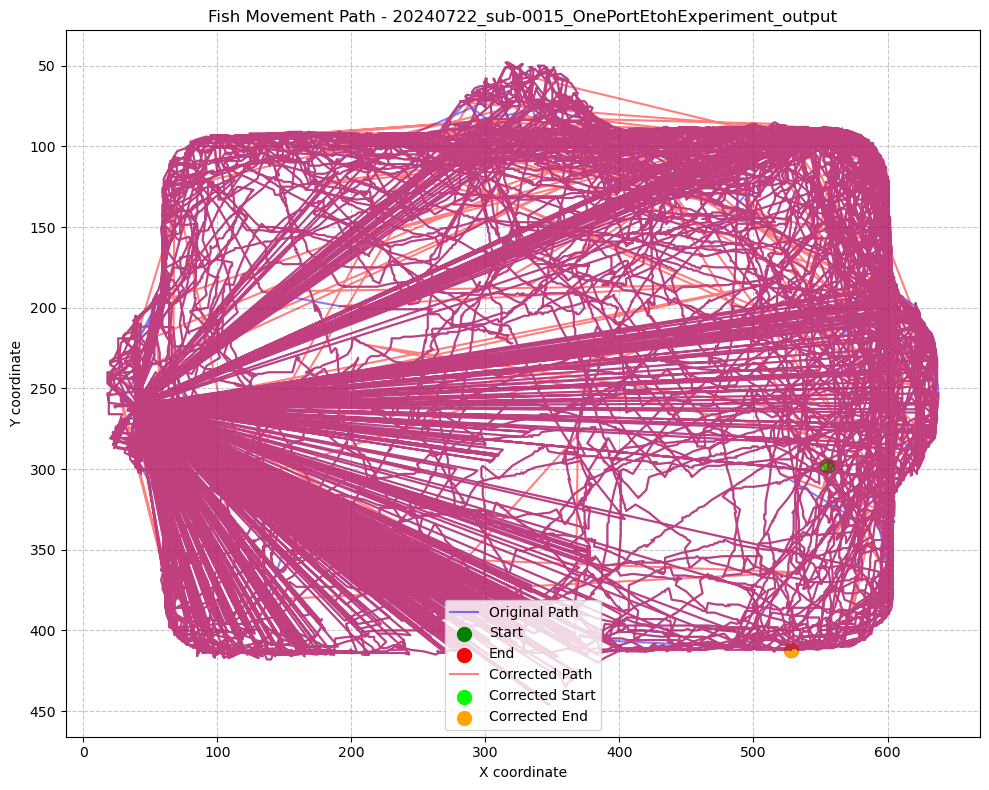

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0016/20240722_sub-0016_OnePortEtohExperiment/20240722_sub-0016_OnePortEtohExperiment_output_path_plot.png


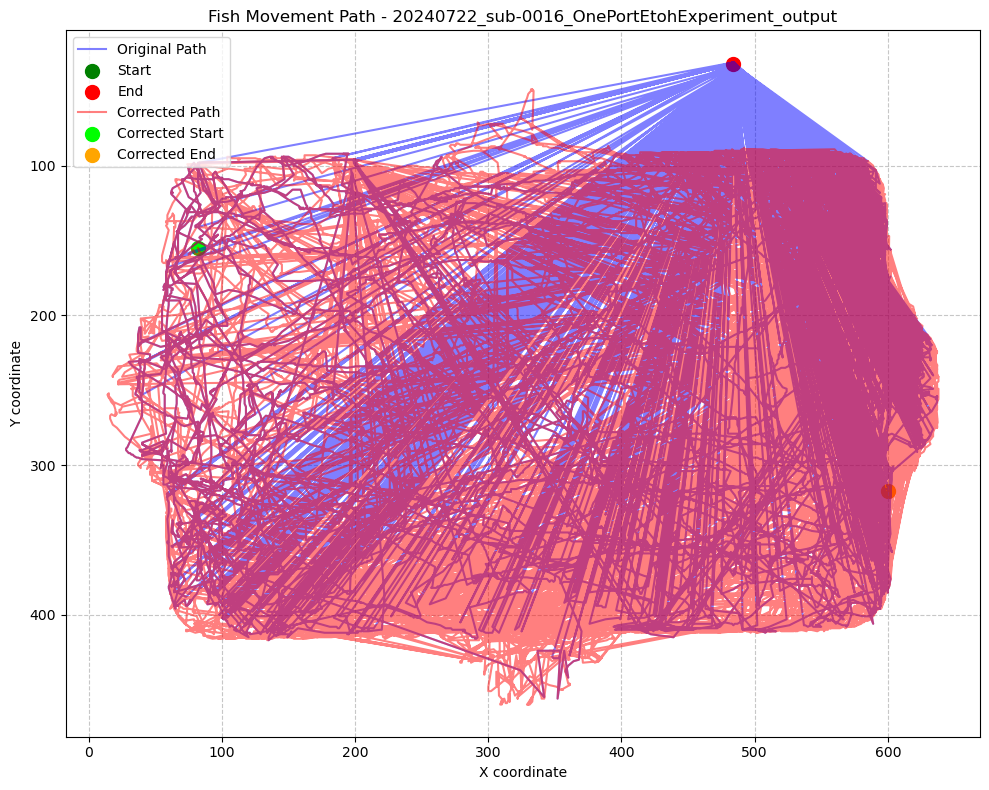

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0017/20240722_sub-0017_OnePortEtohExperiment/20240722_sub-0017_OnePortEtohExperiment_output_path_plot.png


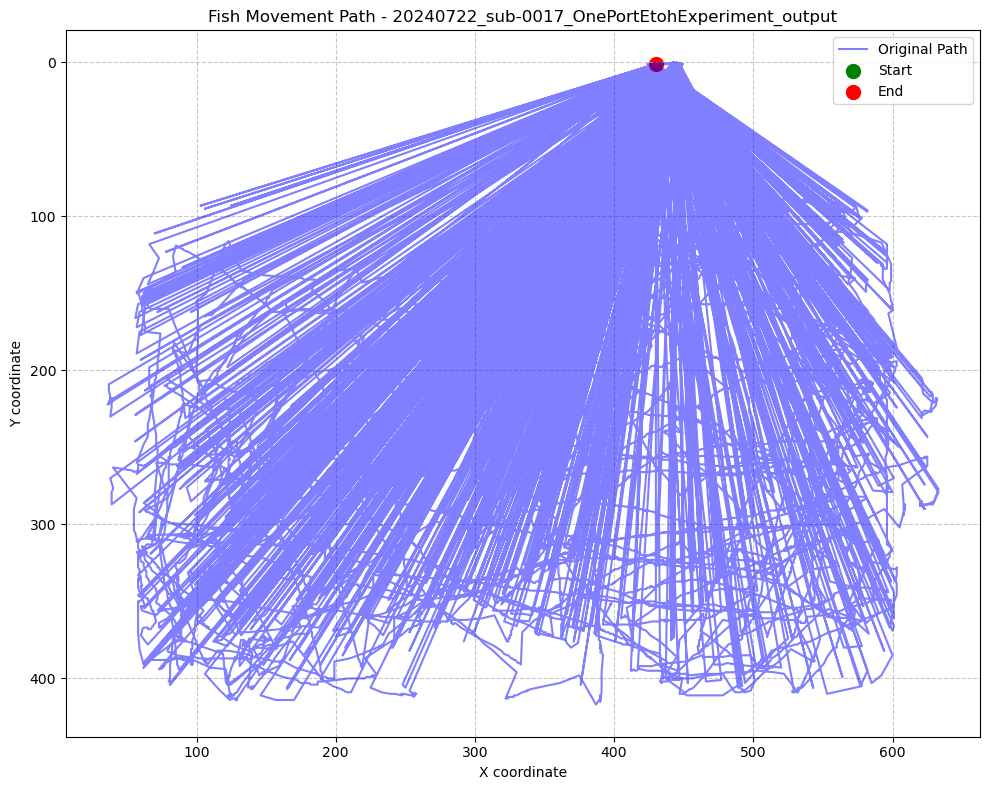

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0018/20240722_sub-0018_OnePortEtohExperiment/20240722_sub-0018_OnePortEtohExperiment_output_path_plot.png


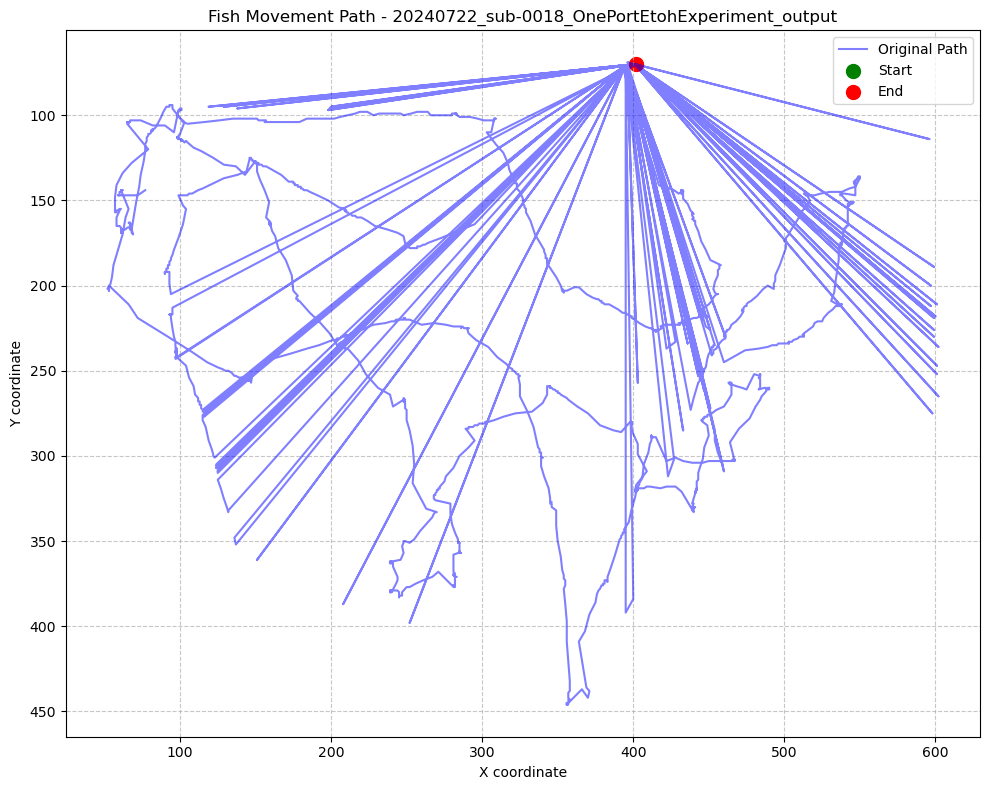

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0019/20240722_sub-0019_OnePortEtohExperiment/20240722_sub-0019_OnePortEtohExperiment_output_path_plot.png


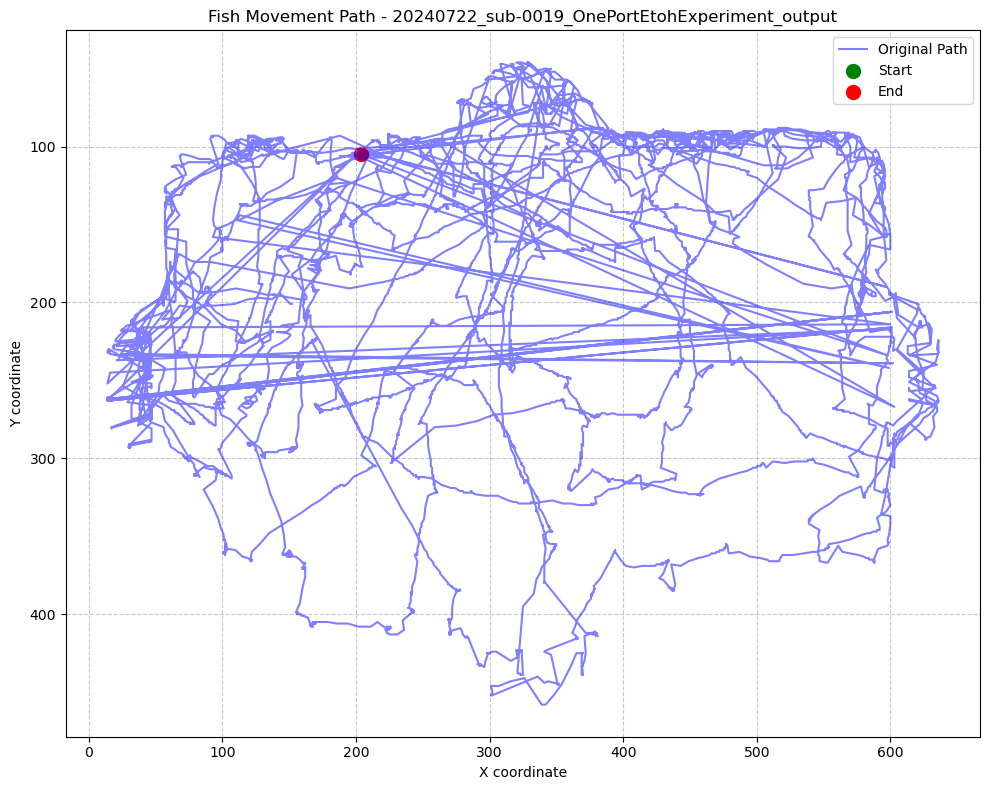

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0020/20240722_sub-0020_OnePortEtohExperiment/20240722_sub-0020_OnePortEtohExperiment_output_path_plot.png


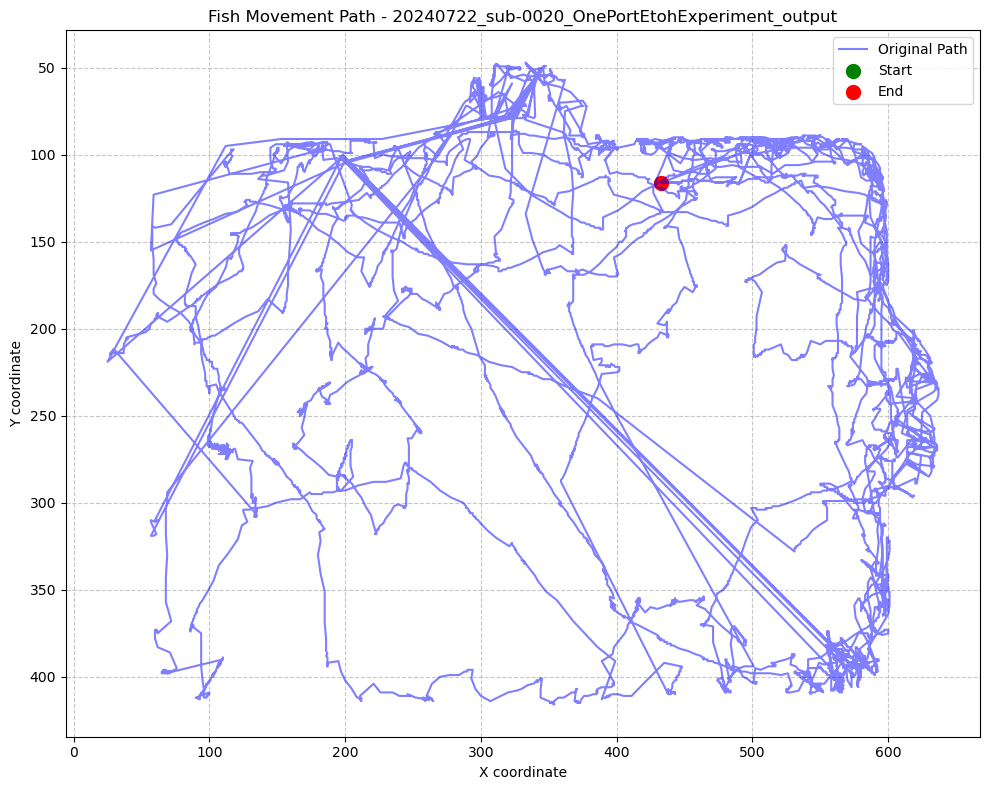

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0021/20240722_sub-0021_OnePortEtohExperiment/20240722_sub-0021_OnePortEtohExperiment_output_path_plot.png


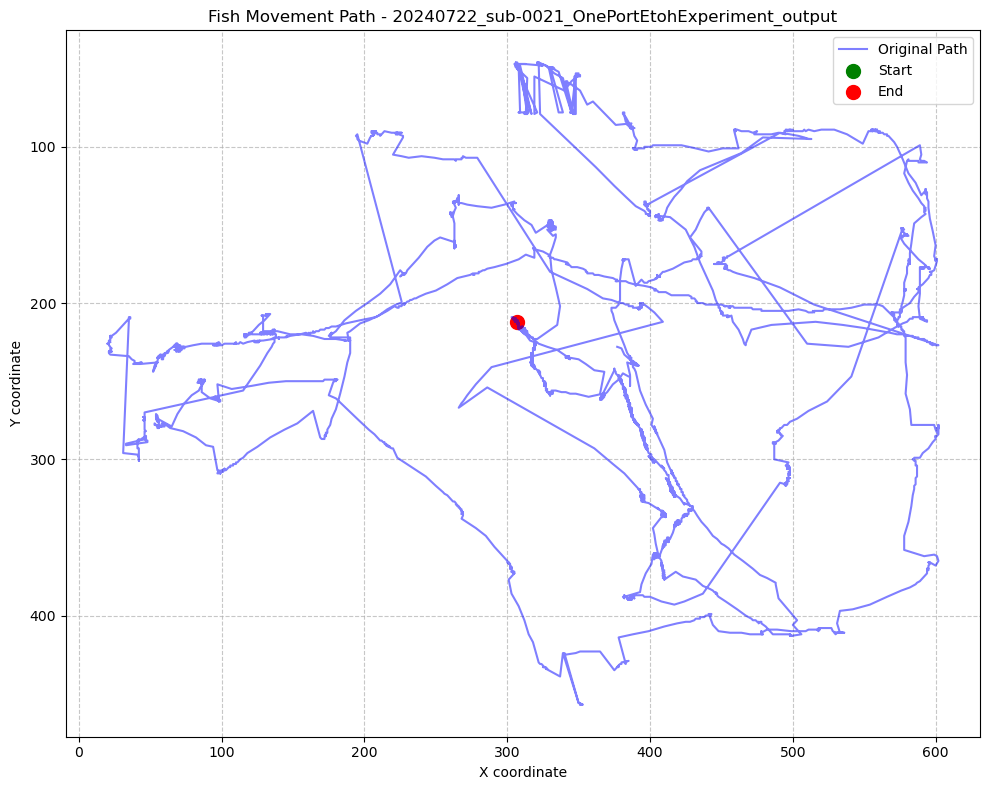

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0022/20240724_sub-0022_OnePortEtohExperiment/20240724_sub-0022_OnePortEtohExperiment_output_path_plot.png


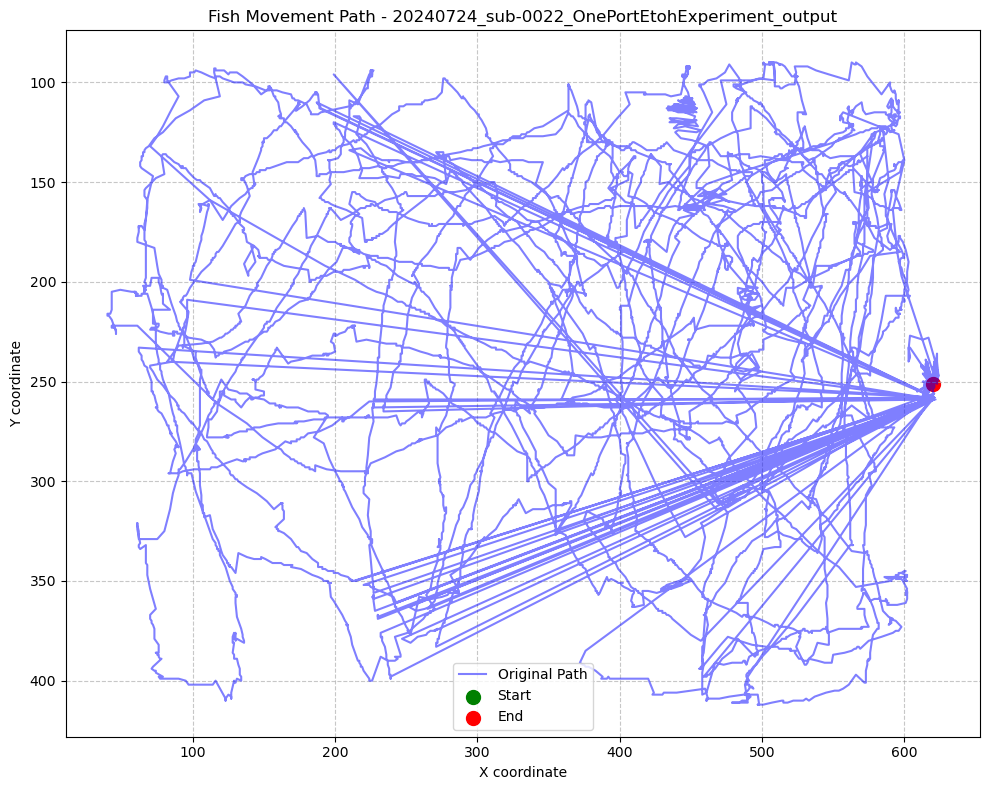

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0027/20240724_sub-0027_OnePortEtohExperiment/20240724_sub-0027_OnePortEtohExperiment_output_path_plot.png


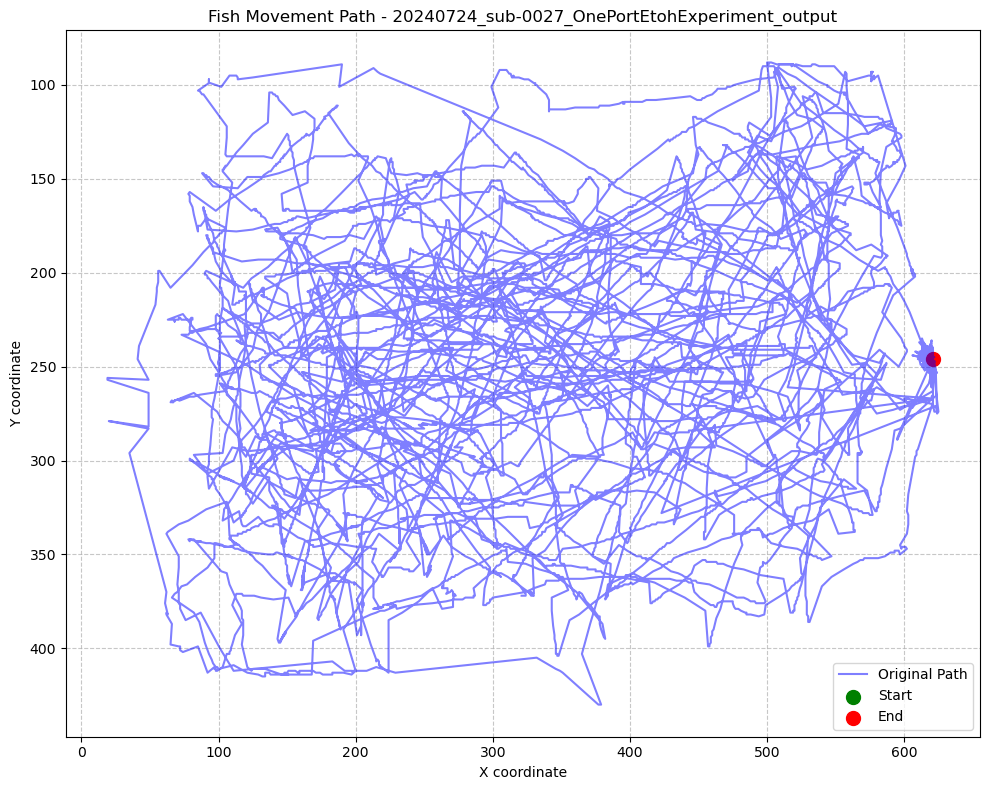

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0028/20240724_sub-0028_OnePortEtohExperiment/20240724_sub-0028_OnePortEtohExperiment_output_path_plot.png


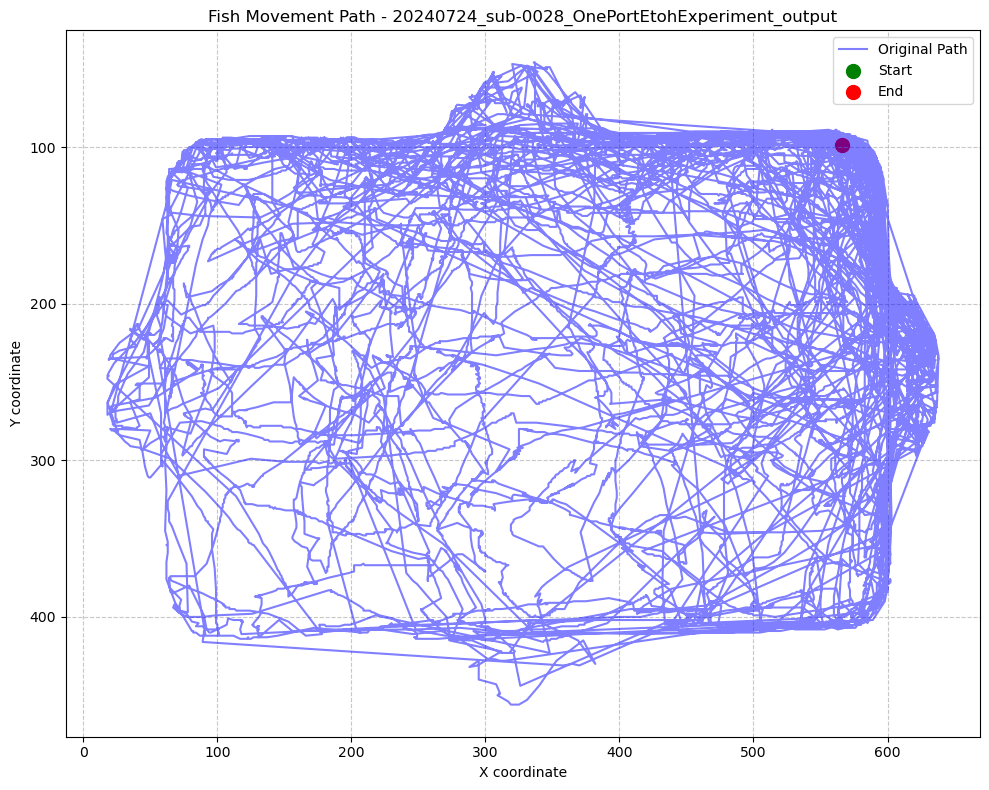

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0038/20240724_sub-0038_OnePortEtohExperiment/20240725_sub-0038_OnePortEtohExperiment_output_path_plot.png


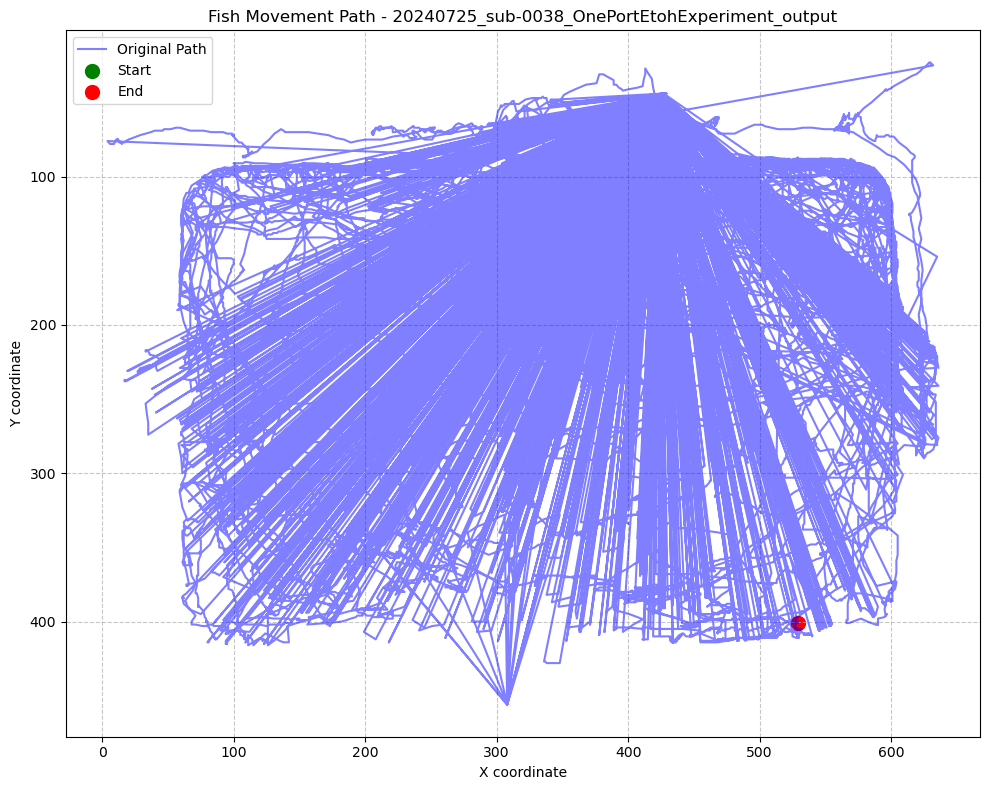

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0039/20240724_sub-0039_OnePortEtohExperiment/20240725_sub-0039_OnePortEtohExperiment_output_path_plot.png


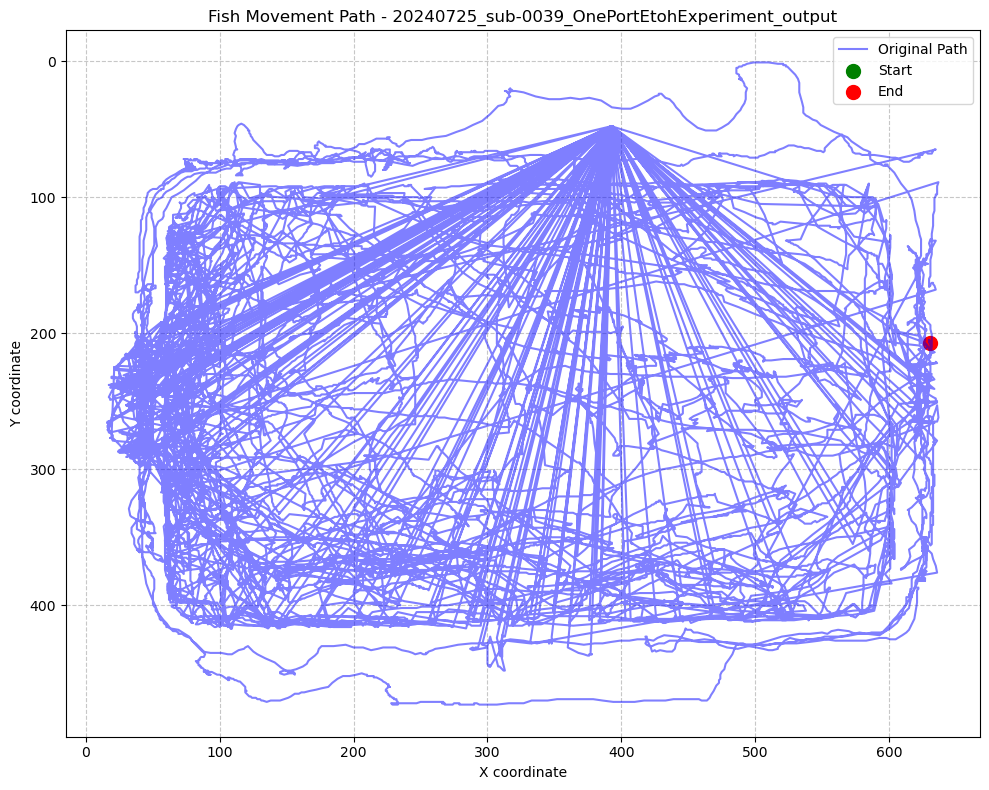

In [8]:
import h5py
import matplotlib.pyplot as plt
from pathlib import Path

def load_and_plot_fish_coordinates(file_path: Path):
    """
    Load fish coordinates from an h5 file and plot them, including corrected data if available.
    Args:
    file_path (Path): Path to the h5 file containing fish tracking data.
    """
    try:
        with h5py.File(file_path, 'r') as f:
            # Load the center coordinates
            center = f['center'][:]
            
            # Extract x and y coordinates
            x = center[:, 0]
            y = center[:, 1]
            
            # Create the plot
            fig, ax = plt.subplots(figsize=(10, 8))
            
            # Plot original data
            ax.plot(x, y, 'b-', alpha=0.5, label='Original Path')
            ax.scatter(x[0], y[0], color='green', s=100, label='Start')
            ax.scatter(x[-1], y[-1], color='red', s=100, label='End')
            
            # Check if corrected data exists
            corrected_file_path = file_path.with_name(f"{file_path.stem}_corrected.h5")
            if corrected_file_path.exists():
                with h5py.File(corrected_file_path, 'r') as f_corr:
                    center_corr = f_corr['center'][:]
                    x_corr = center_corr[:, 0]
                    y_corr = center_corr[:, 1]
                
                # Plot corrected data
                ax.plot(x_corr, y_corr, 'r-', alpha=0.5, label='Corrected Path')
                ax.scatter(x_corr[0], y_corr[0], color='lime', s=100, label='Corrected Start')
                ax.scatter(x_corr[-1], y_corr[-1], color='orange', s=100, label='Corrected End')
            
            ax.set_title(f'Fish Movement Path - {file_path.stem}')
            ax.set_xlabel('X coordinate')
            ax.set_ylabel('Y coordinate')
            ax.legend()
            
            # Invert y-axis to match image coordinates
            ax.invert_yaxis()
            
            ax.grid(True, linestyle='--', alpha=0.7)
            plt.tight_layout()
            
            # Save the plot
            output_path = file_path.with_name(f"{file_path.stem}_path_plot.png")
            plt.savefig(output_path)
            print(f"Plot saved to {output_path}")
            
            # Show the plot
            plt.show()
    except Exception as e:
        print(f"Failed to plot {file_path}: {str(e)}")

# Example usage
if __name__ == "__main__":
    data_directory = Path("~/OneDrive").expanduser().resolve()
    output_files = get_output_h5_files(data_directory)
    for file_path in output_files:
        load_and_plot_fish_coordinates(file_path)

Found 25 output h5 files.
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0039/20240724_sub-0039_OnePortEtohExperiment/20240725_sub-0039_OnePortEtohExperiment_output_path_plot.png


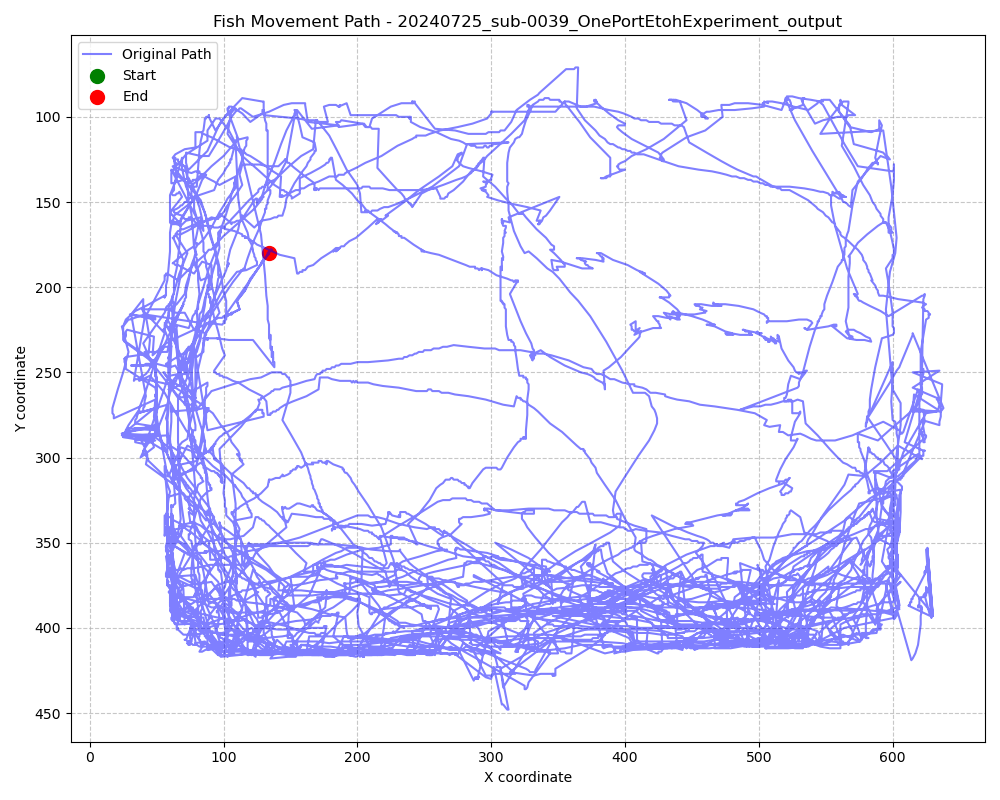

In [114]:
import h5py
import matplotlib.pyplot as plt
from pathlib import Path

def load_and_plot_fish_coordinates(file_path: Path):
    """
    Load fish coordinates from an h5 file and plot them, including corrected data if available.
    Args:
    file_path (Path): Path to the h5 file containing fish tracking data.
    """
    try:
        with h5py.File(file_path, 'r') as f:
            # Load the center coordinates
            center = f['center'][:]
            
            # Extract x and y coordinates
            x = center[:, 0]
            y = center[:, 1]
            
            # Create the plot
            fig, ax = plt.subplots(figsize=(10, 8))
            
            # Plot original data
            ax.plot(x, y, 'b-', alpha=0.5, label='Original Path')
            ax.scatter(x[0], y[0], color='green', s=100, label='Start')
            ax.scatter(x[-1], y[-1], color='red', s=100, label='End')
            
            # Check if corrected data exists
            corrected_file_path = file_path.with_name(f"{file_path.stem}_corrected.h5")
            if corrected_file_path.exists():
                with h5py.File(corrected_file_path, 'r') as f_corr:
                    center_corr = f_corr['center'][:]
                    x_corr = center_corr[:, 0]
                    y_corr = center_corr[:, 1]
                
                # Plot corrected data
                ax.plot(x_corr, y_corr, 'r-', alpha=0.5, label='Corrected Path')
                ax.scatter(x_corr[0], y_corr[0], color='lime', s=100, label='Corrected Start')
                ax.scatter(x_corr[-1], y_corr[-1], color='orange', s=100, label='Corrected End')
            
            ax.set_title(f'Fish Movement Path - {file_path.stem}')
            ax.set_xlabel('X coordinate')
            ax.set_ylabel('Y coordinate')
            ax.legend()
            
            # Invert y-axis to match image coordinates
            ax.invert_yaxis()
            
            ax.grid(True, linestyle='--', alpha=0.7)
            plt.tight_layout()
            
            # Save the plot
            output_path = file_path.with_name(f"{file_path.stem}_path_plot.png")
            plt.savefig(output_path)
            print(f"Plot saved to {output_path}")
            
            # Show the plot
            plt.show()
    except Exception as e:
        print(f"Failed to plot {file_path}: {str(e)}")

# Example usage
if __name__ == "__main__":
    data_directory = Path("~/OneDrive").expanduser().resolve()
    output_files = get_output_h5_files(data_directory)
    load_and_plot_fish_coordinates(output_files[-1])

In [135]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

def calculate_cumulative_distance(h5_file_path):
    """
    Calculate the cumulative distance traveled by the fish from the tracking data,
    handling NaN values.
    
    Args:
    h5_file_path (str or Path): Path to the H5 file containing the tracking data.
    
    Returns:
    tuple: Numpy arrays of frame numbers and cumulative distances, and some statistics.
    """
    with h5py.File(h5_file_path, 'r') as f:
        center = f['center'][:]
    
    # Remove NaN values
    valid_indices = ~np.isnan(center).any(axis=1)
    valid_center = center[valid_indices]
    
    if len(valid_center) < 2:
        raise ValueError("Not enough valid data points to calculate distances.")
    
    # Calculate distances between consecutive valid points
    distances = np.sqrt(np.sum(np.diff(valid_center, axis=0)**2, axis=1))
    
    # Calculate cumulative distances
    cumulative_distances = np.cumsum(distances)
    
    # Create an array of frame numbers for valid points (starting from 1)
    frames = np.arange(1, len(cumulative_distances) + 1)
    
    # Calculate some statistics
    total_frames = len(center)
    valid_frames = len(valid_center)
    nan_frames = total_frames - valid_frames
    
    stats = {
        'total_frames': total_frames,
        'valid_frames': valid_frames,
        'nan_frames': nan_frames,
        'nan_percentage': (nan_frames / total_frames) * 100
    }
    
    return frames, cumulative_distances, stats

def plot_cumulative_distance(frames, cumulative_distances, stats, output_path=None):
    """
    Plot the cumulative distance over time, including data statistics.
    
    Args:
    frames (numpy.array): Array of frame numbers.
    cumulative_distances (numpy.array): Array of cumulative distances.
    stats (dict): Dictionary containing data statistics.
    output_path (str or Path, optional): Path to save the plot. If None, the plot is displayed instead.
    """
    plt.figure(figsize=(12, 8))
    plt.plot(frames, cumulative_distances)
    plt.title('Cumulative Distance Traveled by Fish')
    plt.xlabel('Frame Number')
    plt.ylabel('Cumulative Distance (pixels)')
    plt.grid(True)
    
    # Add statistics to the plot
    stat_text = f"Total Frames: {stats['total_frames']}\n" \
                f"Valid Frames: {stats['valid_frames']}\n" \
                f"NaN Frames: {stats['nan_frames']}\n" \
                f"NaN Percentage: {stats['nan_percentage']:.2f}%"
    plt.text(0.02, 0.98, stat_text, transform=plt.gca().transAxes, 
             verticalalignment='top', bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
    
    if output_path:
        plt.savefig(output_path)
        plt.close()
    else:
        plt.show()

def process_output_file(output_file_path):
    """
    Process a single output file to calculate and plot cumulative distance.
    
    Args:
    output_file_path (str or Path): Path to the H5 output file.
    """
    try:
        frames, cumulative_distances, stats = calculate_cumulative_distance(output_file_path)
        
        # Generate plot filename
        plot_filename = output_file_path.with_name(f"{output_file_path.stem}_cumulative_distance.png")
        
        plot_cumulative_distance(frames, cumulative_distances, stats, plot_filename)
        
        print(f"Processed {output_file_path.name}")
        print(f"Cumulative distance plot saved as {plot_filename.name}")
        print(f"Statistics: {stats}")
    except Exception as e:
        print(f"Error processing {output_file_path.name}: {str(e)}")
    print(f"Cumulative distance plot saved as {plot_filename.name}")

process_output_file(output_files[-5])

Processed 20240722_sub-0021_OnePortEtohExperiment_output.h5
Cumulative distance plot saved as 20240722_sub-0021_OnePortEtohExperiment_output_cumulative_distance.png
Statistics: {'total_frames': 57601, 'valid_frames': 57355, 'nan_frames': 246, 'nan_percentage': 0.42707591882085383}
Cumulative distance plot saved as 20240722_sub-0021_OnePortEtohExperiment_output_cumulative_distance.png


In [159]:
def plot_distances_from_ports(h5_file_path, output_path=None):
    """
    Plot the distances from each port over frames.
    
    Args:
    h5_file_path (str or Path): Path to the H5 file containing the tracking data.
    output_path (str or Path, optional): Path to save the plot. If None, the plot is displayed instead.
    """
    with h5py.File(h5_file_path, 'r') as f:
        # Load data
        center = f['center'][:]
        
        # Get syringe contents from attributes
        left_syringe = f.attrs.get('left_syringe', 'Left')
        right_syringe = f.attrs.get('right_syringe', 'Right')
        
        # Load distance datasets
        dist_left = f[f'dist_{left_syringe}'][:]
        dist_right = f[f'dist_{right_syringe}'][:]
    
    # Create frame numbers
    frames = np.arange(1, len(center) + 1)
    
    # Create the plot
    fig, (ax1) = plt.subplots(1, 1, figsize=(12, 10), sharex=True)
    
    # Plot distances from ports
    ax1.plot(frames, dist_left, label=f'Distance from {left_syringe} port')
    ax1.plot(frames, dist_right, label=f'Distance from {right_syringe} port')
    ax1.set_ylabel('Distance (pixels)')
    ax1.set_title('Distance from Ports Over Time')
    ax1.legend()
    ax1.grid(True)
    
    if output_path:
        plt.savefig(output_path)
        plt.close()
    else:
        plt.show()

def calculate_cumulative_distance(h5_file_path):
    """
    Calculate the cumulative distance traveled by the fish from the tracking data,
    handling NaN values.
    
    Args:
    h5_file_path (str or Path): Path to the H5 file containing the tracking data.
    
    Returns:
    tuple: Numpy arrays of frame numbers and cumulative distances, and some statistics.
    """
    with h5py.File(h5_file_path, 'r') as f:
        center = f['center'][:]
    
    # Remove NaN values
    valid_indices = ~np.isnan(center).any(axis=1)
    valid_center = center[valid_indices]
    
    if len(valid_center) < 2:
        raise ValueError("Not enough valid data points to calculate distances.")
    
    # Calculate distances between consecutive valid points
    distances = np.sqrt(np.sum(np.diff(valid_center, axis=0)**2, axis=1))
    
    # Calculate cumulative distances
    cumulative_distances = np.cumsum(distances)
    
    # Create an array of frame numbers for valid points (starting from 1)
    frames = np.arange(1, len(cumulative_distances) + 1)
    
    # Calculate some statistics
    total_frames = len(center)
    valid_frames = len(valid_center)
    nan_frames = total_frames - valid_frames
    
    stats = {
        'total_frames': total_frames,
        'valid_frames': valid_frames,
        'nan_frames': nan_frames,
        'nan_percentage': (nan_frames / total_frames) * 100
    }
    
    return frames, cumulative_distances, stats

def plot_cumulative_distance(frames, cumulative_distances, stats, output_path=None):
    """
    Plot the cumulative distance over time, including data statistics.
    
    Args:
    frames (numpy.array): Array of frame numbers.
    cumulative_distances (numpy.array): Array of cumulative distances.
    stats (dict): Dictionary containing data statistics.
    output_path (str or Path, optional): Path to save the plot. If None, the plot is displayed instead.
    """
    plt.figure(figsize=(12, 8))
    plt.plot(frames, cumulative_distances)
    plt.title('Cumulative Distance Traveled by Fish')
    plt.xlabel('Frame Number')
    plt.ylabel('Cumulative Distance (pixels)')
    plt.grid(True)
    
    # Add statistics to the plot
    stat_text = f"Total Frames: {stats['total_frames']}\n" \
                f"Valid Frames: {stats['valid_frames']}\n" \
                f"NaN Frames: {stats['nan_frames']}\n" \
                f"NaN Percentage: {stats['nan_percentage']:.2f}%"
    plt.text(0.02, 0.98, stat_text, transform=plt.gca().transAxes, 
             verticalalignment='top', bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
    
    if output_path:
        plt.savefig(output_path)
        plt.close()
    else:
        plt.show()

def process_output_file(output_file_path):
    """
    Process a single output file to calculate and plot cumulative distance and distances from ports.
    
    Args:
    output_file_path (str or Path): Path to the H5 output file.
    """
    try:
        # Plot distances from ports
        port_plot_filename = output_file_path.with_name(f"{output_file_path.stem}_distances_from_ports.png")
        plot_distances_from_ports(output_file_path, port_plot_filename)
        print(f"Distances from ports plot saved as {port_plot_filename.name}")
        
        # Calculate and plot cumulative distance
        frames, cumulative_distances, stats = calculate_cumulative_distance(output_file_path)
        # cumulative_plot_filename = output_file_path.with_name(f"{output_file_path.stem}_cumulative_distance.png")
        # plot_cumulative_distance(frames, cumulative_distances, stats, cumulative_plot_filename)
        print(f"Cumulative distance plot saved as {cumulative_plot_filename.name}")
        print(f"Statistics: {stats}")
    except Exception as e:
        print(f"Error processing {output_file_path.name}: {str(e)}")

def main():
    data_directory = Path("~/OneDrive").expanduser().resolve()
    # output_files = list(data_directory.rglob("*_output.h5"))
    process_output_file(Path("/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0001/20240718_sub-0001_OnePortEtohExperiment/20240718_sub-0001_OnePortEtohExperiment_output_corrected_filtered.h5"))

if __name__ == "__main__":
    main()



Error processing 20240718_sub-0001_OnePortEtohExperiment_output_corrected_filtered.h5: "Unable to synchronously open object (object 'dist_Left' doesn't exist)"


In [130]:
output_files[-2]

PosixPath('/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0028/20240724_sub-0028_OnePortEtohExperiment/20240724_sub-0028_OnePortEtohExperiment_output.h5')

In [27]:
def apply_distance_threshold(file_path: Path, threshold: float) -> np.ndarray:
    """
    Load fish coordinates from a corrected h5 file, check the distance between
    consecutive points, and replace values with NaN if the distance exceeds the threshold.

    Args:
    file_path (Path): Path to the corrected h5 file containing fish tracking data.
    threshold (float): Maximum allowed distance between consecutive points.

    Returns:
    np.ndarray: Array of coordinates with values replaced by NaN where the distance
                between consecutive points exceeds the threshold.
    """
    # Load data from the h5 file
    with h5py.File(file_path, 'r') as f:
        coordinates = f['center'][:]

    # Calculate distances between consecutive points
    distances = np.sqrt(np.sum(np.diff(coordinates, axis=0)**2, axis=1))
    
    # Create a mask for points that exceed the threshold
    mask = np.concatenate(([False], distances > threshold))
    
    # Create a copy of the coordinates and apply the mask
    filtered_coordinates = coordinates.copy()
    filtered_coordinates[mask] = np.nan

    return filtered_coordinates

def save_filtered_data(file_path: Path, filtered_data: np.ndarray):
    """
    Save the filtered data to a new h5 file.

    Args:
    file_path (Path): Path to the original h5 file.
    filtered_data (np.ndarray): Filtered coordinate data to be saved.
    """
    output_file = file_path.with_name(f"{file_path.stem}_filtered.h5")
    with h5py.File(output_file, 'w') as f:
        f.create_dataset('center', data=filtered_data)
    print(f"Filtered data saved to {output_file}")

# Example usage
if __name__ == "__main__":
    file_path = Path("/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0001/20240718_sub-0001_OnePortEtohExperiment/20240718_sub-0001_OnePortEtohExperiment_output_corrected.h5")
    threshold = 30.0  # Adjust this value based on your needs
    
    filtered_data = apply_distance_threshold(file_path, threshold)
    save_filtered_data(file_path, filtered_data)

Filtered data saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0001/20240718_sub-0001_OnePortEtohExperiment/20240718_sub-0001_OnePortEtohExperiment_output_corrected_filtered.h5


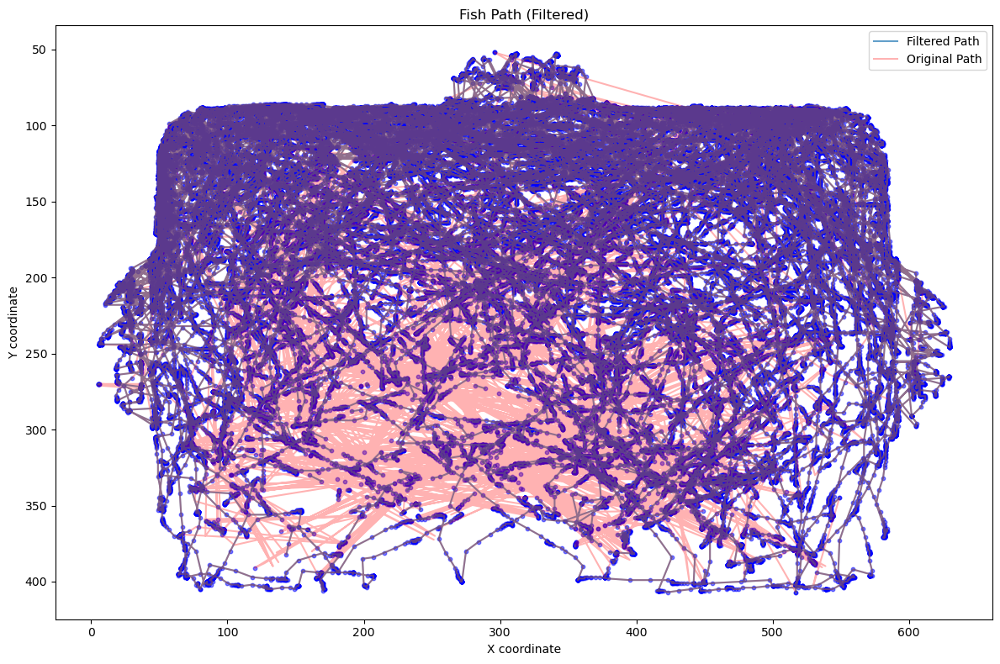

In [28]:
def plot_filtered_path(file_path: Path, original_file_path: Path = None):
    """
    Load filtered fish coordinates from an h5 file and plot the path.
    Optionally, plot the original path for comparison.

    Args:
    file_path (Path): Path to the filtered h5 file containing fish tracking data.
    original_file_path (Path, optional): Path to the original h5 file for comparison.
    """
    # Load filtered data
    with h5py.File(file_path, 'r') as f:
        filtered_coordinates = f['center'][:]

    # Create the plot
    fig, ax = plt.subplots(figsize=(12, 8))

    # Plot filtered data
    ax.plot(filtered_coordinates[:, 0], filtered_coordinates[:, 1], 
            label='Filtered Path', alpha=0.7)
    ax.scatter(filtered_coordinates[:, 0], filtered_coordinates[:, 1], 
               s=10, alpha=0.5, c='blue')

    # If original file is provided, plot it for comparison
    if original_file_path:
        with h5py.File(original_file_path, 'r') as f:
            original_coordinates = f['center'][:]
        
        ax.plot(original_coordinates[:, 0], original_coordinates[:, 1], 
                label='Original Path', alpha=0.3, color='red')

    ax.set_title('Fish Path (Filtered)')
    ax.set_xlabel('X coordinate')
    ax.set_ylabel('Y coordinate')
    ax.legend()
    ax.invert_yaxis()  # Invert y-axis to match image coordinates

    plt.tight_layout()
    plt.show()

# Example usage
if __name__ == "__main__":
    filtered_file_path = Path("/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0001/20240718_sub-0001_OnePortEtohExperiment/20240718_sub-0001_OnePortEtohExperiment_output_corrected_filtered.h5")
    original_file_path = Path("/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0001/20240718_sub-0001_OnePortEtohExperiment/20240718_sub-0001_OnePortEtohExperiment_output_corrected.h5")  # Optional
    
    plot_filtered_path(filtered_file_path, original_file_path)

In [82]:
from scipy import interpolate
def interpolate_nan_values(file_path: Path, method: str = 'linear') -> np.ndarray:
    """
    Load fish coordinates from an h5 file, identify NaN values,
    and interpolate them based on the last known distances.

    Args:
    file_path (Path): Path to the h5 file containing fish tracking data with NaNs.
    method (str): Interpolation method ('linear', 'nearest', 'zero', 'slinear', 'quadratic', 'cubic').
                  Default is 'linear'.

    Returns:
    np.ndarray: Array of coordinates with NaN values interpolated.
    """
    # Load data from the h5 file
    with h5py.File(file_path, 'r') as f:
        coordinates = f['center'][:]

    # Create a mask for NaN values
    nan_mask = np.isnan(coordinates[:, 0]) | np.isnan(coordinates[:, 1])

    # Create an array of frame numbers
    frames = np.arange(len(coordinates))

    # Interpolate x and y coordinates separately
    for i in range(2):  # 0 for x, 1 for y
        # Get the non-NaN values
        valid_frames = frames[~nan_mask]
        valid_coords = coordinates[~nan_mask, i]

        # Create an interpolation function
        f = interpolate.interp1d(valid_frames, valid_coords, kind=method, 
                                 fill_value="extrapolate")

        # Apply the interpolation to all frames
        coordinates[:, i] = f(frames)

    return coordinates

def save_interpolated_data(file_path: Path, interpolated_data: np.ndarray):
    """
    Save the interpolated data to a new h5 file.

    Args:
    file_path (Path): Path to the original h5 file.
    interpolated_data (np.ndarray): Interpolated coordinate data to be saved.
    """
    output_file = file_path.with_name(f"{file_path.stem}_interpolated.h5")
    with h5py.File(output_file, 'w') as f:
        f.create_dataset('center', data=interpolated_data)
    print(f"Interpolated data saved to {output_file}")

# Example usage
if __name__ == "__main__":
    f = "/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0017/20240722_sub-0017_OnePortEtohExperiment/"
    file_path = Path(f)
    interpolated_data = interpolate_nan_values(file_path, method='linear')
    save_interpolated_data(file_path, interpolated_data)

Interpolated data saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0016/20240722_sub-0016_OnePortEtohExperiment/20240722_sub-0016_OnePortEtohExperiment_output_corrected_filtered_interpolated.h5


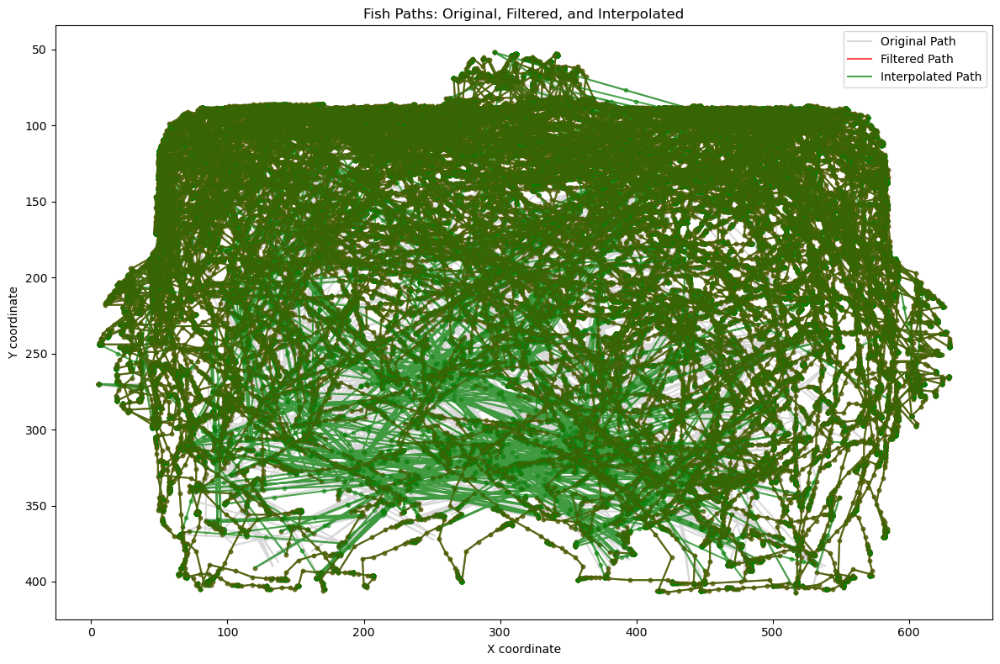

In [30]:
def plot_fish_paths(original_file_path: Path, filtered_file_path: Path, interpolated_file_path: Path):
    """
    Load fish coordinates from original, filtered, and interpolated h5 files and plot the paths.

    Args:
    original_file_path (Path): Path to the original h5 file containing fish tracking data.
    filtered_file_path (Path): Path to the filtered h5 file containing fish tracking data.
    interpolated_file_path (Path): Path to the interpolated h5 file containing fish tracking data.
    """
    # Load data
    with h5py.File(original_file_path, 'r') as f:
        original_coordinates = f['center'][:]
    
    with h5py.File(filtered_file_path, 'r') as f:
        filtered_coordinates = f['center'][:]
    
    with h5py.File(interpolated_file_path, 'r') as f:
        interpolated_coordinates = f['center'][:]

    # Create the plot
    fig, ax = plt.subplots(figsize=(12, 8))

    # Plot original data
    ax.plot(original_coordinates[:, 0], original_coordinates[:, 1], 
            label='Original Path', alpha=0.3, color='gray')

    # Plot filtered data
    ax.plot(filtered_coordinates[:, 0], filtered_coordinates[:, 1], 
            label='Filtered Path', alpha=0.7, color='red')
    ax.scatter(filtered_coordinates[:, 0], filtered_coordinates[:, 1], 
               s=10, alpha=0.5, color='red')

    # Plot interpolated data
    ax.plot(interpolated_coordinates[:, 0], interpolated_coordinates[:, 1], 
            label='Interpolated Path', alpha=0.7, color='green')
    ax.scatter(interpolated_coordinates[:, 0], interpolated_coordinates[:, 1], 
               s=10, alpha=0.5, color='green')

    ax.set_title('Fish Paths: Original, Filtered, and Interpolated')
    ax.set_xlabel('X coordinate')
    ax.set_ylabel('Y coordinate')
    ax.legend()
    ax.invert_yaxis()  # Invert y-axis to match image coordinates

    plt.tight_layout()
    plt.show()

# Example usage
if __name__ == "__main__":
    original_file_path = Path(original_file_path)
    filtered_file_path = Path(filtered_file_path)
    interpolated_file_path = Path("/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0001/20240718_sub-0001_OnePortEtohExperiment/20240718_sub-0001_OnePortEtohExperiment_output_corrected_filtered_interpolated.h5")
    
    plot_fish_paths(original_file_path, filtered_file_path, interpolated_file_path)

Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0017/20240722_sub-0017_OnePortEtohExperiment/20240722_sub-0017_OnePortEtohExperiment_output_cumulative_distance_plot.png


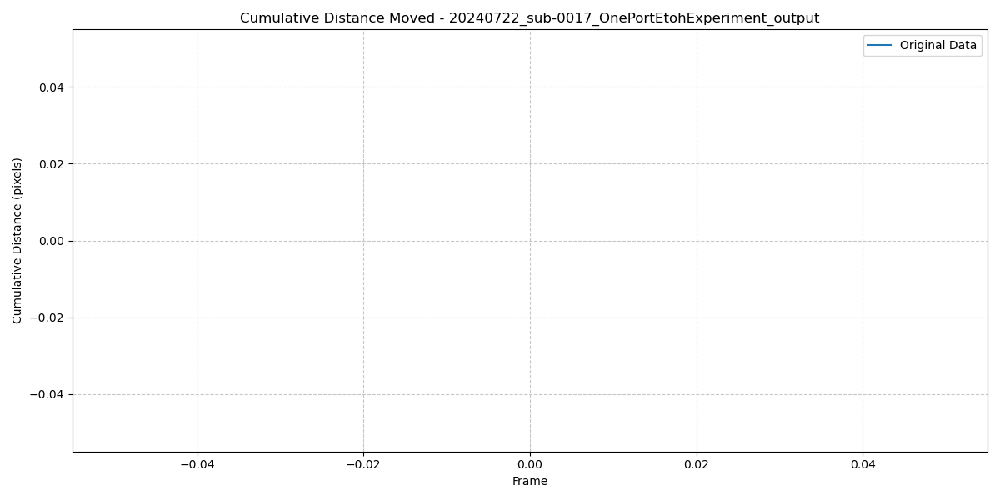

Original Data:
Total distance moved: nan pixels
Average distance per frame: nan pixels
Std dev distance per frame: nan pixels


In [102]:
def plot_cumulative_distance(file_path: Path):
    """
    Load fish coordinates from an h5 file, calculate cumulative Euclidean distance,
    and plot it over frames for both original and corrected data (if available).
    Args:
    file_path (Path): Path to the h5 file containing fish tracking data.
    """
    try:
        # Load original data
        with h5py.File(file_path, 'r') as f:
            center = f['center'][:]
        
        # Calculate distances and cumulative distance for original data
        distances = np.sqrt(np.sum(np.diff(center, axis=0)**2, axis=1))
        cumulative_distance = np.cumsum(distances)
        
        # Create the plot
        fig, ax = plt.subplots(figsize=(12, 6))
        
        # Plot original data
        ax.plot(range(1, len(cumulative_distance) + 1), cumulative_distance, label='Original Data')
        
        # Check if corrected data exists
        corrected_file_path = file_path.with_name(f"{file_path.stem}_corrected.h5")
        if corrected_file_path.exists():
            with h5py.File(corrected_file_path, 'r') as f_corr:
                center_corr = f_corr['center'][:]
            
            # Calculate distances and cumulative distance for corrected data
            distances_corr = np.sqrt(np.sum(np.diff(center_corr, axis=0)**2, axis=1))
            cumulative_distance_corr = np.cumsum(distances_corr)
            
            # Plot corrected data
            ax.plot(range(1, len(cumulative_distance_corr) + 1), cumulative_distance_corr, label='Corrected Data')
        
        ax.set_title(f'Cumulative Distance Moved - {file_path.stem}')
        ax.set_xlabel('Frame')
        ax.set_ylabel('Cumulative Distance (pixels)')
        ax.legend()
        
        ax.grid(True, linestyle='--', alpha=0.7)
        plt.tight_layout()
        
        # Save the plot
        output_path = file_path.with_name(f"{file_path.stem}_cumulative_distance_plot.png")
        plt.savefig(output_path)
        print(f"Plot saved to {output_path}")
        
        # Show the plot
        plt.show()
        
        # Print statistics
        print("Original Data:")
        print(f"Total distance moved: {cumulative_distance[-1]:.2f} pixels")
        print(f"Average distance per frame: {np.mean(distances):.2f} pixels")
        print(f"Std dev distance per frame: {np.std(distances):2f} pixels")
        
        if corrected_file_path.exists():
            print("\nCorrected Data:")
            print(f"Total distance moved: {cumulative_distance_corr[-1]:.2f} pixels")
            print(f"Average distance per frame: {np.mean(distances_corr):.2f} pixels")
        
    except Exception as e:
        print(f"Failed to analyze {file_path}: {str(e)}")

# Example usage
if __name__ == "__main__":
    data_directory = Path("~/OneDrive").expanduser().resolve()
    plot_cumulative_distance(output_files[16])
    # output_files = get_output_h5_files(data_directory)
    
    # for file_path in output_files:
    #     plot_cumulative_distance(file_path)

In [91]:
plt.close('all')

In [90]:
import numpy as np
import h5py
import matplotlib.pyplot as plt
from pathlib import Path

def plot_port_distances(original_file_path: Path, filtered_file_path: Path, interpolated_file_path: Path):
    """
    Load fish coordinates from h5 files and port locations from the original file,
    calculate distances to each port, and plot these distances for original, filtered,
    and interpolated data.

    Args:
    original_file_path (Path): Path to the original h5 file containing fish tracking data and port locations.
    filtered_file_path (Path): Path to the filtered h5 file containing fish tracking data.
    interpolated_file_path (Path): Path to the interpolated h5 file containing fish tracking data.
    """
    def load_data(file_path):
        with h5py.File(file_path, 'r') as f:
            coordinates = f['center'][:]
        return coordinates

    def load_port_locations(file_path):
        with h5py.File(file_path, 'r') as f:
            port_locations = {
                port: np.array(f.attrs[port])
                for port in ['Left', 'Right', 'Inlet', 'Outlet']
                if port in f.attrs
            }
        return port_locations

    def calculate_distances(coordinates, port_locations):
        distances = {}
        for port, location in port_locations.items():
            distances[port] = np.sqrt(np.sum((coordinates - location)**2, axis=1))
        return distances

    # Load port locations from the original file
    port_locations = load_port_locations(original_file_path)

    # Load coordinate data
    original_coords = load_data(original_file_path)
    filtered_coords = load_data(filtered_file_path)
    interpolated_coords = load_data(interpolated_file_path)

    # Calculate distances
    original_distances = calculate_distances(original_coords, port_locations)
    filtered_distances = calculate_distances(filtered_coords, port_locations)
    interpolated_distances = calculate_distances(interpolated_coords, port_locations)

    # Create the plot
    fig, axs = plt.subplots(len(port_locations), 1, figsize=(12, 4*len(port_locations)), sharex=True)
    # fig.suptitle('Distances from Ports: Original, Filtered, and Interpolated')

    for i, (port, ax) in enumerate(zip(port_locations.keys(), axs)):
        ax.plot(original_distances[port], label='Original', alpha=0.3, color='gray')
        ax.plot(filtered_distances[port], label='Filtered', alpha=0.7, color='red')
        ax.plot(interpolated_distances[port], label='Interpolated', alpha=0.7, color='blue')
        
        ax.set_ylabel(f'Distance from {port}')
        ax.legend()

        if i == len(port_locations) - 1:
            ax.set_xlabel('Frame')

    plt.tight_layout()
    plt.show()

# Example usage
if __name__ == "__main__":
    # original_file_path = Path("path/to/your/original_file.h5")
    # filtered_file_path = Path("path/to/your/filtered_file.h5")
    # interpolated_file_path = Path("path/to/your/interpolated_file.h5")
    
    plot_port_distances(o, f, i)

ValueError: Number of rows must be a positive integer, not 0

SystemError: tile cannot extend outside image

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous view', 'arrow-left', 'back'), ('Forward', 'Forward to next view', 'arrow-right', 'forward'), ('Pan', 'Left button pans, Right button zooms\nx/y fixes axis, CTRL fixes aspect', 'arrows', 'pan'), ('Zoom', 'Zoom to rectangle\nx/y fixes axis', 'square-o', 'zoom'), ('Download', 'Download plot', 'floppy-o', 'save_figure')]))

Found 26 output h5 files.
FAILED
Analysis completed.
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0002/20240718_sub-0002_OnePortEtohExperiment/20240718_sub-0002_OnePortEtohExperiment_output_chamber_analysis.png


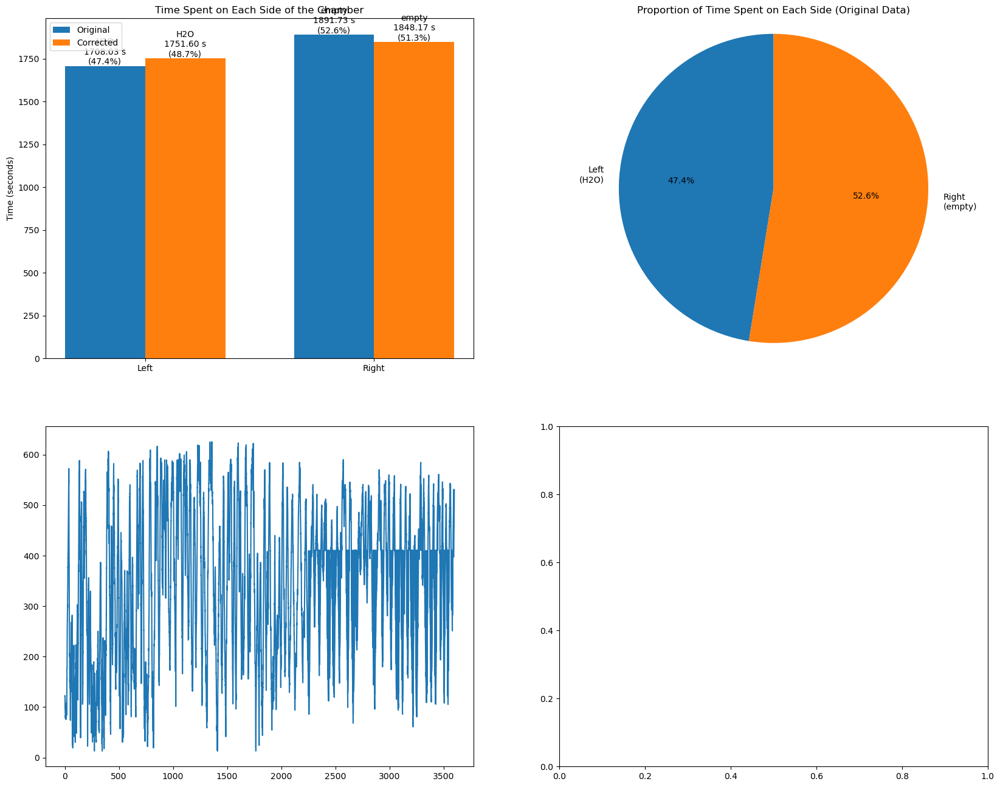

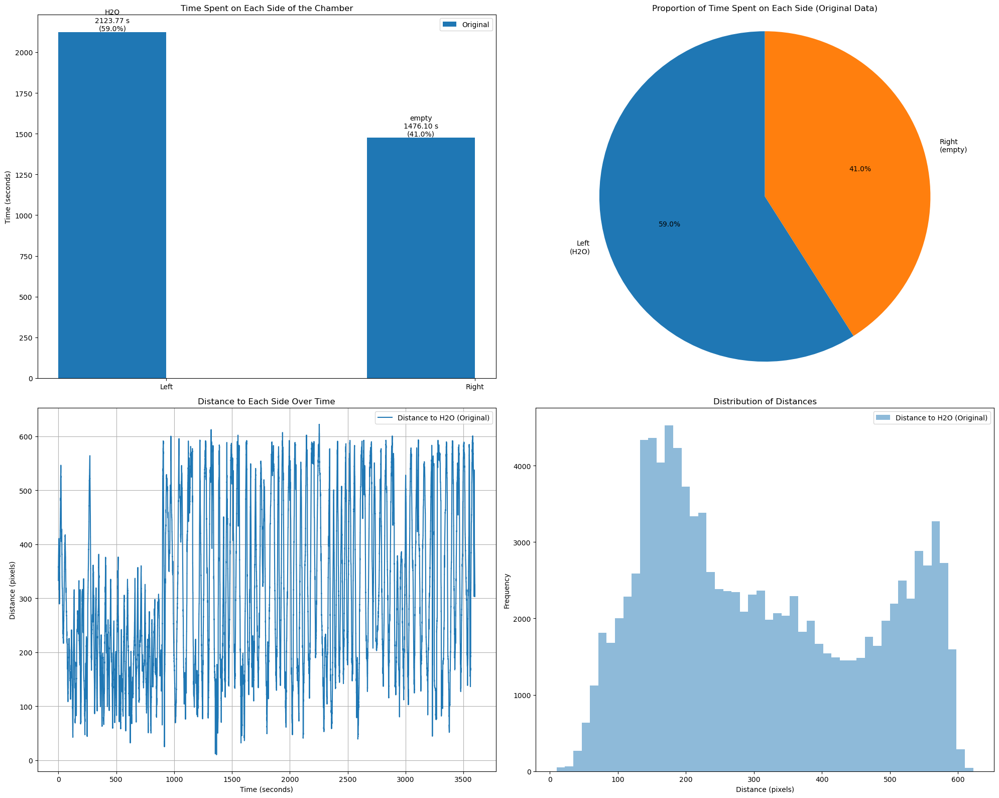

Statistics and distances saved to h5 file
Analysis completed.
FAILED
Analysis completed.


/tmp/ipykernel_11912/1452383975.py:73: RuntimeWarning: invalid value encountered in scalar divide
  stats_group.attrs['left_percentage'] = left_frames / total_frames * 100
/tmp/ipykernel_11912/1452383975.py:74: RuntimeWarning: invalid value encountered in scalar divide
  stats_group.attrs['right_percentage'] = right_frames / total_frames * 100
/tmp/ipykernel_11912/1452383975.py:105: RuntimeWarning: invalid value encountered in scalar divide
  left_label = f"{left_syringe}\n{left_time:.2f} s\n({left_frames / total_frames * 100:.1f}%)"
/tmp/ipykernel_11912/1452383975.py:106: RuntimeWarning: invalid value encountered in scalar divide
  right_label = f"{right_syringe}\n{right_time:.2f} s\n({right_frames / total_frames * 100:.1f}%)"
/home/jmdelahanty/miniforge3/envs/sleap_analysis/lib/python3.9/site-packages/matplotlib/axes/_axes.py:3232: RuntimeWarning: invalid value encountered in divide
  x = x / sx
posx and posy should be finite values
posx and posy should be finite values


Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0004/20240718_sub-0004_OnePortEtohExperiment/20240718_sub-0004_OnePortEtohExperiment_output_chamber_analysis.png


ValueError: need at least one array to concatenate

<Figure size 2000x1600 with 4 Axes>

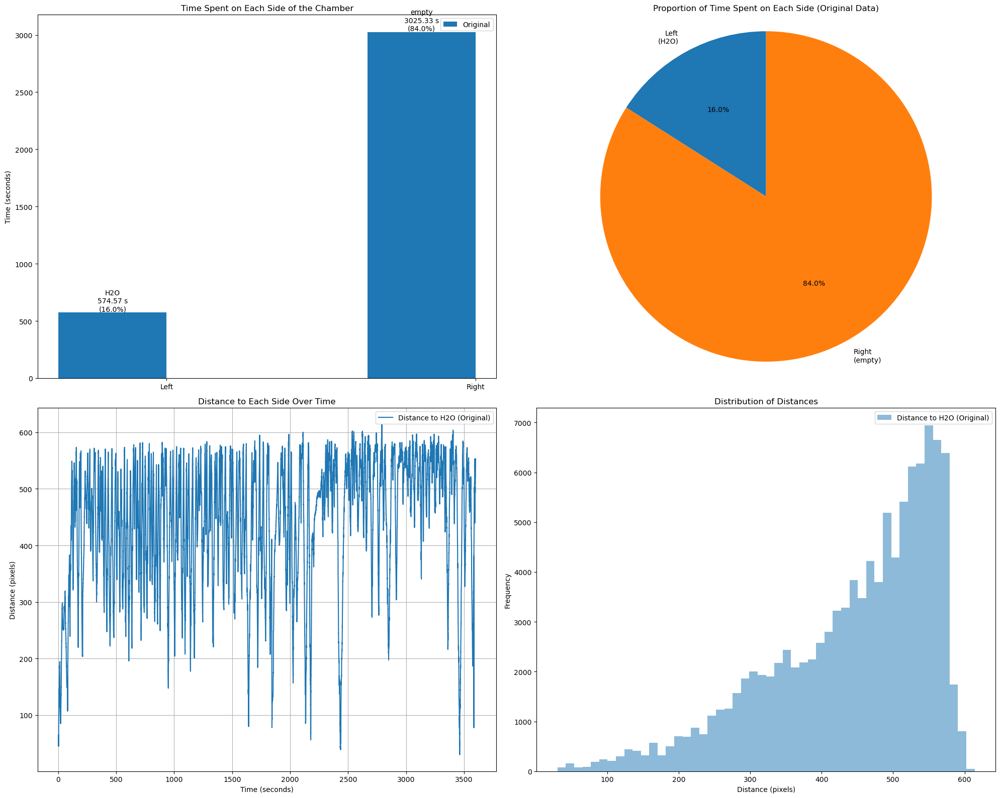

Statistics and distances saved to h5 file
Analysis completed.
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0005/20240719_sub-0005_OnePortEtohExperiment/20240719_sub-0005_OnePortEtohExperiment_output_chamber_analysis.png


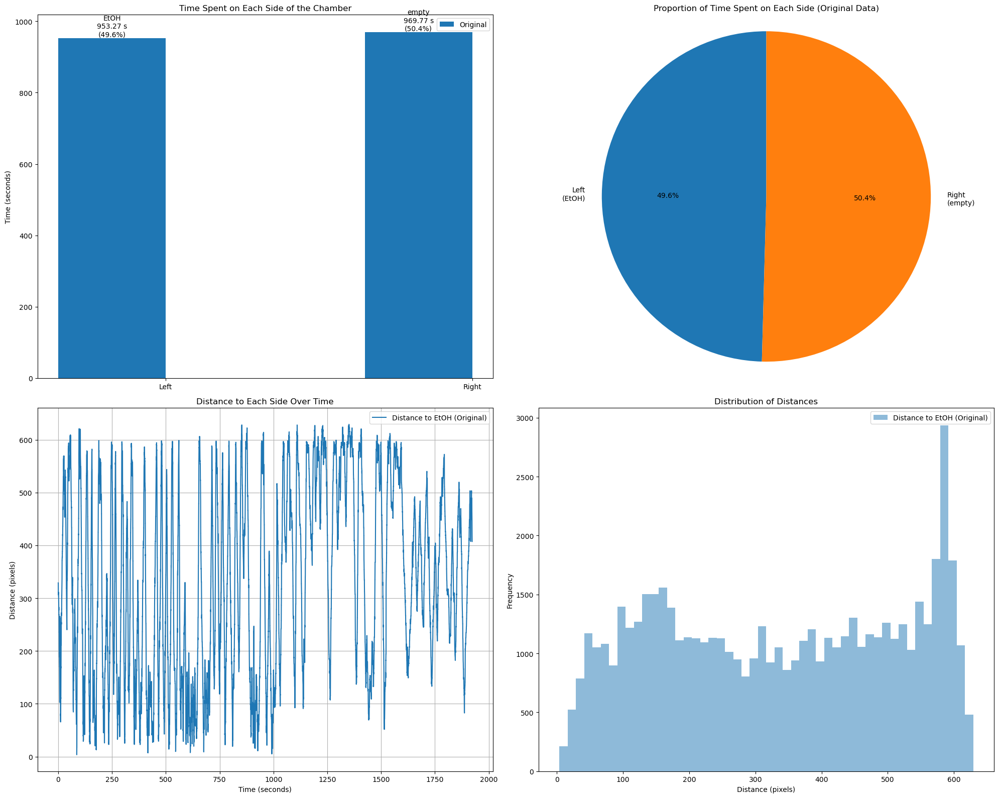

Statistics and distances saved to h5 file
Analysis completed.
FAILED
Analysis completed.
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0007/20240719_sub-0007_OnePortEtohExperiment/20240719_sub-0007_OnePortEtohExperiment_output_chamber_analysis.png


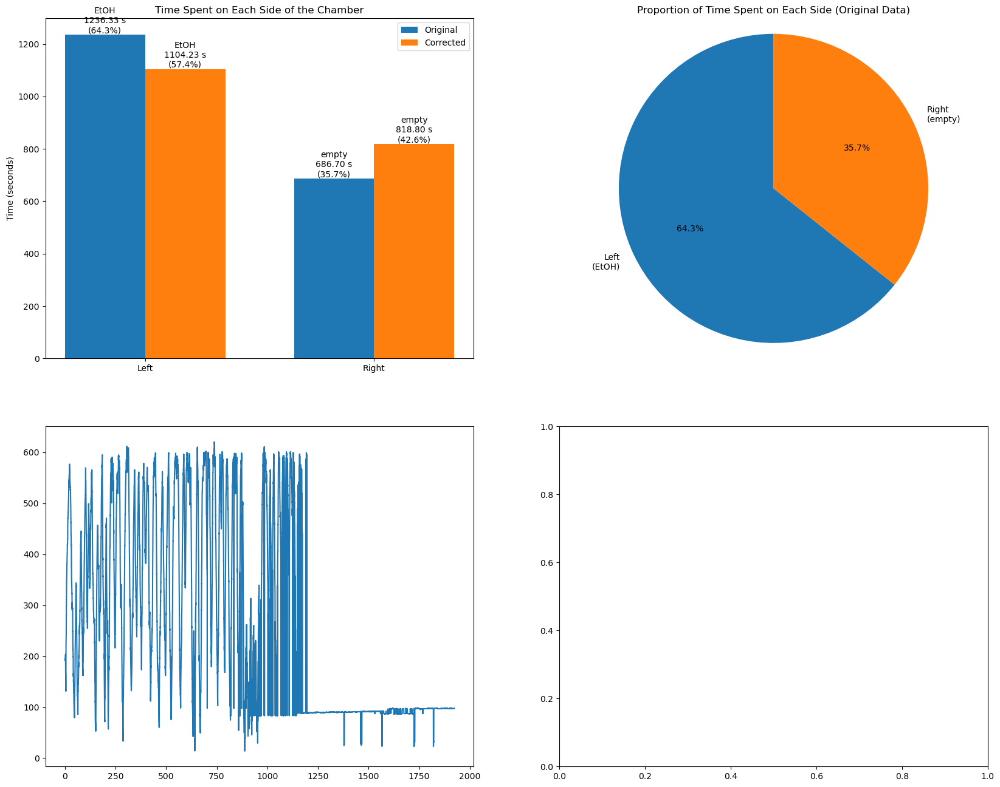

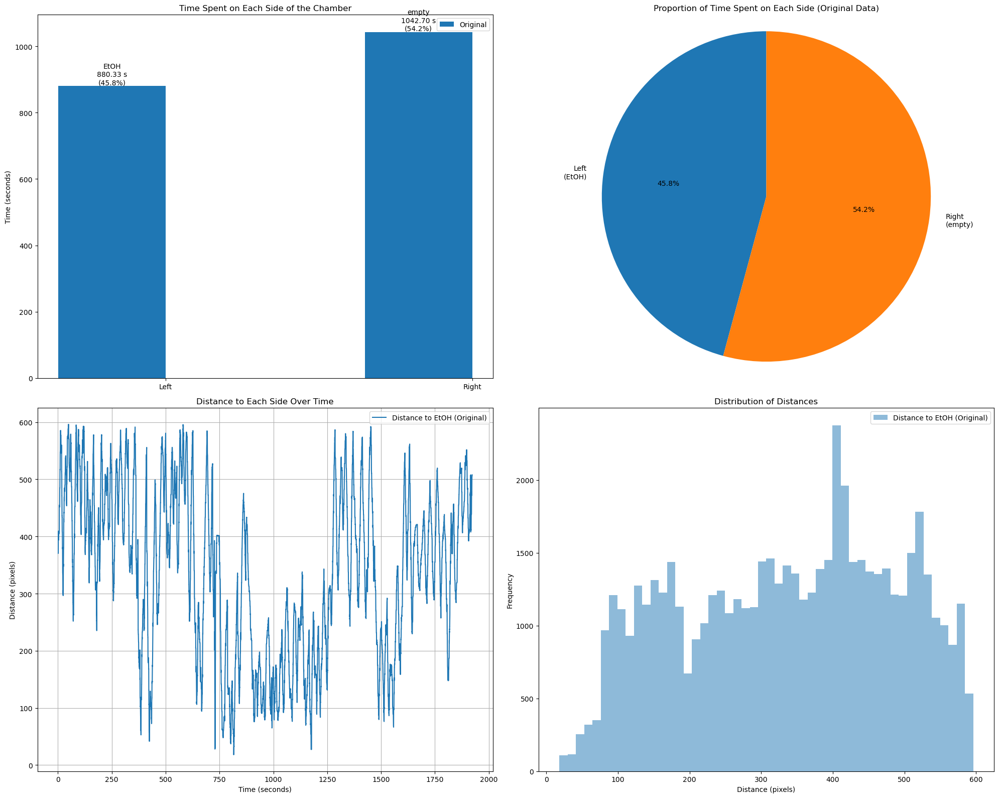

Statistics and distances saved to h5 file
Analysis completed.
FAILED
Analysis completed.
FAILED
Analysis completed.
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0010/20240719_sub-0010_OnePortEtohExperiment/20240719_sub-0010_OnePortEtohExperiment_output_chamber_analysis.png


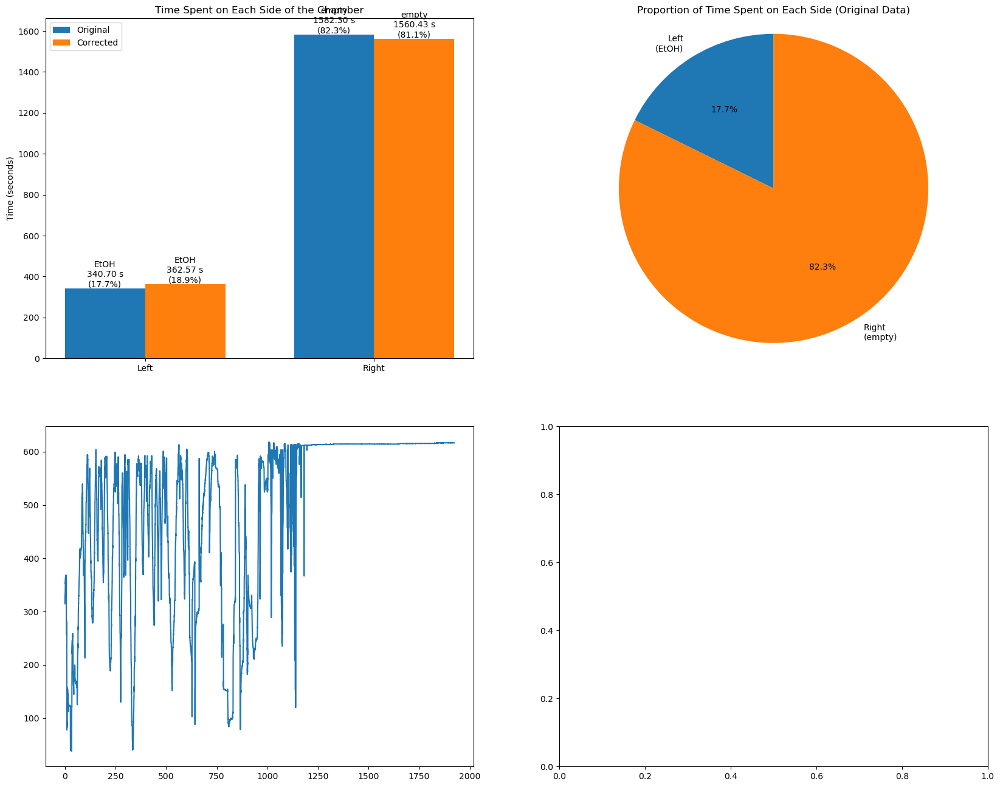

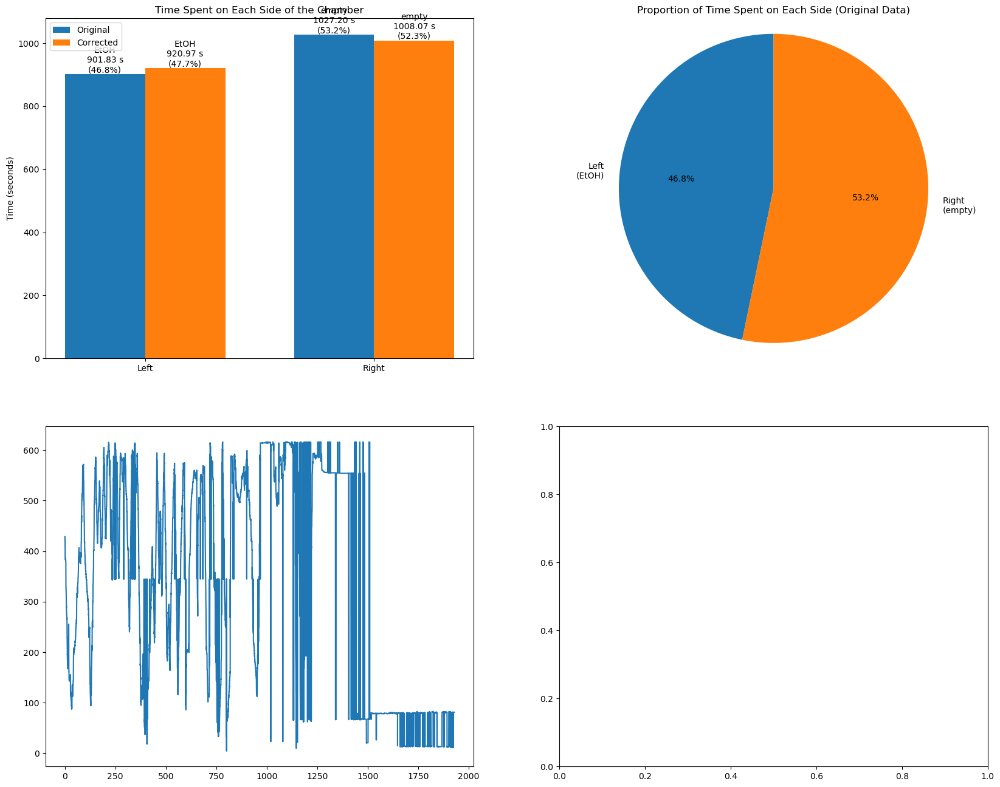

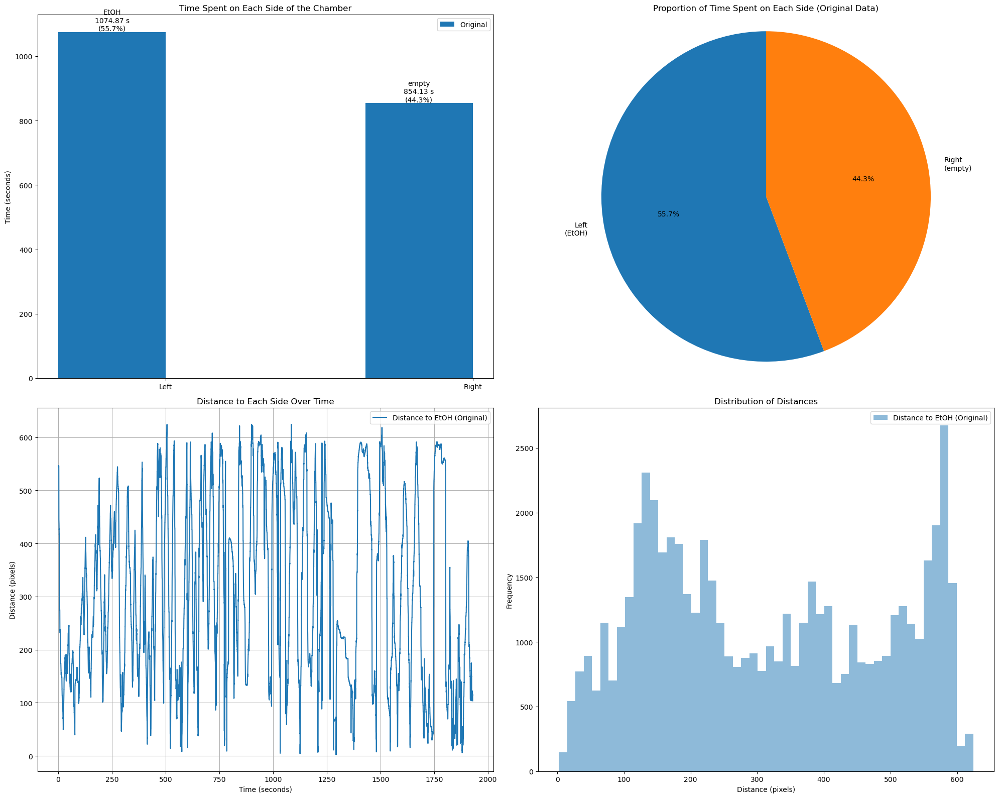

Statistics and distances saved to h5 file
Analysis completed.
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0011/20240719_sub-0011_OnePortEtohExperiment/20240719_sub-0011_OnePortEtohExperiment_output_chamber_analysis.png


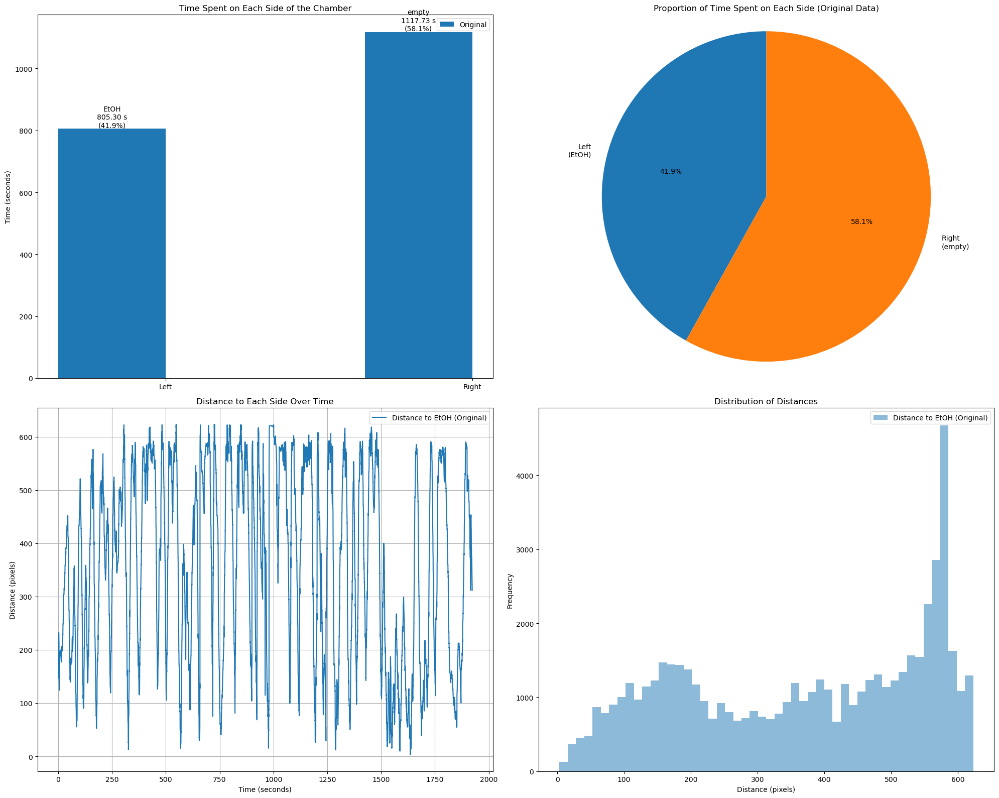

Statistics and distances saved to h5 file
Analysis completed.
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0012/20240719_sub-0012_OnePortEtohExperiment/20240719_sub-0012_OnePortEtohExperiment_output_chamber_analysis.png


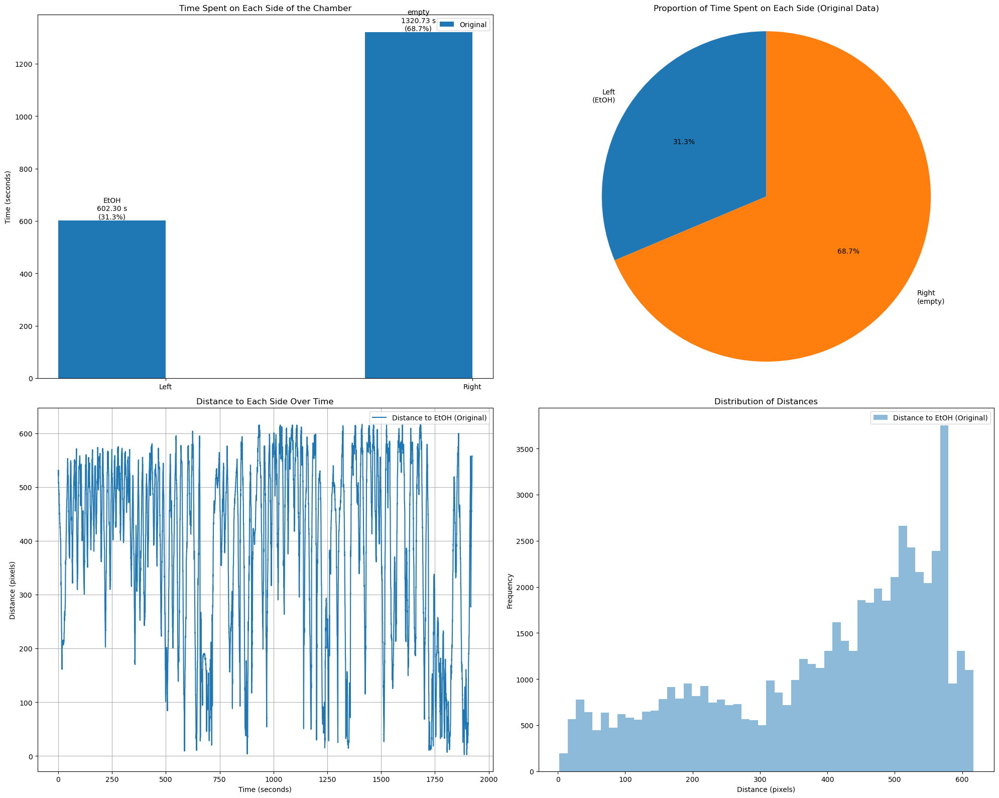

Statistics and distances saved to h5 file
Analysis completed.
FAILED
Analysis completed.
FAILED
Analysis completed.
FAILED
Analysis completed.
FAILED
Analysis completed.
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0017/20240722_sub-0017_OnePortEtohExperiment/20240722_sub-0017_OnePortEtohExperiment_output_chamber_analysis.png


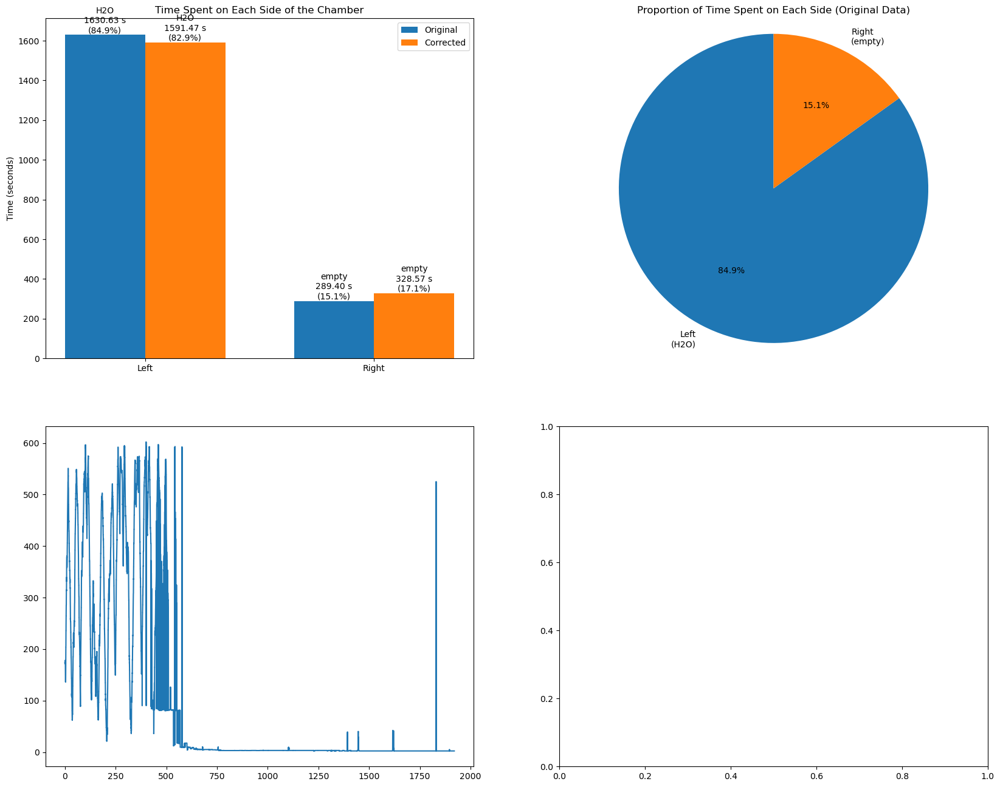

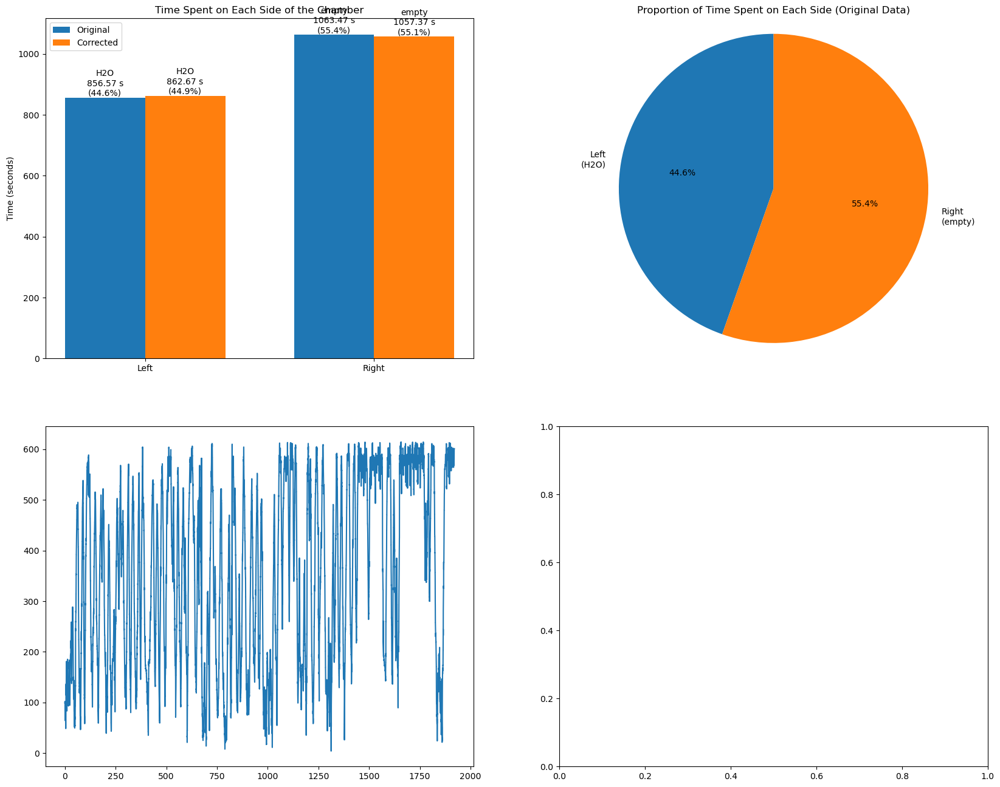

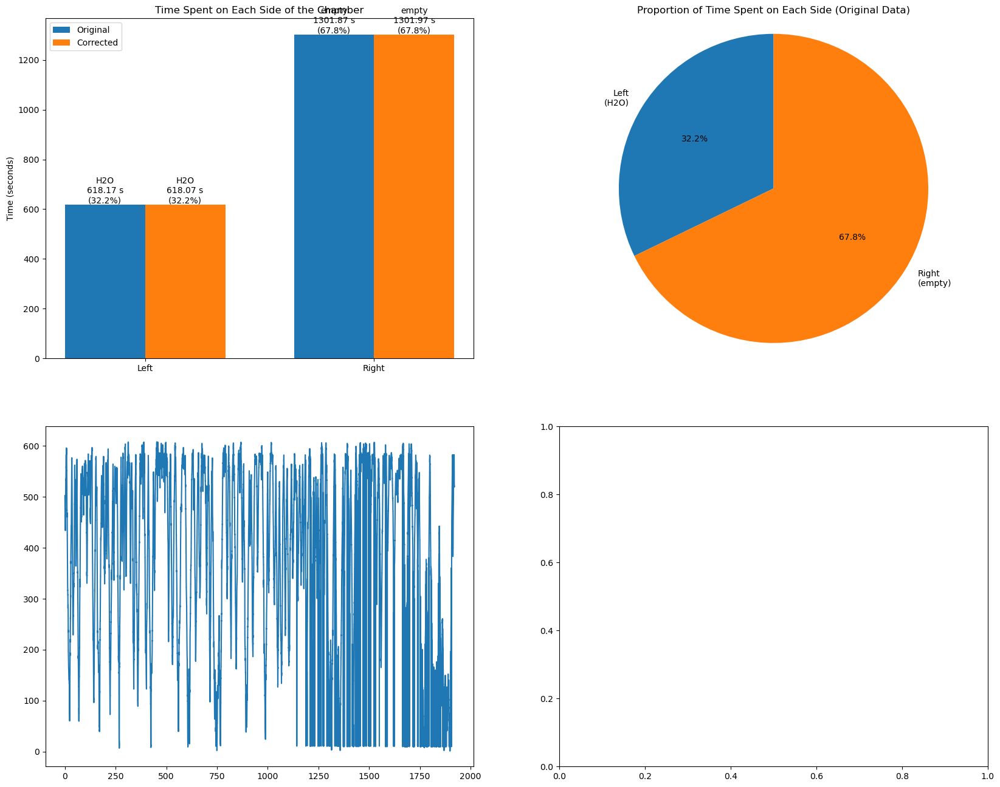

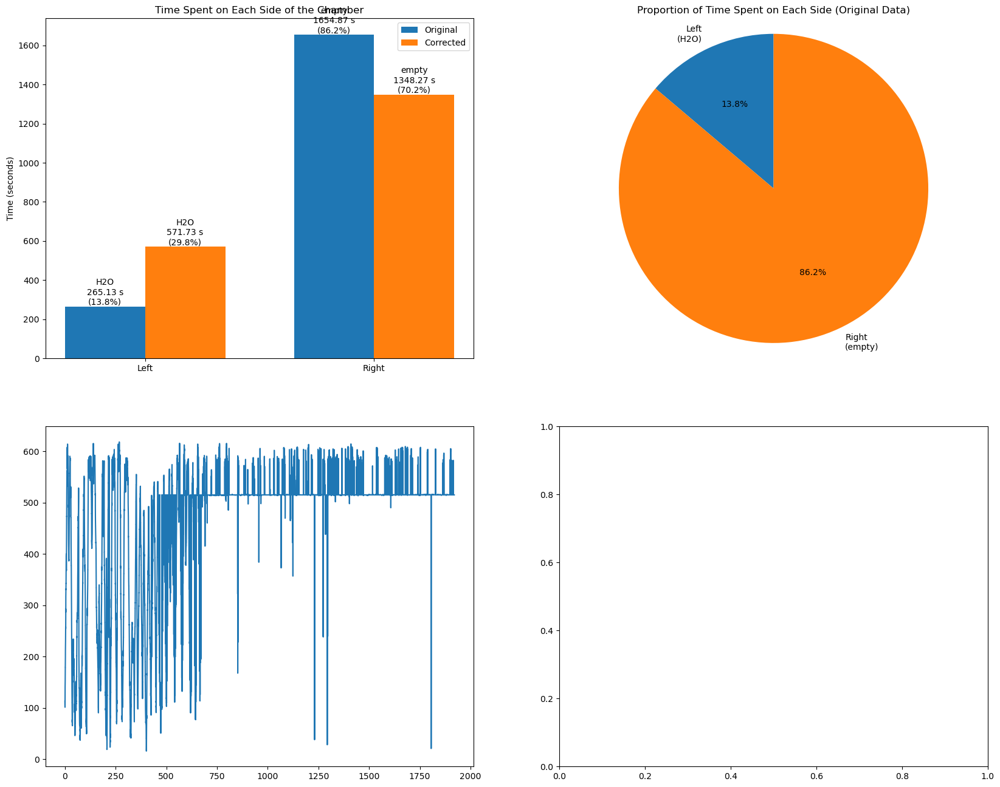

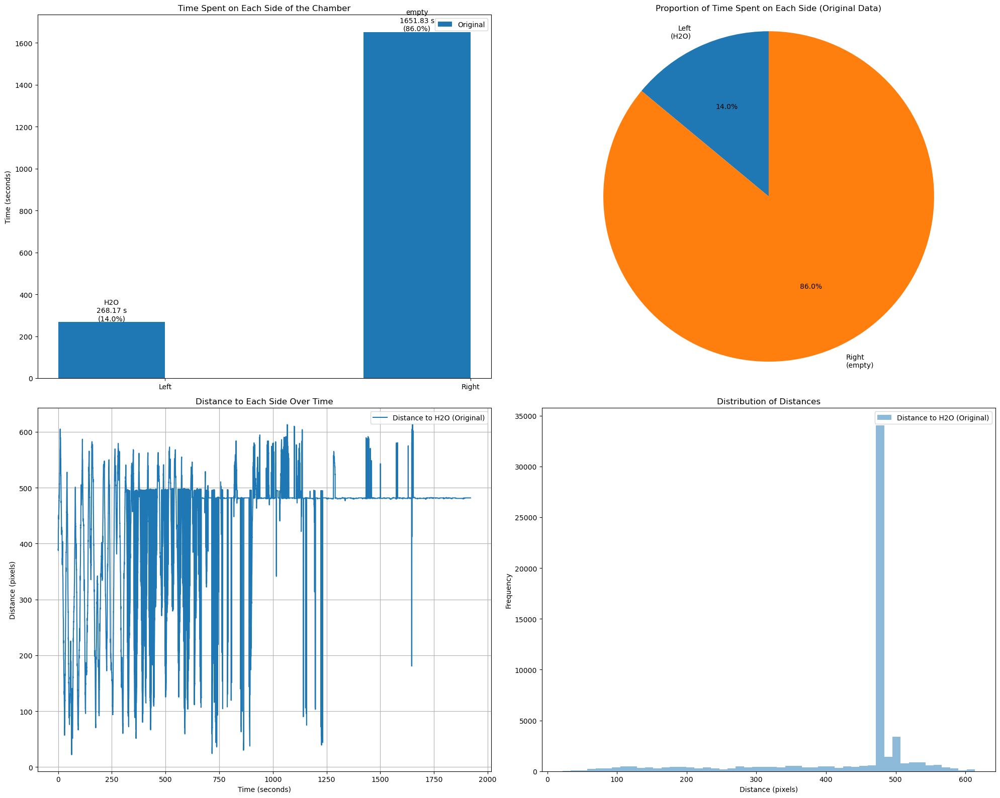

Statistics and distances saved to h5 file
Analysis completed.
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0018/20240722_sub-0018_OnePortEtohExperiment/20240722_sub-0018_OnePortEtohExperiment_output_chamber_analysis.png


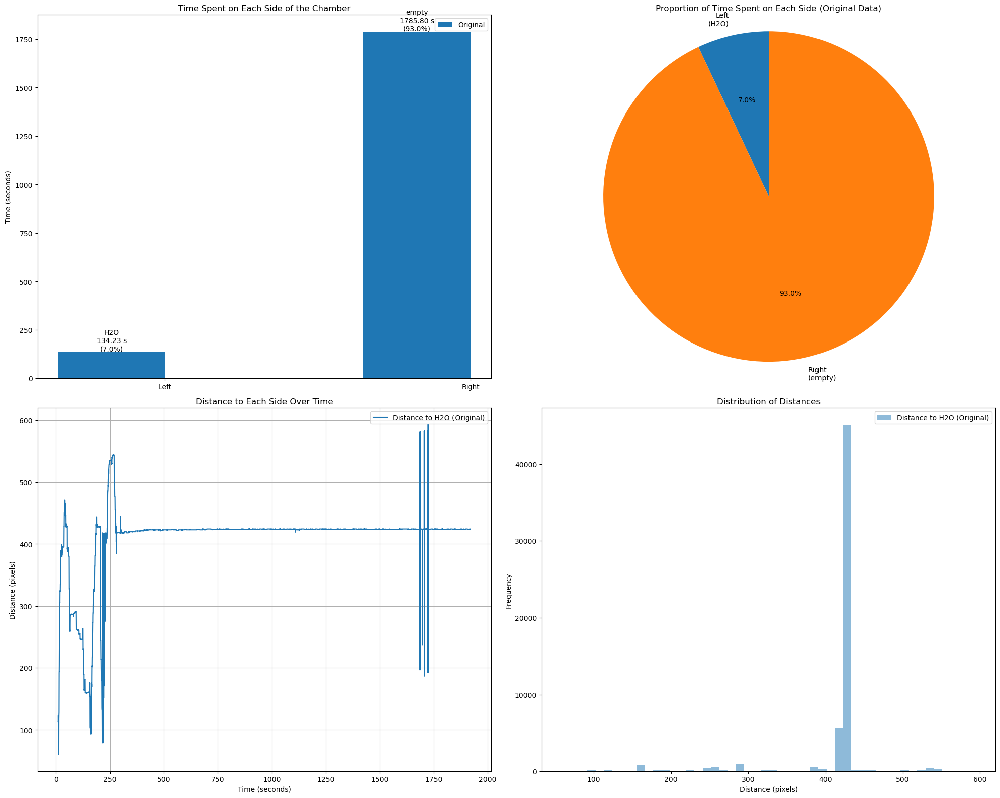

Statistics and distances saved to h5 file
Analysis completed.
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0019/20240722_sub-0019_OnePortEtohExperiment/20240722_sub-0019_OnePortEtohExperiment_output_chamber_analysis.png


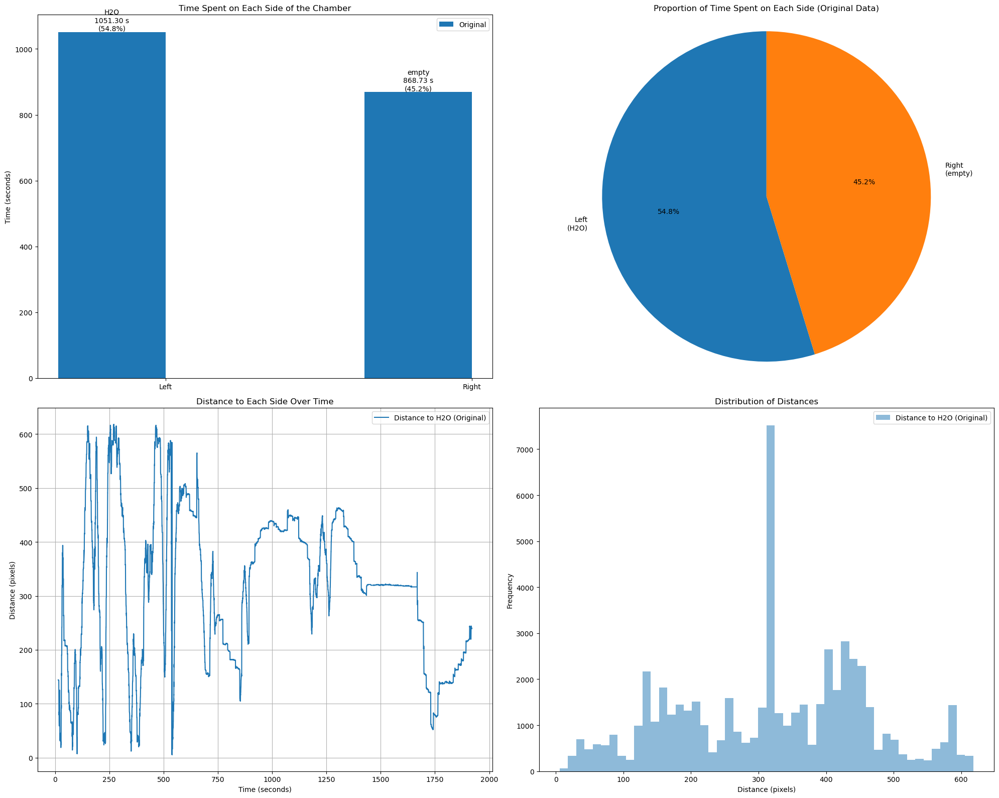

Statistics and distances saved to h5 file
Analysis completed.
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0020/20240722_sub-0020_OnePortEtohExperiment/20240722_sub-0020_OnePortEtohExperiment_output_chamber_analysis.png


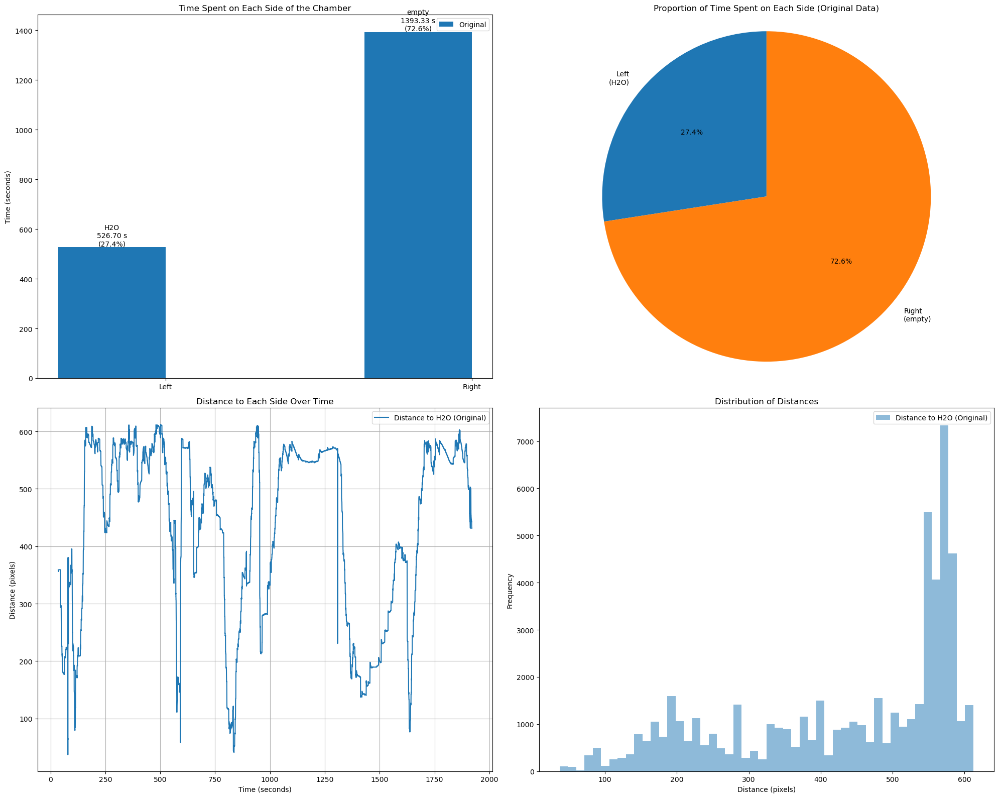

Statistics and distances saved to h5 file
Analysis completed.
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0021/20240722_sub-0021_OnePortEtohExperiment/20240722_sub-0021_OnePortEtohExperiment_output_chamber_analysis.png


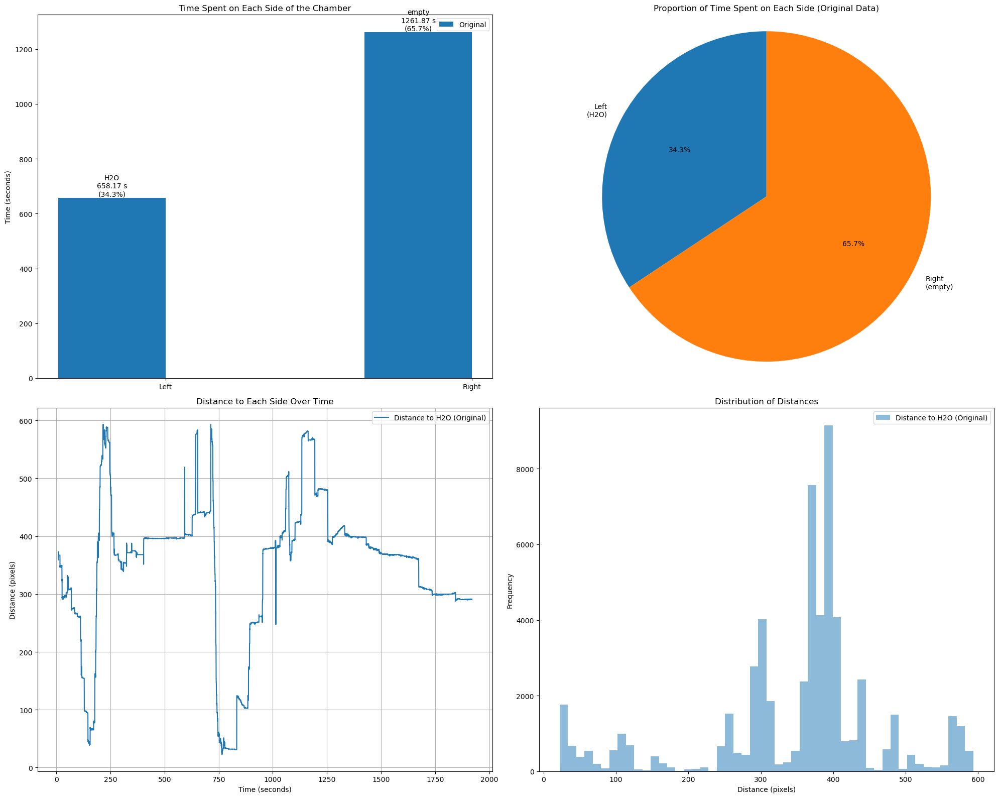

Statistics and distances saved to h5 file
Analysis completed.
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0022/20240724_sub-0022_OnePortEtohExperiment/20240724_sub-0022_OnePortEtohExperiment_output_chamber_analysis.png


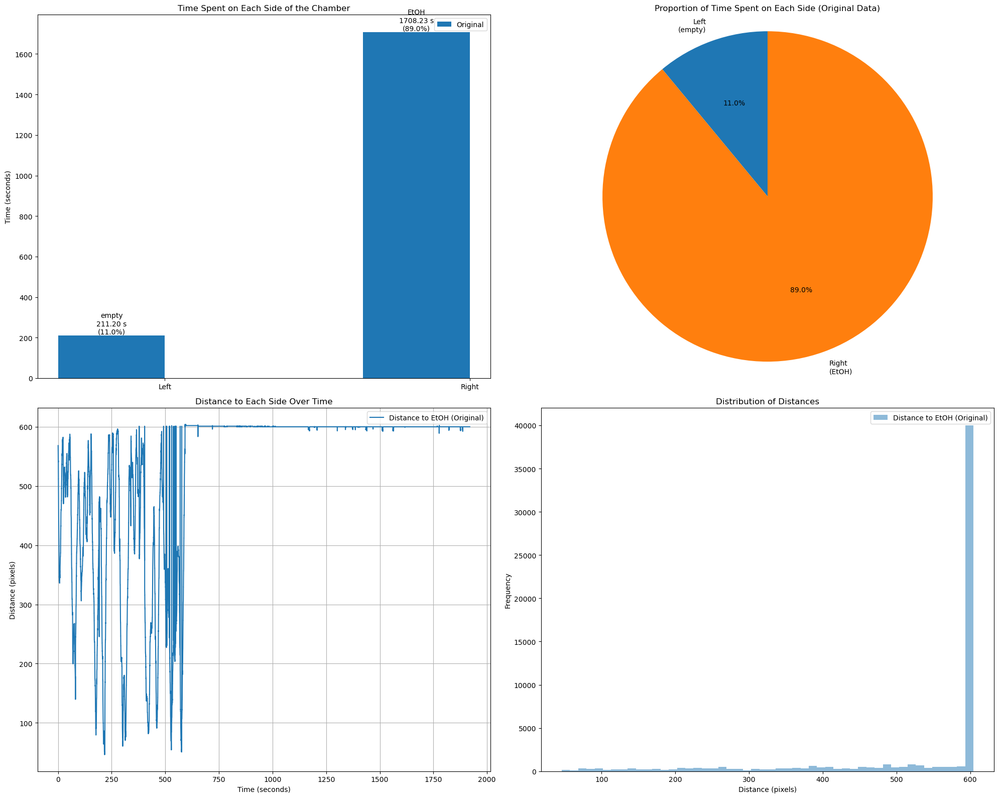

Statistics and distances saved to h5 file
Analysis completed.
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0027/20240724_sub-0027_OnePortEtohExperiment/20240724_sub-0027_OnePortEtohExperiment_output_chamber_analysis.png


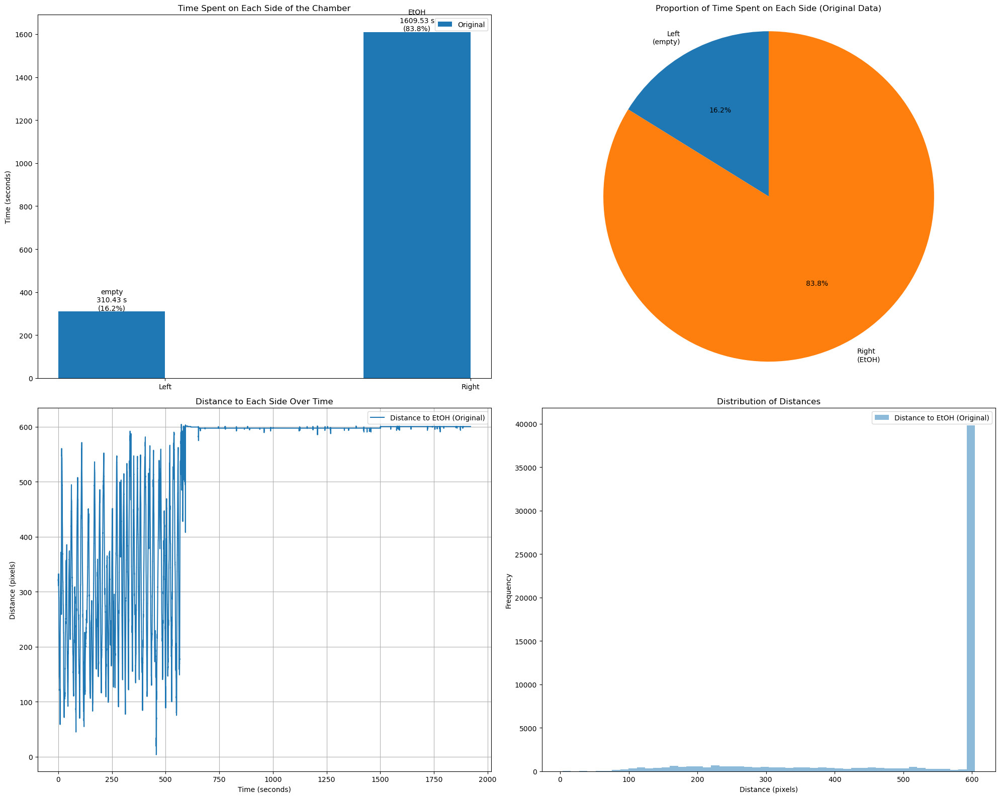

Statistics and distances saved to h5 file
Analysis completed.
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0028/20240724_sub-0028_OnePortEtohExperiment/20240724_sub-0028_OnePortEtohExperiment_output_chamber_analysis.png


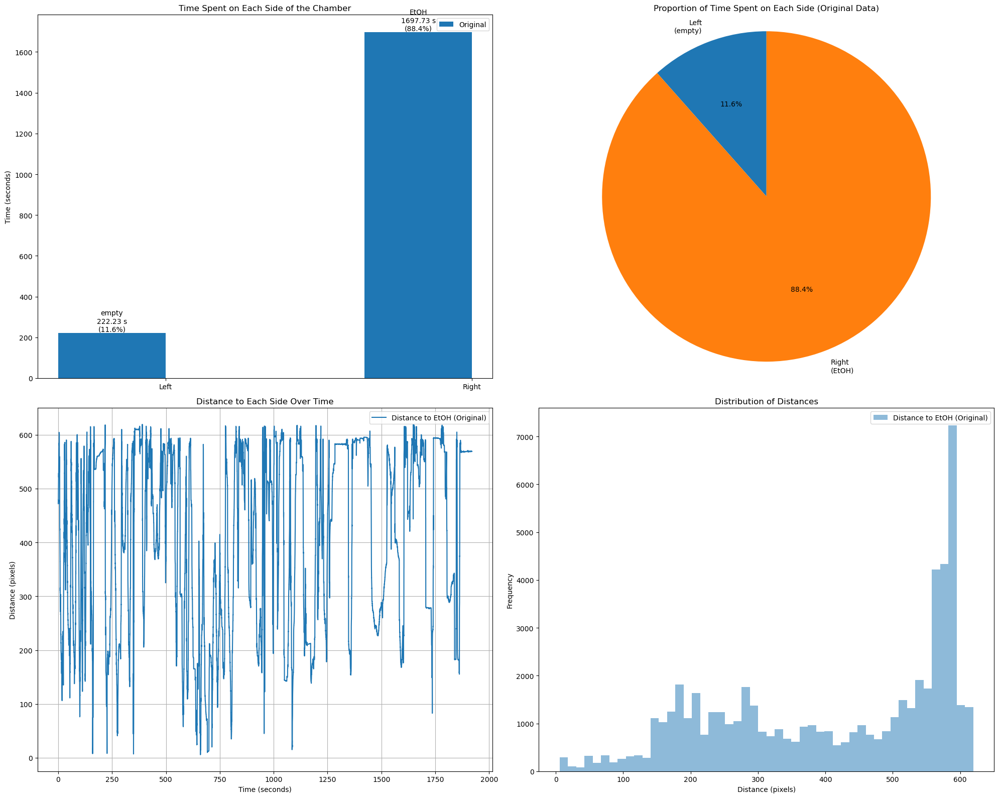

Statistics and distances saved to h5 file
Analysis completed.
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0038/20240724_sub-0038_OnePortEtohExperiment/20240725_sub-0038_OnePortEtohExperiment_output_chamber_analysis.png


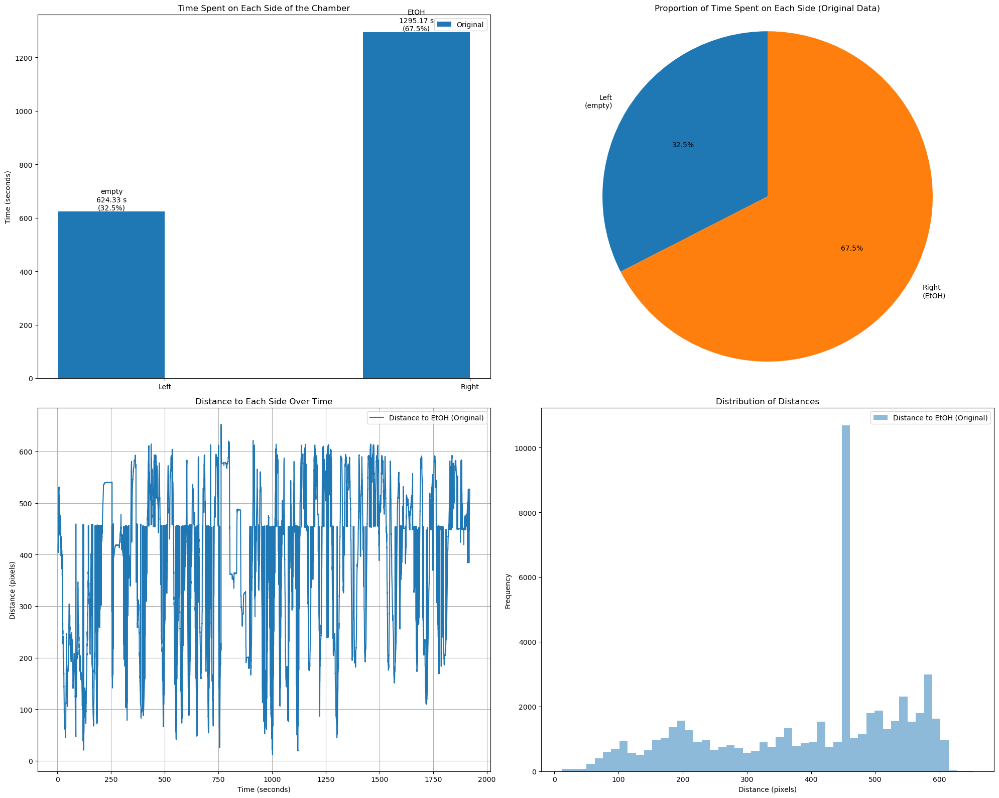

Statistics and distances saved to h5 file
Analysis completed.
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0039/20240724_sub-0039_OnePortEtohExperiment/20240725_sub-0039_OnePortEtohExperiment_output_chamber_analysis.png


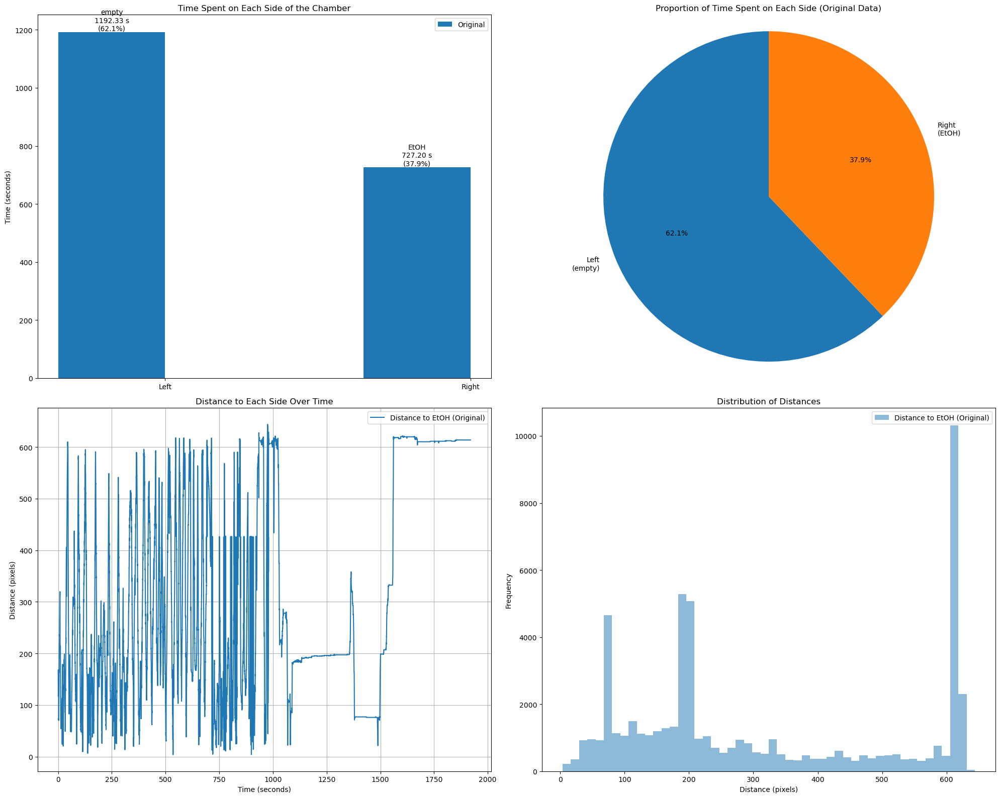

Statistics and distances saved to h5 file
Analysis completed.
No output files found.


In [36]:
import h5py
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path

def analyze_chamber_time_and_distances(h5_file_path: Path):
    """
    Analyze the time spent on left and right sides of the chamber, calculate distances
    to each point, plot the results including distance plots, and save the statistics 
    and distances to the h5 file for both original and corrected data (if available).

    Args:
    h5_file_path (Path): Path to the h5 file containing fish tracking data and syringe information.
    """
    def process_data(center, label):
        df = pd.DataFrame(center, columns=['x', 'y'])
        
        # Determine which side the fish is on for each frame
        df['side'] = np.where(df['x'] < midpoint, 'left', 'right')
        
        # Calculate total frames and time spent on each side
        total_frames = len(df)
        left_frames = (df['side'] == 'left').sum()
        right_frames = (df['side'] == 'right').sum()
        
        # Assuming 30 fps, convert frames to seconds
        fps = 30
        left_time = left_frames / fps
        right_time = right_frames / fps
        
        # Calculate distances to left and right points
        df['dist_left'] = np.sqrt(np.sum((center - left_point)**2, axis=1))
        df['dist_right'] = np.sqrt(np.sum((center - right_point)**2, axis=1))
        
        return df, total_frames, left_frames, right_frames, left_time, right_time
        
    try:
        with h5py.File(h5_file_path, 'r+') as f:
            # Load center coordinates
            center = f['center'][:]
            
            # Load syringe contents
            left_syringe = f.attrs.get('left_syringe', 'Unknown')
            right_syringe = f.attrs.get('right_syringe', 'Unknown')
            
            # Load chamber coordinates
            chamber_coords = eval(f.attrs.get('points', '{}'))
            left_point = np.array(chamber_coords.get('Left', (0, 0)))
            right_point = np.array(chamber_coords.get('Right', (0, 0)))
    
            # Calculate midpoint
            midpoint = (left_point[0] + right_point[0]) / 2
    
            # Process original data
            df, total_frames, left_frames, right_frames, left_time, right_time = process_data(center, 'Original')
    
            # Check if corrected data exists
            corrected_file_path = h5_file_path.with_name(f"{h5_file_path.stem}_corrected.h5")
            if corrected_file_path.exists():
                with h5py.File(corrected_file_path, 'r') as f_corr:
                    center_corr = f_corr['center'][:]
                df_corr, total_frames_corr, left_frames_corr, right_frames_corr, left_time_corr, right_time_corr = process_data(center_corr, 'Corrected')
    
            # Save statistics to the h5 file
            stats_group = f.require_group('chamber_stats')
            stats_group.attrs['total_frames'] = total_frames
            stats_group.attrs['total_time'] = total_frames / 30
            stats_group.attrs['left_frames'] = left_frames
            stats_group.attrs['left_time'] = left_time
            stats_group.attrs['right_frames'] = right_frames
            stats_group.attrs['right_time'] = right_time
            stats_group.attrs['left_percentage'] = left_frames / total_frames * 100
            stats_group.attrs['right_percentage'] = right_frames / total_frames * 100
    
            # Save distances to the h5 file
            distance_data = {}
            for side, content in [('left', left_syringe), ('right', right_syringe)]:
                if content not in ['Unknown', 'empty']:
                    dataset_name = f'dist_{content}'
                    if dataset_name in f:
                        del f[dataset_name]
                    f.create_dataset(dataset_name, data=df[f'dist_{side}'])
                    distance_data[content] = df[f'dist_{side}']
    
        # Plot the results
        fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 16))
        
        # Bar plot
        bar_width = 0.35
        index = np.arange(2)
        ax1.bar(index, [left_time, right_time], bar_width, label='Original')
        if corrected_file_path.exists():
            ax1.bar(index + bar_width, [left_time_corr, right_time_corr], bar_width, label='Corrected')
        ax1.set_ylabel('Time (seconds)')
        ax1.set_title('Time Spent on Each Side of the Chamber')
        ax1.set_xticks(index + bar_width / 2)
        ax1.set_xticklabels(['Left', 'Right'])
        ax1.legend()
    
        # Add labels to the bars
        def add_labels(ax, x, height, label):
            ax.text(x, height, label, ha='center', va='bottom')
    
        left_label = f"{left_syringe}\n{left_time:.2f} s\n({left_frames / total_frames * 100:.1f}%)"
        right_label = f"{right_syringe}\n{right_time:.2f} s\n({right_frames / total_frames * 100:.1f}%)"
        add_labels(ax1, index[0], left_time, left_label)
        add_labels(ax1, index[1], right_time, right_label)
    
        if corrected_file_path.exists():
            left_label_corr = f"{left_syringe}\n{left_time_corr:.2f} s\n({left_frames_corr / total_frames_corr * 100:.1f}%)"
            right_label_corr = f"{right_syringe}\n{right_time_corr:.2f} s\n({right_frames_corr / total_frames_corr * 100:.1f}%)"
            add_labels(ax1, index[0] + bar_width, left_time_corr, left_label_corr)
            add_labels(ax1, index[1] + bar_width, right_time_corr, right_label_corr)
        
        # Pie chart
        sizes = [left_frames, right_frames]
        labels = [f'Left\n({left_syringe})', f'Right\n({right_syringe})']
        ax2.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90)
        ax2.axis('equal')
        ax2.set_title('Proportion of Time Spent on Each Side (Original Data)')
        
        # Distance plots
        time_axis = np.arange(total_frames) / 30
        for content, distances in distance_data.items():
            ax3.plot(time_axis, distances, label=f'Distance to {content} (Original)')
        if corrected_file_path.exists():
            for content, distances in distance_data.items():
                ax3.plot(time_axis, df_corr[f'dist_{content.lower()}'], label=f'Distance to {content} (Corrected)', linestyle='--')
        ax3.set_xlabel('Time (seconds)')
        ax3.set_ylabel('Distance (pixels)')
        ax3.set_title('Distance to Each Side Over Time')
        ax3.legend()
        ax3.grid(True)
    
        # Histogram of distances
        for content, distances in distance_data.items():
            ax4.hist(distances, bins=50, alpha=0.5, label=f'Distance to {content} (Original)')
        if corrected_file_path.exists():
            for content, distances in distance_data.items():
                ax4.hist(df_corr[f'dist_{content.lower()}'], bins=50, alpha=0.5, label=f'Distance to {content} (Corrected)')
        ax4.set_xlabel('Distance (pixels)')
        ax4.set_ylabel('Frequency')
        ax4.set_title('Distribution of Distances')
        ax4.legend()
        
        plt.tight_layout()
        
        # Save the plot
        output_path = h5_file_path.with_name(f"{h5_file_path.stem}_chamber_analysis.png")
        plt.savefig(output_path)
        print(f"Plot saved to {output_path}")
        
        # Show the plot
        plt.show()
        
        print("Statistics and distances saved to h5 file")
        
        return df if not corrected_file_path.exists() else (df, df_corr)
    except:
        print("FAILED")
        

# Example usage
if __name__ == "__main__":
    data_directory = Path("~/OneDrive").expanduser().resolve()
    output_files = get_output_h5_files(data_directory)
    
    for i in output_files:
        # Analyze chamber time and distances for the first file
        result = analyze_chamber_time_and_distances(i)
        print("Analysis completed.")
    else:
        print("No output files found.")

Found 26 output h5 files.
Number of NaN values: 26
Plot saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0001/20240718_sub-0001_OnePortEtohExperiment/20240718_sub-0001_OnePortEtohExperiment_output_interpolated_path_plot_nearest.png


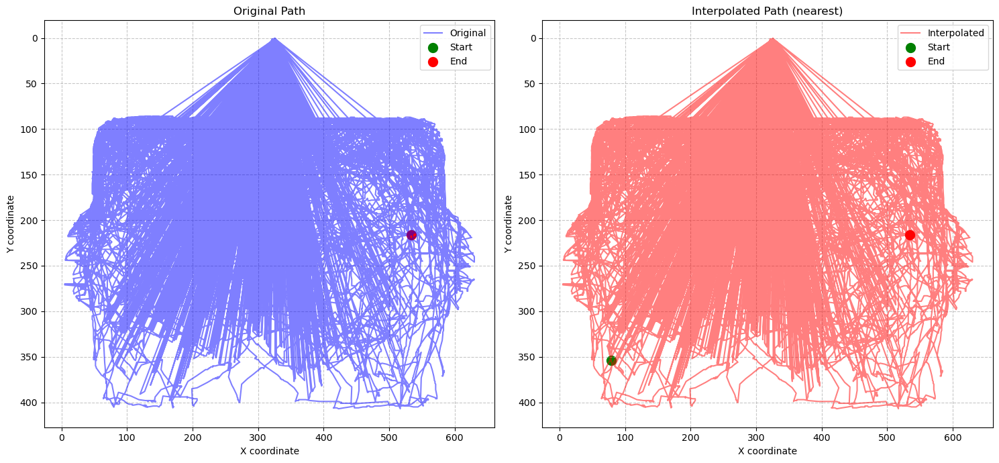

First 5 rows of interpolated data:
      x      y
0  79.0  354.0
1  79.0  354.0
2  79.0  354.0
3  79.0  354.0
4  79.0  354.0


In [29]:
import h5py
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy import interpolate
from pathlib import Path

def interpolate_and_plot_fish_position(file_path: Path, method='cubic'):
    """
    Load fish coordinates from an h5 file, interpolate NaN values using scipy,
    and plot the original and interpolated paths.

    Args:
    file_path (Path): Path to the h5 file containing fish tracking data.
    method (str): Interpolation method ('linear', 'nearest', 'zero', 'slinear', 'quadratic', 'cubic')
    """
    with h5py.File(file_path, 'r') as f:
        # Load the center coordinates
        center = f['center'][:]
    
    # Create a DataFrame
    df = pd.DataFrame(center, columns=['x', 'y'])
    
    # Count NaN values
    nan_count = df.isna().sum().sum()
    print(f"Number of NaN values: {nan_count}")
    
    # Create an array of frame numbers
    frames = np.arange(len(df))
    
    # Interpolate x and y separately
    mask_x = ~np.isnan(df['x'])
    mask_y = ~np.isnan(df['y'])
    
    f_x = interpolate.interp1d(frames[mask_x], df['x'][mask_x], kind=method, fill_value="extrapolate")
    f_y = interpolate.interp1d(frames[mask_y], df['y'][mask_y], kind=method, fill_value="extrapolate")
    
    x_interpolated = f_x(frames)
    y_interpolated = f_y(frames)
    
    df_interpolated = pd.DataFrame({'x': x_interpolated, 'y': y_interpolated})
    
    # Plot original and interpolated paths
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 7))
    
    # Original path
    ax1.plot(df['x'], df['y'], 'b-', alpha=0.5, label='Original')
    ax1.scatter(df['x'].iloc[0], df['y'].iloc[0], color='green', s=100, label='Start')
    ax1.scatter(df['x'].iloc[-1], df['y'].iloc[-1], color='red', s=100, label='End')
    ax1.set_title('Original Path')
    ax1.set_xlabel('X coordinate')
    ax1.set_ylabel('Y coordinate')
    ax1.legend()
    ax1.invert_yaxis()
    ax1.grid(True, linestyle='--', alpha=0.7)
    
    # Interpolated path
    ax2.plot(df_interpolated['x'], df_interpolated['y'], 'r-', alpha=0.5, label='Interpolated')
    ax2.scatter(df_interpolated['x'].iloc[0], df_interpolated['y'].iloc[0], color='green', s=100, label='Start')
    ax2.scatter(df_interpolated['x'].iloc[-1], df_interpolated['y'].iloc[-1], color='red', s=100, label='End')
    ax2.set_title(f'Interpolated Path ({method})')
    ax2.set_xlabel('X coordinate')
    ax2.set_ylabel('Y coordinate')
    ax2.legend()
    ax2.invert_yaxis()
    ax2.grid(True, linestyle='--', alpha=0.7)
    
    plt.tight_layout()
    
    # Save the plot
    output_path = file_path.with_name(f"{file_path.stem}_interpolated_path_plot_{method}.png")
    plt.savefig(output_path)
    print(f"Plot saved to {output_path}")
    
    # Show the plot
    plt.show()
    
    return df_interpolated

# Example usage
if __name__ == "__main__":
    
    data_directory = Path("~/OneDrive").expanduser().resolve()
    output_files = get_output_h5_files(data_directory)
    
    if output_files:
        # Interpolate and plot the first file
        interpolated_df = interpolate_and_plot_fish_position(output_files[0], method='nearest')
        print("First 5 rows of interpolated data:")
        print(interpolated_df.head())
    else:
        print("No output files found.")

interactive(children=(Checkbox(value=True, description='Show Original'), Checkbox(value=True, description='Sho…

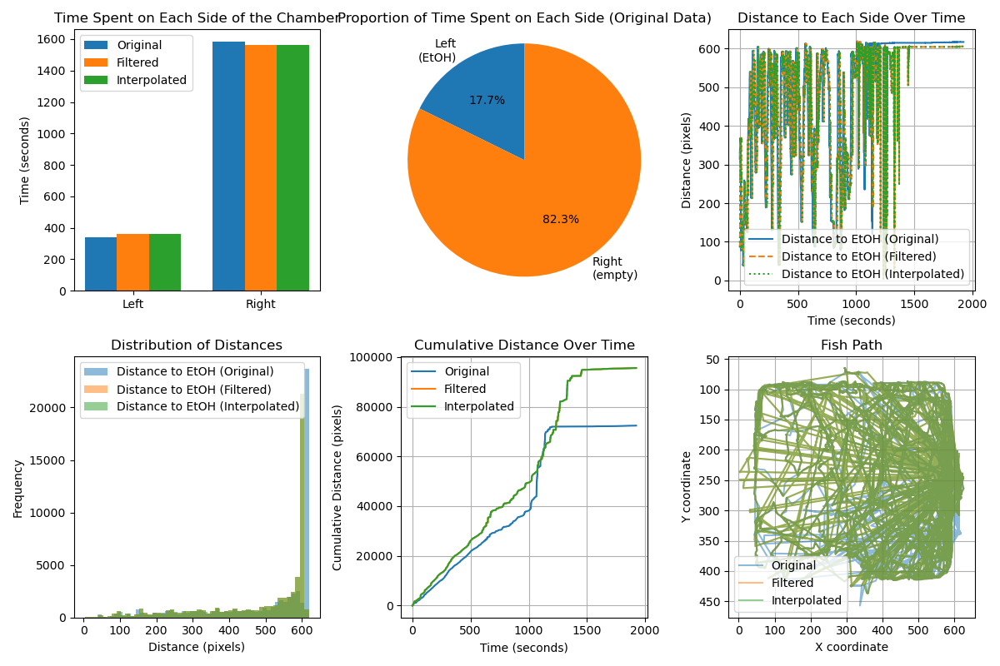

In [88]:
import h5py
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from ipywidgets import interact, interactive, fixed, widgets
from IPython.display import display
from pathlib import Path

# Make sure to run '%matplotlib widget' in a cell before using this function

def expanded_interactive_chamber_analysis(original_file_path: Path, filtered_file_path: Path, interpolated_file_path: Path):
    """
    Create an expanded interactive plot for chamber analysis with toggleable datasets in a Jupyter notebook using IPython magic.
    Includes cumulative distance and path plots.

    Args:
    original_file_path (Path): Path to the original h5 file containing fish tracking data and syringe information.
    filtered_file_path (Path): Path to the filtered h5 file.
    interpolated_file_path (Path): Path to the interpolated h5 file.
    """
        # Extract subject ID from filename
    match = re.search(r'sub-(\d+)', original_file_path.stem)
    if match:
        subject_id = f"sub-{match.group(1)}"
    else:
        subject_id = "Unknown_Subject"

    def process_data(center, label):
        df = pd.DataFrame(center, columns=['x', 'y'])
        df['side'] = np.where(df['x'] < midpoint, 'left', 'right')
        total_frames = len(df)
        left_frames = (df['side'] == 'left').sum()
        right_frames = (df['side'] == 'right').sum()
        fps = 30
        left_time = left_frames / fps
        right_time = right_frames / fps
        df['dist_left'] = np.sqrt(np.sum((center - left_point)**2, axis=1))
        df['dist_right'] = np.sqrt(np.sum((center - right_point)**2, axis=1))
        
        # Calculate cumulative distance
        df['step_distance'] = np.sqrt(np.sum(np.diff(center, axis=0, prepend=center[0:1])**2, axis=1))
        df['cumulative_distance'] = np.cumsum(df['step_distance'])
        
        return df, total_frames, left_frames, right_frames, left_time, right_time

    # Load and process data
    with h5py.File(original_file_path, 'r') as f:
        center_original = f['center'][:]
        left_syringe = f.attrs.get('left_syringe', 'Unknown')
        right_syringe = f.attrs.get('right_syringe', 'Unknown')
        chamber_coords = eval(f.attrs.get('points', '{}'))
        left_point = np.array(chamber_coords.get('Left', (0, 0)))
        right_point = np.array(chamber_coords.get('Right', (0, 0)))

    midpoint = (left_point[0] + right_point[0]) / 2

    with h5py.File(filtered_file_path, 'r') as f:
        center_filtered = f['center'][:]
    with h5py.File(interpolated_file_path, 'r') as f:
        center_interpolated = f['center'][:]

    df_original, total_frames, left_frames, right_frames, left_time, right_time = process_data(center_original, 'Original')
    df_filtered, _, _, _, left_time_filtered, right_time_filtered = process_data(center_filtered, 'Filtered')
    df_interpolated, _, _, _, left_time_interpolated, right_time_interpolated = process_data(center_interpolated, 'Interpolated')

    fig, ((ax1, ax2, ax3), (ax4, ax5, ax6)) = plt.subplots(2, 3, figsize=(12, 8))
    plt.subplots_adjust(left=0.1, bottom=0.1, right=0.9, top=0.9, wspace=0.3, hspace=0.3)

    def update_plot(show_original, show_filtered, show_interpolated):
        ax1.clear()
        ax3.clear()
        ax4.clear()
        ax5.clear()
        ax6.clear()

        # Bar plot
        bar_width = 0.25
        index = np.arange(2)
        if show_original:
            ax1.bar(index - bar_width, [left_time, right_time], bar_width, label='Original')
        if show_filtered:
            ax1.bar(index, [left_time_filtered, right_time_filtered], bar_width, label='Filtered')
        if show_interpolated:
            ax1.bar(index + bar_width, [left_time_interpolated, right_time_interpolated], bar_width, label='Interpolated')
        ax1.set_ylabel('Time (seconds)')
        ax1.set_title('Time Spent on Each Side of the Chamber')
        ax1.set_xticks(index)
        ax1.set_xticklabels(['Left', 'Right'])
        ax1.legend()

        # Pie chart (using original data)
        ax2.clear()
        sizes = [left_frames, right_frames]
        labels = [f'Left\n({left_syringe})', f'Right\n({right_syringe})']
        ax2.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90)
        ax2.axis('equal')
        ax2.set_title('Proportion of Time Spent on Each Side (Original Data)')

        # Distance plots
        time_axis = np.arange(total_frames) / 30
        for content, side in zip([left_syringe, right_syringe], ['left', 'right']):
            if content not in ['Unknown', 'empty']:
                if show_original:
                    ax3.plot(time_axis, df_original[f'dist_{side}'], label=f'Distance to {content} (Original)')
                if show_filtered:
                    ax3.plot(time_axis, df_filtered[f'dist_{side}'], label=f'Distance to {content} (Filtered)', linestyle='--')
                if show_interpolated:
                    ax3.plot(time_axis, df_interpolated[f'dist_{side}'], label=f'Distance to {content} (Interpolated)', linestyle=':')
        ax3.set_xlabel('Time (seconds)')
        ax3.set_ylabel('Distance (pixels)')
        ax3.set_title('Distance to Each Side Over Time')
        ax3.legend()
        ax3.grid(True)

        # Histogram of distances
        for content, side in zip([left_syringe, right_syringe], ['left', 'right']):
            if content not in ['Unknown', 'empty']:
                if show_original:
                    ax4.hist(df_original[f'dist_{side}'], bins=50, alpha=0.5, label=f'Distance to {content} (Original)')
                if show_filtered:
                    ax4.hist(df_filtered[f'dist_{side}'], bins=50, alpha=0.5, label=f'Distance to {content} (Filtered)')
                if show_interpolated:
                    ax4.hist(df_interpolated[f'dist_{side}'], bins=50, alpha=0.5, label=f'Distance to {content} (Interpolated)')
        ax4.set_xlabel('Distance (pixels)')
        ax4.set_ylabel('Frequency')
        ax4.set_title('Distribution of Distances')
        ax4.legend()

        # Cumulative distance plot
        if show_original:
            ax5.plot(time_axis, df_original['cumulative_distance'], label='Original')
        if show_filtered:
            ax5.plot(time_axis, df_filtered['cumulative_distance'], label='Filtered')
        if show_interpolated:
            ax5.plot(time_axis, df_interpolated['cumulative_distance'], label='Interpolated')
        ax5.set_xlabel('Time (seconds)')
        ax5.set_ylabel('Cumulative Distance (pixels)')
        ax5.set_title('Cumulative Distance Over Time')
        ax5.legend()
        ax5.grid(True)

        # Path plot
        if show_original:
            ax6.plot(df_original['x'], df_original['y'], label='Original', alpha=0.5)
        if show_filtered:
            ax6.plot(df_filtered['x'], df_filtered['y'], label='Filtered', alpha=0.5)
        if show_interpolated:
            ax6.plot(df_interpolated['x'], df_interpolated['y'], label='Interpolated', alpha=0.5)
        ax6.set_xlabel('X coordinate')
        ax6.set_ylabel('Y coordinate')
        ax6.set_title('Fish Path')
        ax6.legend()
        ax6.grid(True)
        ax6.invert_yaxis()  # Invert y-axis to match image coordinates

        fig.canvas.draw_idle()

    # Create interactive widgets
    interact(update_plot,
             show_original=widgets.Checkbox(value=True, description='Show Original'),
             show_filtered=widgets.Checkbox(value=True, description='Show Filtered'),
             show_interpolated=widgets.Checkbox(value=True, description='Show Interpolated'))

    plt.tight_layout()
    plt.show()

    return df_original, df_filtered, df_interpolated

# Example usage
if __name__ == "__main__":
    expanded_interactive_chamber_analysis(original, filtered, interpolated)

In [52]:
def apply_distance_threshold(coordinates: np.ndarray, threshold: float) -> np.ndarray:
    """
    Check the distance between consecutive points, and replace values with NaN if the distance exceeds the threshold.

    Args:
    coordinates (np.ndarray): Array of coordinates.
    threshold (float): Maximum allowed distance between consecutive points.

    Returns:
    np.ndarray: Array of coordinates with values replaced by NaN where the distance
                between consecutive points exceeds the threshold.
    """
    distances = np.sqrt(np.sum(np.diff(coordinates, axis=0)**2, axis=1))
    mask = np.concatenate(([False], distances > threshold))
    filtered_coordinates = coordinates.copy()
    filtered_coordinates[mask] = np.nan
    return filtered_coordinates

def interpolate_nan_values(coordinates: np.ndarray, method: str = 'linear') -> np.ndarray:
    """
    Interpolate NaN values based on the last known distances.

    Args:
    coordinates (np.ndarray): Array of coordinates with NaN values.
    method (str): Interpolation method ('linear', 'nearest', 'zero', 'slinear', 'quadratic', 'cubic').
                  Default is 'linear'.

    Returns:
    np.ndarray: Array of coordinates with NaN values interpolated.
    """
    nan_mask = np.isnan(coordinates[:, 0]) | np.isnan(coordinates[:, 1])
    frames = np.arange(len(coordinates))
    
    for i in range(2):  # 0 for x, 1 for y
        valid_frames = frames[~nan_mask]
        valid_coords = coordinates[~nan_mask, i]
        f = interpolate.interp1d(valid_frames, valid_coords, kind=method, fill_value="extrapolate")
        coordinates[:, i] = f(frames)
    
    return coordinates

def batch_filter_interpolate(data_directory: Path, threshold: float = 10.0, method: str = 'linear'):
    """
    Process all corrected files in the given directory, apply filtering and interpolation,
    and save the results as new files.

    Args:
    data_directory (Path): Path to the directory containing the h5 files.
    threshold (float): Maximum allowed distance between consecutive points for filtering.
    method (str): Interpolation method.
    """
    # Get all corrected output files
    corrected_files = list(data_directory.glob("**/*_output_corrected.h5"))
    
    for corrected_file in corrected_files:
        print(f"Processing: {corrected_file.name}")
        
        # Load data
        with h5py.File(corrected_file, 'r') as f:
            coordinates = f['center'][:]
        
        # Apply filtering
        filtered_coordinates = apply_distance_threshold(coordinates, threshold)
        
        # Apply interpolation
        interpolated_coordinates = interpolate_nan_values(filtered_coordinates, method)
        
        # Save filtered data
        filtered_file = corrected_file.with_name(f"{corrected_file.stem}_filtered.h5")
        with h5py.File(filtered_file, 'w') as f:
            f.create_dataset('center', data=filtered_coordinates)
        print(f"Filtered data saved to {filtered_file}")
        
        # Save interpolated data
        interpolated_file = corrected_file.with_name(f"{corrected_file.stem}_interpolated.h5")
        with h5py.File(interpolated_file, 'w') as f:
            f.create_dataset('center', data=interpolated_coordinates)
        print(f"Interpolated data saved to {interpolated_file}")
        
    print("All files processed.")

# Example usage
if __name__ == "__main__":
    data_directory = Path("~/OneDrive/lgfl/rawdata").expanduser().resolve()
    batch_filter_interpolate(data_directory)

Processing: 20240719_sub-0009_OnePortEtohExperiment_output_corrected.h5
Filtered data saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0009/20240719_sub-0009_OnePortEtohExperiment/20240719_sub-0009_OnePortEtohExperiment_output_corrected_filtered.h5
Interpolated data saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0009/20240719_sub-0009_OnePortEtohExperiment/20240719_sub-0009_OnePortEtohExperiment_output_corrected_interpolated.h5
Processing: 20240722_sub-0013_OnePortEtohExperiment_output_corrected.h5
Filtered data saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0013/20240722_sub-0013_OnePortEtohExperiment/20240722_sub-0013_OnePortEtohExperiment_output_corrected_filtered.h5
Interpolated data saved to /home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0013/20240722_sub-0013_OnePortEtohExperiment/20240722_sub-0013_OnePortEtohExperiment_output_corrected_interpolated.h5
Processing: 20240722_sub-0016_OnePortEtohExperiment_output_corrected.h5
Filtered data saved to /home/jmdelahanty/One

/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0005/20240719_sub-0005_OnePortEtohExperiment
/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0021/20240722_sub-0021_OnePortEtohExperiment
/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0022/20240724_sub-0022_OnePortEtohExperiment
/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0020/20240722_sub-0020_OnePortEtohExperiment
/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0003/20240718_sub-0003_OnePortEtohExperiment
/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0039/20240724_sub-0039_OnePortEtohExperiment
/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0009/20240719_sub-0009_OnePortEtohExperiment
/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0038/20240724_sub-0038_OnePortEtohExperiment
/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0013/20240722_sub-0013_OnePortEtohExperiment
/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0027/20240724_sub-0027_OnePortEtohExperiment
/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0016/20240722_sub-0016_OnePortEtohExperiment
/home/jmdelahanty/One

Dropdown(description='Subject:', options=('0001', '0002', '0003', '0004', '0005', '0006', '0007', '0008', '000…

interactive(children=(Dropdown(description='Subject:', options=('0001', '0002', '0003', '0004', '0005', '0006'…

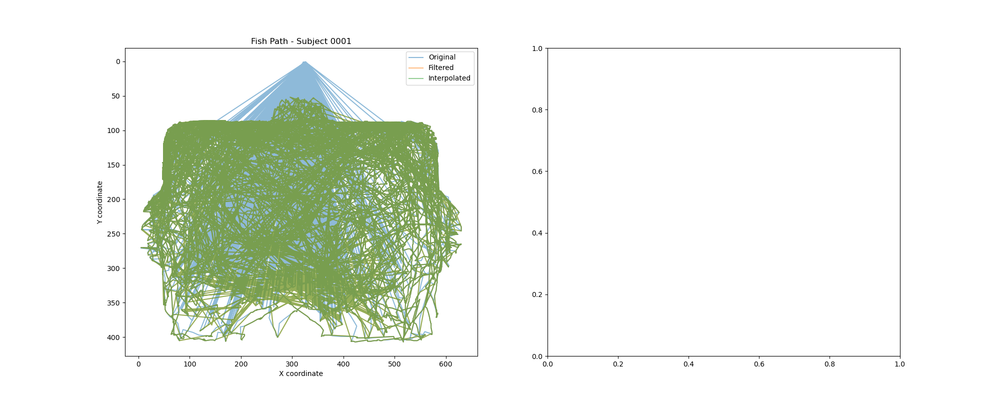

In [64]:
import h5py
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from ipywidgets import interact, interactive, fixed, widgets
from IPython.display import display, clear_output
from pathlib import Path

def interactive_subject_analysis(data_directory: Path):
    """
    Create an interactive display with a dropdown menu to select subjects and show their processed datasets.

    Args:
    data_directory (Path): Path to the directory containing the processed h5 files.
    """
    # Find all subjects
    subjects = []
    for file in data_directory.glob("*/*"):
        print(file)
        subject_id = file.parent.name.split('_')[0]  # Assuming format like "sub-0001_..."
        if subject_id.startswith("sub-"):
            subjects.append(subject_id[4:])  # Remove "sub-" prefix
    subjects = sorted(set(subjects))
    print(subjects)

    if not subjects:
        print(f"No subjects found in {data_directory}. Please check the directory structure.")
        return

    def load_data(file_path):
        try:
            with h5py.File(file_path, 'r') as f:
                return f['center'][:]
        except Exception as e:
            print(f"Error loading {file_path}: {str(e)}")
            return None

    def plot_data(subject):
        clear_output(wait=True)
        
        # Find files for the selected subject
        subject_files = list(data_directory.rglob(f"*sub-{subject}*/*_output*.h5"))
        if not subject_files:
            print(f"No files found for subject {subject}. Please check the data directory.")
            return

        original_file = next((f for f in subject_files if "_output.h5" in f.name), None)
        filtered_file = next((f for f in subject_files if "_output_corrected_filtered.h5" in f.name), None)
        interpolated_file = next((f for f in subject_files if "_output_corrected_interpolated.h5" in f.name), None)

        # Load data
        original_data = load_data(original_file) if original_file else None
        filtered_data = load_data(filtered_file) if filtered_file else None
        interpolated_data = load_data(interpolated_file) if interpolated_file else None

        if original_data is None and filtered_data is None and interpolated_data is None:
            print(f"No valid data found for subject {subject}.")
            return

        # Create plot
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))

        # Path plot
        if original_data is not None:
            ax1.plot(original_data[:, 0], original_data[:, 1], label='Original', alpha=0.5)
        if filtered_data is not None:
            ax1.plot(filtered_data[:, 0], filtered_data[:, 1], label='Filtered', alpha=0.5)
        if interpolated_data is not None:
            ax1.plot(interpolated_data[:, 0], interpolated_data[:, 1], label='Interpolated', alpha=0.5)
        ax1.set_title(f'Fish Path - Subject {subject}')
        ax1.set_xlabel('X coordinate')
        ax1.set_ylabel('Y coordinate')
        ax1.legend()
        ax1.invert_yaxis()

        # Cumulative distance plot
        def calculate_cumulative_distance(data):
            return np.cumsum(np.sqrt(np.sum(np.diff(data, axis=0)**2, axis=1)))

        max_length = max(len(data) for data in [original_data, filtered_data, interpolated_data] if data is not None)
        time_axis = np.arange(max_length) / 30  # Assuming 30 fps

        if original_data is not None:
            ax2.plot(time_axis[:len(original_data)], calculate_cumulative_distance(original_data), label='Original')
        if filtered_data is not None:
            ax2.plot(time_axis[:len(filtered_data)], calculate_cumulative_distance(filtered_data), label='Filtered')
        if interpolated_data is not None:
            ax2.plot(time_axis[:len(interpolated_data)], calculate_cumulative_distance(interpolated_data), label='Interpolated')
        ax2.set_title(f'Cumulative Distance - Subject {subject}')
        ax2.set_xlabel('Time (seconds)')
        ax2.set_ylabel('Cumulative Distance (pixels)')
        ax2.legend()

        plt.tight_layout()
        plt.show()

        # Display some statistics
        print(f"Statistics for Subject {subject}:")
        if original_data is not None:
            print(f"Original data points: {len(original_data)}")
        if filtered_data is not None:
            print(f"Filtered data points: {len(filtered_data)}")
        if interpolated_data is not None:
            print(f"Interpolated data points: {len(interpolated_data)}")

    # Create the dropdown widget and display
    subject_dropdown = widgets.Dropdown(options=subjects, description='Subject:')
    display(subject_dropdown)
    
    # Connect the dropdown to the plot function
    interact(plot_data, subject=subject_dropdown)

# Example usage
if __name__ == "__main__":
    data_directory = Path("~/OneDrive/lgfl/rawdata").expanduser().resolve()
    interactive_subject_analysis(data_directory)

interactive(children=(Checkbox(value=True, description='Show Original'), Checkbox(value=True, description='Sho…

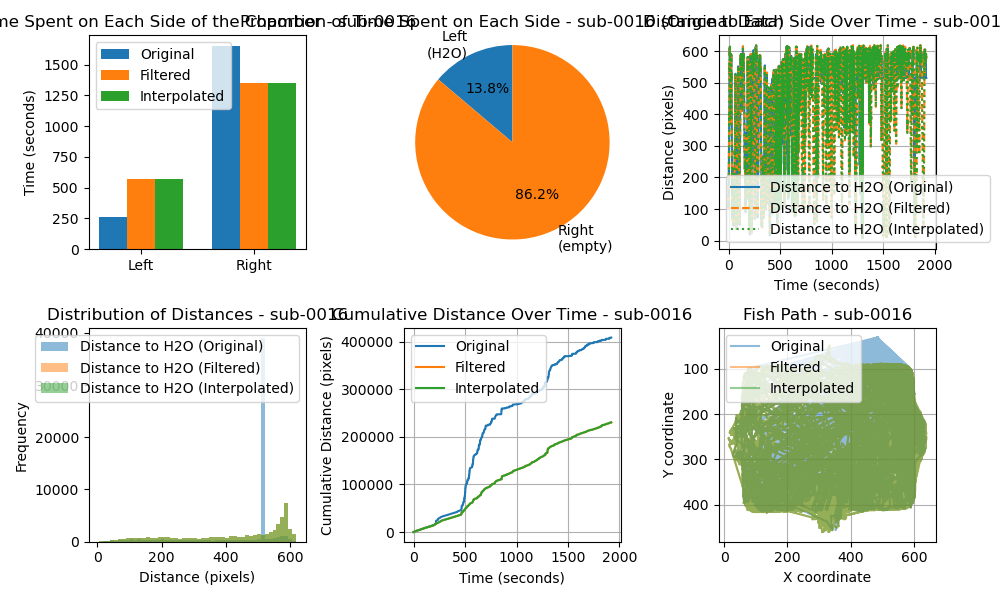

In [100]:
import h5py
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from ipywidgets import interact, interactive, fixed, widgets, HBox, VBox
from IPython.display import display
from pathlib import Path
import re

# Make sure to run '%matplotlib widget' in a cell before using this function

def expanded_interactive_chamber_analysis(original_file_path: Path, filtered_file_path: Path, interpolated_file_path: Path):
    """
    Create an expanded interactive plot for chamber analysis with toggleable datasets in a Jupyter notebook using IPython magic.
    Includes cumulative distance and path plots, with subject ID extracted from the filename and a custom save button.

    Args:
    original_file_path (Path): Path to the original h5 file containing fish tracking data and syringe information.
    filtered_file_path (Path): Path to the filtered h5 file.
    interpolated_file_path (Path): Path to the interpolated h5 file.
    """
    # Extract subject ID from filename
    match = re.search(r'sub-(\d+)', original_file_path.stem)
    if match:
        subject_id = f"sub-{match.group(1)}"
    else:
        subject_id = "Unknown_Subject"

    def process_data(center, label):
        df = pd.DataFrame(center, columns=['x', 'y'])
        df['side'] = np.where(df['x'] < midpoint, 'left', 'right')
        total_frames = len(df)
        left_frames = (df['side'] == 'left').sum()
        right_frames = (df['side'] == 'right').sum()
        fps = 30
        left_time = left_frames / fps
        right_time = right_frames / fps
        df['dist_left'] = np.sqrt(np.sum((center - left_point)**2, axis=1))
        df['dist_right'] = np.sqrt(np.sum((center - right_point)**2, axis=1))
        
        # Calculate cumulative distance
        df['step_distance'] = np.sqrt(np.sum(np.diff(center, axis=0, prepend=center[0:1])**2, axis=1))
        df['cumulative_distance'] = np.cumsum(df['step_distance'])
        
        return df, total_frames, left_frames, right_frames, left_time, right_time

    # Load and process data
    with h5py.File(original_file_path, 'r') as f:
        center_original = f['center'][:]
        left_syringe = f.attrs.get('left_syringe', 'Unknown')
        right_syringe = f.attrs.get('right_syringe', 'Unknown')
        chamber_coords = eval(f.attrs.get('points', '{}'))
        left_point = np.array(chamber_coords.get('Left', (0, 0)))
        right_point = np.array(chamber_coords.get('Right', (0, 0)))

    midpoint = (left_point[0] + right_point[0]) / 2

    with h5py.File(filtered_file_path, 'r') as f:
        center_filtered = f['center'][:]
    with h5py.File(interpolated_file_path, 'r') as f:
        center_interpolated = f['center'][:]

    df_original, total_frames, left_frames, right_frames, left_time, right_time = process_data(center_original, 'Original')
    df_filtered, _, _, _, left_time_filtered, right_time_filtered = process_data(center_filtered, 'Filtered')
    df_interpolated, _, _, _, left_time_interpolated, right_time_interpolated = process_data(center_interpolated, 'Interpolated')

    fig, ((ax1, ax2, ax3), (ax4, ax5, ax6)) = plt.subplots(2, 3, figsize=(10, 6))
    plt.subplots_adjust(left=0.1, bottom=0.1, right=0.9, top=0.9, wspace=0.3, hspace=0.3)

    def update_plot(show_original, show_filtered, show_interpolated):
        ax1.clear()
        ax3.clear()
        ax4.clear()
        ax5.clear()
        ax6.clear()

        # Bar plot
        bar_width = 0.25
        index = np.arange(2)
        if show_original:
            ax1.bar(index - bar_width, [left_time, right_time], bar_width, label='Original')
        if show_filtered:
            ax1.bar(index, [left_time_filtered, right_time_filtered], bar_width, label='Filtered')
        if show_interpolated:
            ax1.bar(index + bar_width, [left_time_interpolated, right_time_interpolated], bar_width, label='Interpolated')
        ax1.set_ylabel('Time (seconds)')
        ax1.set_title(f'Time Spent on Each Side of the Chamber - {subject_id}')
        ax1.set_xticks(index)
        ax1.set_xticklabels(['Left', 'Right'])
        ax1.legend()

        # Pie chart (using original data)
        ax2.clear()
        sizes = [left_frames, right_frames]
        labels = [f'Left\n({left_syringe})', f'Right\n({right_syringe})']
        ax2.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90)
        ax2.axis('equal')
        ax2.set_title(f'Proportion of Time Spent on Each Side - {subject_id} (Original Data)')

        # Distance plots
        time_axis = np.arange(total_frames) / 30
        for content, side in zip([left_syringe, right_syringe], ['left', 'right']):
            if content not in ['Unknown', 'empty']:
                if show_original:
                    ax3.plot(time_axis, df_original[f'dist_{side}'], label=f'Distance to {content} (Original)')
                if show_filtered:
                    ax3.plot(time_axis, df_filtered[f'dist_{side}'], label=f'Distance to {content} (Filtered)', linestyle='--')
                if show_interpolated:
                    ax3.plot(time_axis, df_interpolated[f'dist_{side}'], label=f'Distance to {content} (Interpolated)', linestyle=':')
        ax3.set_xlabel('Time (seconds)')
        ax3.set_ylabel('Distance (pixels)')
        ax3.set_title(f'Distance to Each Side Over Time - {subject_id}')
        ax3.legend()
        ax3.grid(True)

        # Histogram of distances
        for content, side in zip([left_syringe, right_syringe], ['left', 'right']):
            if content not in ['Unknown', 'empty']:
                if show_original:
                    ax4.hist(df_original[f'dist_{side}'], bins=50, alpha=0.5, label=f'Distance to {content} (Original)')
                if show_filtered:
                    ax4.hist(df_filtered[f'dist_{side}'], bins=50, alpha=0.5, label=f'Distance to {content} (Filtered)')
                if show_interpolated:
                    ax4.hist(df_interpolated[f'dist_{side}'], bins=50, alpha=0.5, label=f'Distance to {content} (Interpolated)')
        ax4.set_xlabel('Distance (pixels)')
        ax4.set_ylabel('Frequency')
        ax4.set_title(f'Distribution of Distances - {subject_id}')
        ax4.legend()

        # Cumulative distance plot
        if show_original:
            ax5.plot(time_axis, df_original['cumulative_distance'], label='Original')
        if show_filtered:
            ax5.plot(time_axis, df_filtered['cumulative_distance'], label='Filtered')
        if show_interpolated:
            ax5.plot(time_axis, df_interpolated['cumulative_distance'], label='Interpolated')
        ax5.set_xlabel('Time (seconds)')
        ax5.set_ylabel('Cumulative Distance (pixels)')
        ax5.set_title(f'Cumulative Distance Over Time - {subject_id}')
        ax5.legend()
        ax5.grid(True)

        # Path plot
        if show_original:
            ax6.plot(df_original['x'], df_original['y'], label='Original', alpha=0.5)
        if show_filtered:
            ax6.plot(df_filtered['x'], df_filtered['y'], label='Filtered', alpha=0.5)
        if show_interpolated:
            ax6.plot(df_interpolated['x'], df_interpolated['y'], label='Interpolated', alpha=0.5)
        ax6.set_xlabel('X coordinate')
        ax6.set_ylabel('Y coordinate')
        ax6.set_title(f'Fish Path - {subject_id}')
        ax6.legend()
        ax6.grid(True)
        ax6.invert_yaxis()  # Invert y-axis to match image coordinates

        fig.canvas.draw_idle()

    def save_figure(b):
        save_path = original_file_path.parent / f"{subject_id}_chamber_analysis.png"
        fig.savefig(save_path, dpi=300, bbox_inches='tight')
        print(f"Figure saved as {save_path}")

    # Create interactive widgets
    show_original = widgets.Checkbox(value=True, description='Show Original')
    show_filtered = widgets.Checkbox(value=True, description='Show Filtered')
    show_interpolated = widgets.Checkbox(value=True, description='Show Interpolated')
    
    save_button = widgets.Button(description="Save Figure")
    save_button.on_click(save_figure)

    # Layout widgets
    widgets_box = VBox([HBox([show_original, show_filtered, show_interpolated]), save_button])
    
    # Display widgets and connect to update function
    display(widgets_box)
    
    def update_wrapper(show_orig, show_filt, show_interp):
        update_plot(show_orig, show_filt, show_interp)
    
    out = interactive(update_wrapper, 
                      show_orig=show_original, 
                      show_filt=show_filtered, 
                      show_interp=show_interpolated)
    
    display(out)

    plt.tight_layout()
    plt.show()

    return df_original, df_filtered, df_interpolated

# Example usage
if __name__ == "__main__":
    o = "/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0016/20240722_sub-0016_OnePortEtohExperiment/20240722_sub-0016_OnePortEtohExperiment_output.h5"
    f = "/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0016/20240722_sub-0016_OnePortEtohExperiment/20240722_sub-0016_OnePortEtohExperiment_output_corrected_filtered.h5"
    i = "/home/jmdelahanty/OneDrive/lgfl/rawdata/sub-0016/20240722_sub-0016_OnePortEtohExperiment/20240722_sub-0016_OnePortEtohExperiment_output_corrected_filtered_interpolated.h5"
    original = Path(o)
    filtered = Path(f)
    interpolated = Path(i)
    expanded_interactive_chamber_analysis(original, filtered, interpolated)